# GLMS -- SingleRFs 

In [1]:
import sys
import os
import h5py 

# setup paths
iteration = 1 # which version of this tutorial to run (in case want results in different dirs)
NBname = 'color_cloud_initial{}'.format(iteration)

try:
    myhost = os.uname()[1] # get name of machine
    print("Running on Computer: [%s]" %myhost)
except:
    myhost = os.environ['COMPUTERNAME'] # for Windows machines, i.e. PNI
    print("Running on Computer: [%s]" %myhost)

# Add path to the list of paths to search for modules
if myhost=='it':
    sys.path.insert(0, '/home/felixbartsch/Code/') 
    datadir = '/home/felixbartsch/Data/Conway/'
    dirname = '/home/felixbartsch/Data/Colorworkspace/' # Working directory 
elif myhost=='PNI-GM0TX8ZY':
    sys.path.insert(0, 'C:\\Users\\fb7792\\Dropbox\\LibFel\\Git\\') 
    datadir = r'C:\\Users\\fb7792\\Data\\conway\\'
    dirname = r'C:\\Users\\fb7792\\Data\\conway\\Colorworkspace\\' # Working directory
else:
    sys.path.insert(0, '/home/conwaylab/Git/') 
    datadir = '/home/conwaylab/Data/'  
    dirname = '/home/conwaylab/Analysis/Colorworkspace/' # Working directory 

import numpy as np
import scipy.io as sio
from copy import deepcopy

# plotting
import matplotlib.pyplot as plt

# Import torch
import torch
from torch import nn

# NDN tools
import NDNT.utils as utils # some other utilities
from NDNT.utils import imagesc   # because I'm lazy
from NDNT.utils import ss        # because I'm real lazy
import NDNT.NDN as NDN
from NDNT.modules.layers import *
from NDNT.networks import *
from time import time
import dill
import ColorDataUtils.ConwayUtils as CU
import ColorDataUtils.RFutils as RU
#from ColorDataUtils.multidata_utils import MultiExperiment

from NTdatasets.generic import GenericDataset
import NTdatasets.conway.cloud_datasets as datasets
import NTdatasets.conway.bar1d_datasets as bardatasets

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device0 = torch.device("cpu")
dtype = torch.float32

# Where saved models and checkpoints go -- this is to be automated
print( 'Save_dir =', dirname)

%load_ext autoreload
%autoreload 2

Running on Computer: [PNI-GM0TX8ZY]
Invoking __init__.py for NDNT.utils
Save_dir = C:\\Users\\fb7792\\Data\\conway\\Colorworkspace\\


In [2]:
fndate= '241203' #this should be the date of the recording in YYMMDD, used for our naming conventions
monkeyID = 'J' # J for Jocamo, V for Vincent, S for Sprout

#local data structs
dirname2 = dirname+fndate+'/'
dirname_mod = dirname+fndate+'/models/'

#data directory structs
PROOT = monkeyID+fndate 
fn = PROOT+'_CC_CC' # '_CC_CC' for Color Cloud data, replace this with '_MkTurk' if doing task analysis
fn0 = fn+'_v09' #current version of this code

datadir2 = datadir+'proc/'+PROOT+'/'
analdir = datadir+'analysis/'+PROOT+'/'
moddir = datadir+'models/'+PROOT+'/'

In [3]:
# Load BINOCULAR only (single RFs)
# Load data

num_lags = 10
UNX = 56

inclMUs = True
t0 = time()
data = datasets.ColorClouds(
    filenames=[fn0], eye_config=3, drift_interval=16,
    datadir=datadir2, folded_lags=False, luminance_only=False,
    num_lags=num_lags, block_sample=True, include_MUs=inclMUs)
t1 = time()
print(t1-t0, 'sec elapsed')

lam_units = np.where(data.channel_map < 32)[0]
ETunits = np.where(data.channel_map > 32)[0]
UTunits = np.where(data.channel_map >= 32+127)[0]
NFunits = np.where((data.channel_map > 32) & (data.channel_map < (32+128)))[0]
print( "%d laminar units, %d ET units"%(len(lam_units), len(ETunits)))

# Pull correct saccades
matdat = sio.loadmat( datadir2+fn+'_ETupdate.mat')
data.process_fixations(matdat['sac_binsB'][0, :])

NT = len(data.fix_n)
NA = data.Xdrift.shape[1]
print("%d (%d valid) time points"%(NT, len(data)))

# # Replace DFs
matdat = sio.loadmat(datadir2+fn+'_DFupdate.mat')
data.dfs = torch.tensor( matdat['XDF'][:NT, :], dtype=torch.float32 )
data.dfs.shape

#shift robs to test weird NLRF alignment
#data.robs=torch.from_numpy(np.roll(data.robs,shift=8,axis=0))

Loading data into memory...
No ETstimulus data found
Adjusting stimulus read from disk: mean | std = -0.000 | 0.259
int64 (388602,) 414960
T-range: 0 414960
278.0634331703186 sec elapsed
19 laminar units, 29 ET units
  Redoing fix_n with saccade inputs: 12927 saccades
414960 (414960 valid) time points


torch.Size([414960, 48])

In [ ]:
# load the best shifts from neurophysiological eyetracker
SHfile = sio.loadmat(datadir2 +fn+'_shifts_best.mat')
#SHfile = sio.loadmat(dirname2 + 'BDshifts0628i3.mat')
fix_n  = SHfile['fix_n']
fixshifts = SHfile['shifts']
metricsLL = SHfile['metricsLL']
metricsTH = SHfile['metricsTH']
ETshifts  = SHfile['ETshifts']
ETmetrics = SHfile['ETmetrics']

## only use most confident fixations
goodfix = np.where(ETmetrics[:,1] < 0.9) # set threshold for confidence in our estimate
valfix = torch.zeros([ETmetrics.shape[0], 1], dtype=torch.float32)
valfix[goodfix] = 1.0
# Test base-level performance (full DFs and then modify DFs)
data.dfs=np.multiply(data.dfs,valfix)

In [4]:
# Segregate 'valid' Utah units
Reff = torch.mul(data.robs[:, UTunits], data.dfs[:, UTunits]).numpy()
nspks = np.sum(Reff, axis=0)
a = np.where(nspks > 10)[0]
valUT = UTunits[a]
NCUT = len(valUT)

Reff = torch.mul(data.robs[:, NFunits], data.dfs[:, NFunits]).numpy()
nspks = np.sum(Reff, axis=0)
a = np.where(nspks > 10)[0]
valNF = NFunits[a]
NCNF = len(valNF)

Reff = torch.mul(data.robs[:, lam_units], data.dfs[:, lam_units]).numpy()
nspks = np.sum(Reff, axis=0)
a = np.where(nspks > 10)[0]
valLP = lam_units[a]
NCL = len(valLP)
NCv = len(valLP)

print( "%d out of %d Laminar units kept"%(NCL, len(lam_units)) )
print( "%d out of %d NF units kept"%(NCNF, len(NFunits)) )
print( "%d out of %d Utah units kept"%(NCUT, len(UTunits)) )

12 out of 19 Laminar units kept
12 out of 29 NF units kept
0 out of 0 Utah units kept


In [5]:
Reff = torch.mul(data.robs[:, lam_units], data.dfs[:, lam_units]).numpy()
nspks = np.sum(Reff, axis=0)
nspks

array([204980.,      0.,  66725.,  43031., 560034., 172617., 214340.,
       126496.,  75361., 134797., 175822.,      0.,      0.,      0.,
            0.,  12832.,      0.,      0.,   2778.], dtype=float32)

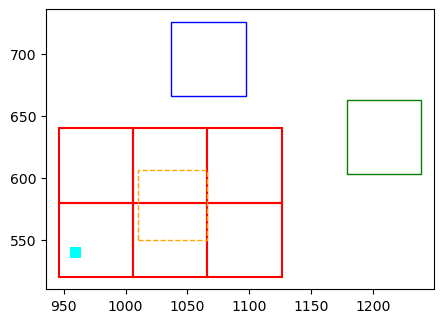

In [22]:
# load top_corner locations for GQM fits

#Ready:


# New GQM fits (fit with ~45pix, some may need refitting)
#top_corner = np.array([980, 540], dtype=np.int64) #for 0801 - ET done
#top_corner = np.array([975, 545], dtype=np.int64) #for 0808 - ET done

#start at prod3:

#start at prod2:

#start at prod1:

#TODO:
#have ET clouds:
# 0729
# 0909
top_corner = np.array([1010, 550], dtype=np.int64) #for J241203

#have 1Dbars
#for 0207
#for 0217
#for 0304
#top_corner = np.array([966, 535], dtype=np.int64) #for 0314
#for 0316
#for 0318
#top_corner = np.array([966, 530], dtype=np.int64) #for 0320 - LP meas done
#for 0321
#for 0616
#top_corner = np.array([955, 525], dtype=np.int64) #for 0621 -LP meas done (1D ET)

# DONE:
# New GQM fits (50+ pix)
#top_corner = np.array([950, 530], dtype=np.int64) #for 0628 - ET done; GQMs done formerly [951, 530]
#top_corner = np.array([945, 520], dtype=np.int64) #for 0701 - ET done; GQMs done
#top_corner = np.array([960, 525], dtype=np.int64) #for 0705 - ET done; GQMs done
#top_corner = np.array([955, 530], dtype=np.int64) #for 0707 - ET done; GQMs done
#top_corner = np.array([945, 515], dtype=np.int64) #for 0711 - ET done; GQMs done
#top_corner = np.array([950, 530], dtype=np.int64) #for 0713 - ET done; GQMs done
#top_corner = np.array([945, 520], dtype=np.int64) #for 0715 - ET done; GQMs done on all arrays
#top_corner = np.array([940, 520], dtype=np.int64) #for 0718 - ET done; GQMs redone
#top_corner = np.array([985, 535], dtype=np.int64) #for 0720 - ET done; GQMs done
#top_corner = np.array([995, 545], dtype=np.int64) #for 0725 - ET done; GQMs done
#top_corner = np.array([990, 545], dtype=np.int64) #for 0727 - ET done; GQMs redone
#top_corner = np.array([980, 555], dtype=np.int64) #for 0803 - ET done; GQMs done
#top_corner = np.array([970, 540], dtype=np.int64) #for 0805 - ET initial fits done, may need second look
#top_corner = np.array([960, 525], dtype=np.int64) #for 0921 - ET done; GQMs done
#top_corner = np.array([1010, 535], dtype=np.int64) #for 0926 - ET done
#top_corner = np.array([995, 520], dtype=np.int64) #for 1003
#top_corner = np.array([1010, 535], dtype=np.int64) #for 1007 - ET done; GQMs done

#top_corner = np.array([985, 535], dtype=np.int64) #for 0722 - ET done, GQMs done with 56 pix


data.draw_stim_locations(top_corner = top_corner, L=UNX)

In [23]:
#data.assemble_stimulus(top_corner=top_corner, fixdot=0, L=UNX, shifts=-fixshifts)
data.assemble_stimulus(top_corner=top_corner, fixdot=0, L=UNX)

  Adding fixation point
  Done


In [29]:
data.stim[0:20, 0:10]

tensor([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]])

In [24]:
# LP STAs
Reff = torch.mul(data.robs[:, valLP], data.dfs[:, valLP])
nspks = torch.sum(Reff, axis=0)

lag = 4
stas0 = ((data.stim[:-lag, ...].T @ Reff[lag:,:]).squeeze() / nspks).reshape([3,UNX,UNX,-1]).numpy()

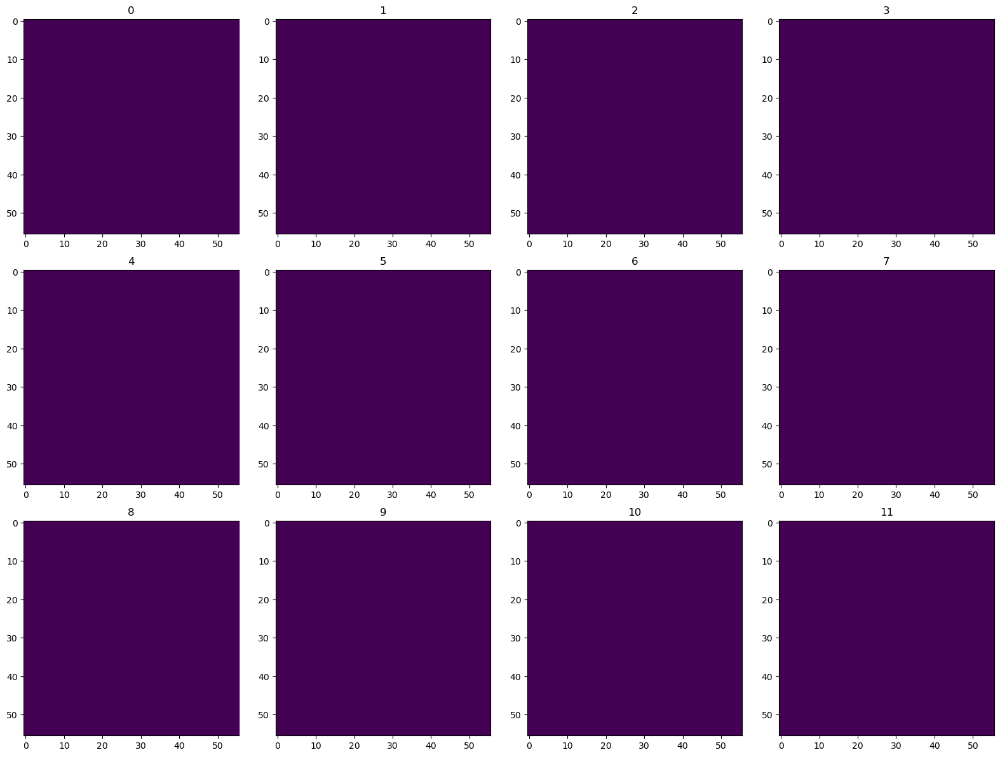

In [25]:
Nrows=int(np.ceil(NCv/4))
ss(Nrows,4)
for cc in range(NCv):
    plt.subplot(Nrows,4, cc+1)
    imagesc(stas0[0,:,:, cc])
    plt.title(str(cc))
plt.show()

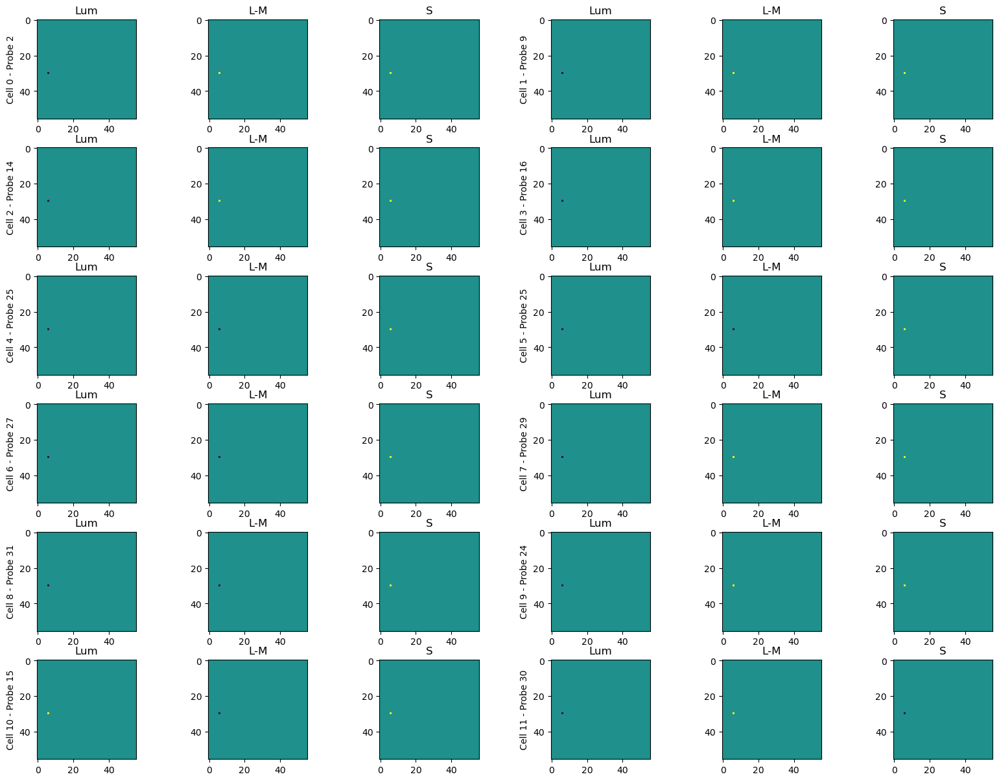

In [21]:
ctext = ['Lum', 'L-M', 'S']
Nrows=int(np.ceil(NCv/2))
ss(Nrows, 6, rh=2)
for cc in range(NCv):
    for clr in range(3):
        plt.subplot(Nrows, 6, 3*cc+clr+1)
        imagesc(stas0[clr, :, :, cc])
        if clr == 0:
            plt.ylabel( "Cell %d - Probe %d"%(cc, data.channel_map[valLP[cc]]))
        plt.title(ctext[clr])

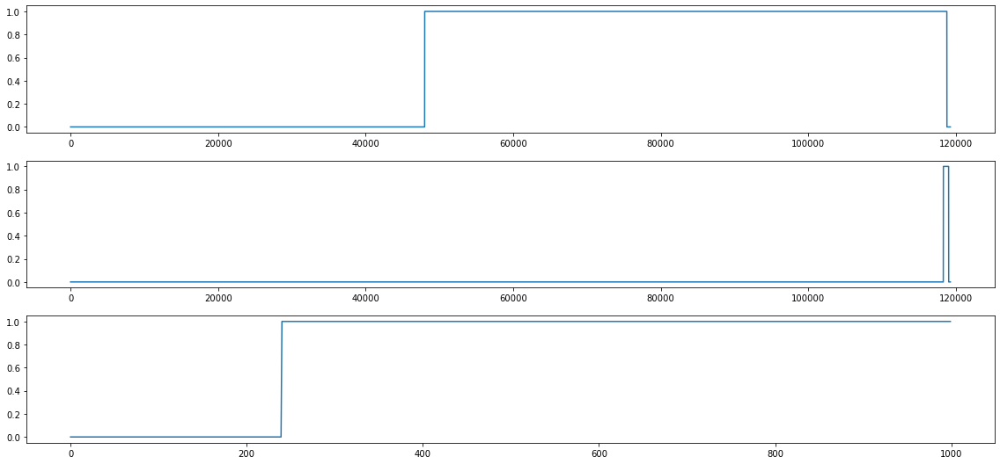

In [18]:
ss(3,1)
plt.subplot(311)
plt.plot(data.dfs[:,0])
plt.subplot(312)
plt.plot(data.dfs[:,1])
plt.subplot(313)
plt.plot(data.dfs[:1000,2])
plt.show()

## GLMs

In [13]:
NCv = len(valLP)
shifts = np.array([[0,0], [0, 0], [0, 0]]) # if not caring about non-LP things
NXglm = UNX

LLs0, LLsGLM, XTopt, GLopt = np.zeros([NCv,2]), np.zeros(NCv), np.zeros(NCv), np.zeros(NCv)
glms = [None]*NCv
driftmods = [None]*NCv
Dreg = 0.1

lbfgs_pars = utils.create_optimizer_params(
    optimizer_type='lbfgs',
    tolerance_change=1e-10,
    tolerance_grad=1e-10,
    batch_size=16000, #16000
    max_epochs=3,
    max_iter = 100) #100
#lbfgs_pars['num_workers'] = 0

In [14]:
#set up fits
Xreg = 10 # [20]
Treg = 1 # [20]
L1reg = 1 # [0.5]
GLreg = 10.0 # [4.0]

# drift network
drift_pars1 = NDNLayer.layer_dict( 
    input_dims=[1,1,1,NA], num_filters=1, bias=False, norm_type=0, NLtype='lin')
drift_pars1['reg_vals'] = {'d2t': Dreg, 'bcs':{'d2t':0} } 
# for stand-alone drift model
drift_pars1N = deepcopy(drift_pars1)
drift_pars1N['NLtype'] = 'softplus'
drift_net =  FFnetwork.ffnet_dict( xstim_n = 'Xdrift', layer_list = [drift_pars1] )

# glm net
glm_layer = Tlayer.layer_dict( 
    input_dims=[3,NXglm,NXglm,1], num_filters=1, bias=False, num_lags=num_lags,
    NLtype='lin', initialize_center = True)
glm_layer['reg_vals'] = {'d2x': Xreg, 'd2t': Treg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':10} 
stim_net =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [glm_layer] )

# abs layer
glm2_layer = OnOffLayer.layer_dict( 
    input_dims=[3,NXglm,NXglm,1], num_filters=1, bias=False, num_lags=num_lags,
    NLtype='lin', initialize_center = True)
stim_net2 =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [glm2_layer] )

# gqm net
num_subs = 2
gqm_layer = Tlayer.layer_dict( 
    input_dims=[3,NXglm,NXglm,1], num_filters=num_subs, num_inh=0, bias=False, num_lags=num_lags,
    NLtype='square', initialize_center = True)
gqm_layer['reg_vals'] = {'d2x': Xreg, 'd2t': Treg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':10} 
stim_qnet =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [gqm_layer] )

#combine glm
comb_layer = NDNLayer.layer_dict(
    num_filters = 1, NLtype='softplus', bias=False)
comb_layer['weights_initializer'] = 'ones'

net_comb = FFnetwork.ffnet_dict( 
    xstim_n = None, ffnet_n=[0,1],
    layer_list = [comb_layer], ffnet_type='add')

#combine gqm
comb2_layer = ChannelLayer.layer_dict( 
    num_filters = 1, NLtype='softplus', bias=False)
comb2_layer['weights_initializer'] = 'ones'

net2_comb = FFnetwork.ffnet_dict( 
    xstim_n = None, ffnet_n=[0,1,2],
    layer_list = [comb2_layer], ffnet_type='normal')
net2_comb['layer_list'][0]['bias'] = True

glms = [None]*NCv
glms_abs = [None]*NCv
gqms = [None]*NCv
driftmods = [None]*NCv
XTopt = np.zeros(NCv) 
GLopt = np.zeros(NCv) 
LLsNULL = np.zeros(NCv)
LLsR = np.zeros([NCv,4])+1000
LL_abs = np.zeros(NCv)
LLsQR = np.zeros([NCv,5])+1000

rvals = [0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000]
rvalsG = [0, 0.001, 0.01, 1, 10, 100, 1000] # glocal

# set up stimulus
data.assemble_stimulus(top_corner=top_corner, fixdot=0, L=NXglm, time_embed=0, num_lags=num_lags, shifts=-fixshifts )
    
# for fit model with abs values as well
#new_stim = torch.zeros([NT, 2, 3*UNX*UNX])
#new_stim[:,0,:] = deepcopy(data.stim)
#new_stim[:,1,:] = deepcopy(abs(data.stim))
#data.add_covariate('stim2', new_stim.reshape([NT, -1]))

  Stim expansion for shift: [920, 500, 1016, 596]
  Writing lam stim 0: overlap 44, 35
  Writing lam stim 1: overlap 44, 60
  Writing lam stim 2: overlap 52, 60
  Writing lam stim 3: overlap 52, 35
  Adding fixation point
  Shifting stim...
  CROP: New stim size: 56 x 56
  Done


Output set to 1 cells
Cell   0:  d2x -R7   LLs = -0.001519918441772461
Cell   0:  d2t -R7   LL =-0.00152 -> 0.00257
Cell   0:  Gloc-R4   LL =-0.00152 -> 0.00257
Cell   0:  L1  -R3   LL =-0.00152 -> 0.00257


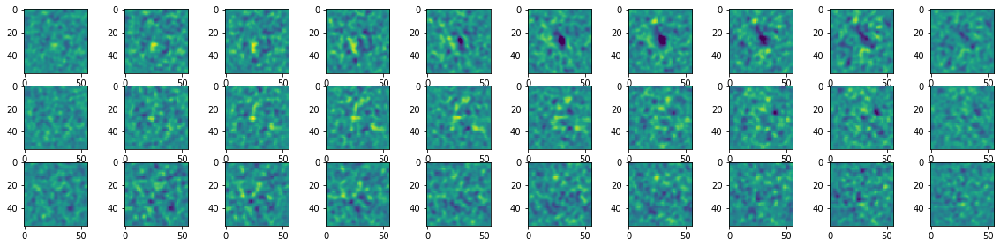

134.1328809261322 sec elapsed fitting GLM
Cell   0:  glm+abs   LL =-0.00152 -> 0.00458


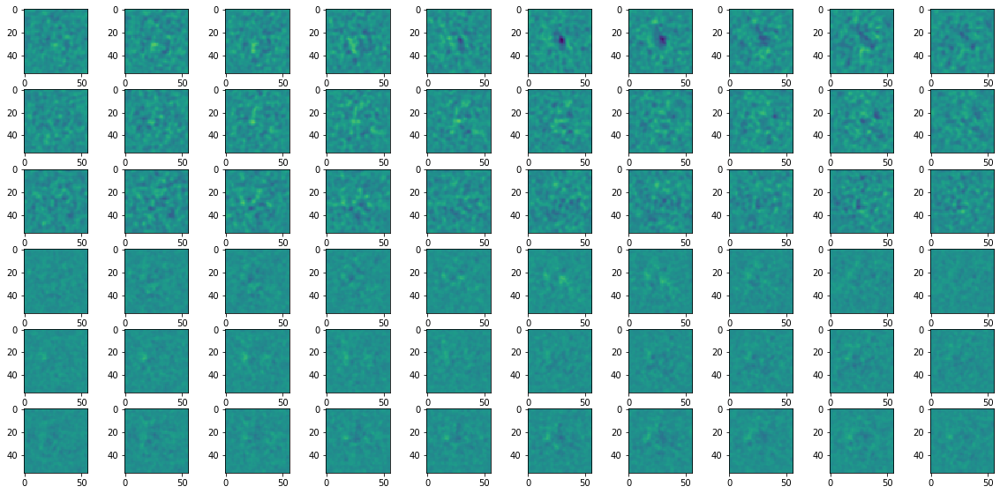

Cell   0:  fitting: 23.31168
Cell   0:  fitting: 21.63720
Cell   0:  fitting: 21.64478
Cell   0:  fitting: 21.69854
Cell   0:  fitting: 21.58432
Cell   0:  fitting: 21.65753
Cell   0:  fitting: 21.61725
Cell   0:  fitting: 21.66194
[2.97287464 2.97618484 2.97620487 2.97597027 2.97617602 2.9761188
 2.97501421 2.96980262]
Cell   0:  d2x -R7   LL = 0.00257 ->-0.01028
[2.97034073 2.97033405 2.97033453 2.97033858 2.97029448 2.96937609
 2.96604586 2.95726943]
Cell   0:  d2t -R7   LL = 0.00257 -> 0.00225
[3.4911747  3.48002362 3.39495778 2.98898888 2.95726299 2.95649052
 2.95714593]
Cell   0:  Gloc-R5   LL = 0.00257 -> 0.00303
[2.95656538 2.9565661  2.95656466 2.95649147 2.95728803 2.95659208
 2.9581356  2.95826697]
Cell   0:  L1  -R3   LL = 0.00257 -> 0.00303


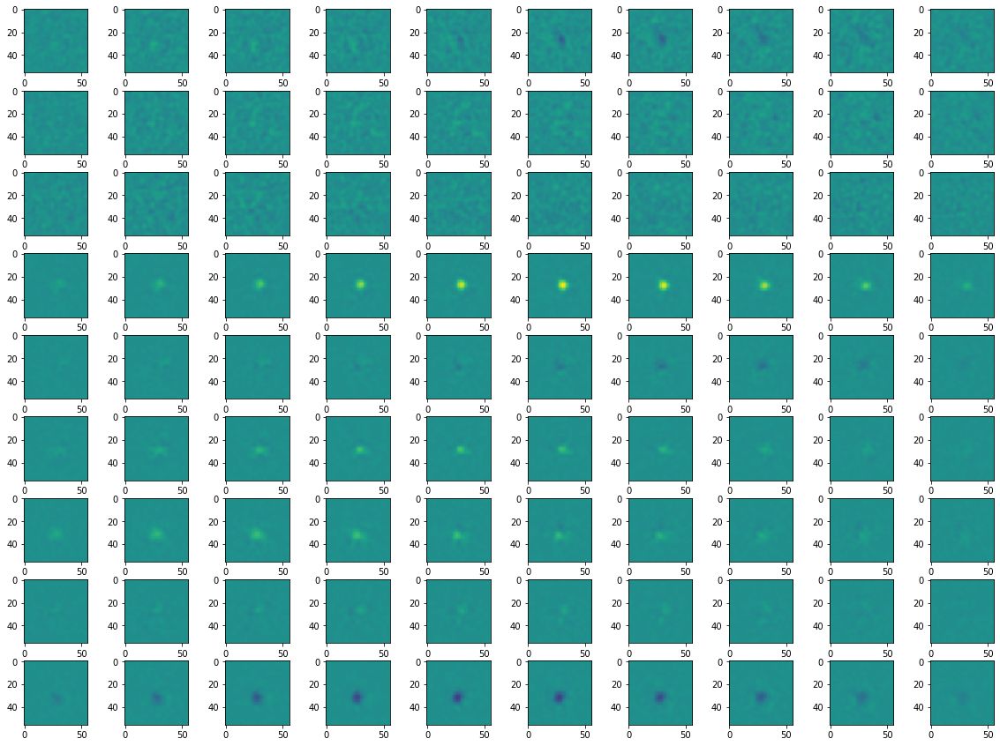

610.3179376125336 sec elapsed fitting GQM
744.4508185386658 sec elapsed fitting everything
Output set to 1 cells
Cell   1:  d2x -R6   LLs = 0.0021500587463378906
Cell   1:  d2t -R4   LL = 0.00215 -> 0.00215
Cell   1:  Gloc-R5   LL = 0.00215 -> 0.00217
Cell   1:  L1  -R0   LL = 0.00215 -> 0.00217


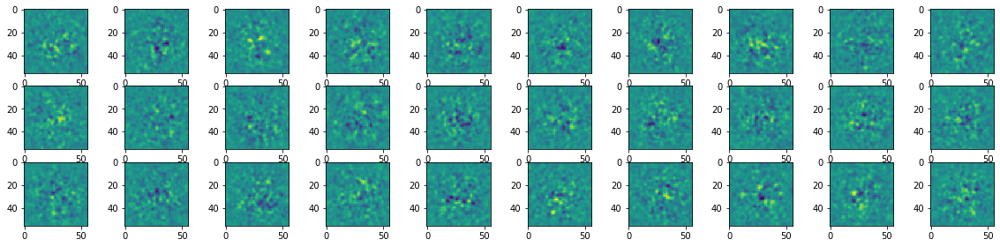

167.99571585655212 sec elapsed fitting GLM
Cell   1:  glm+abs   LL = 0.00215 -> 0.00256


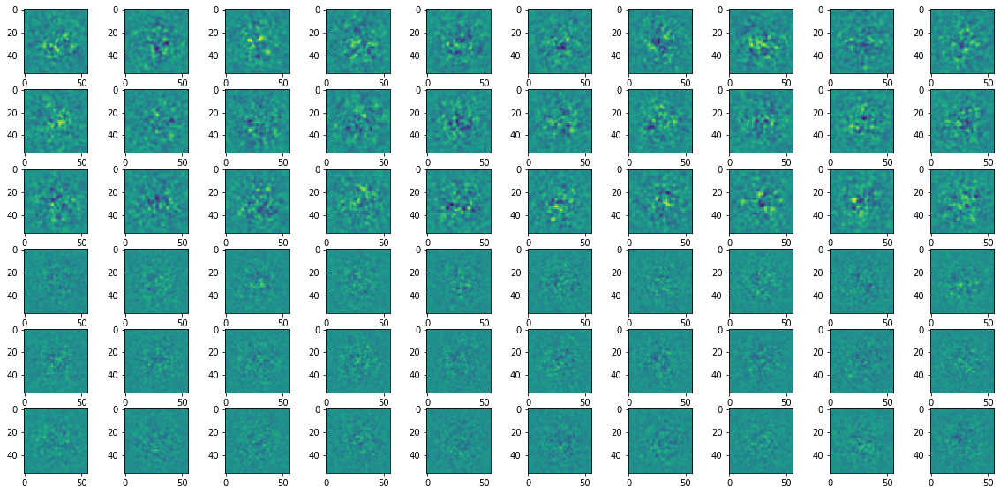

Cell   1:  fitting: 21.68162
Cell   1:  fitting: 21.64452
Cell   1:  fitting: 21.67942
Cell   1:  fitting: 21.61551
Cell   1:  fitting: 21.72258
Cell   1:  fitting: 21.64164
Cell   1:  fitting: 21.68046
Cell   1:  fitting: 21.62435
[4.25971842 4.25601196 4.25595379 4.25617599 4.25607634 4.25536489
 4.25606489 4.25414038]
Cell   1:  d2x -R7   LL = 0.00217 -> 0.00120
[4.25173712 4.2534709  4.25341463 4.25346422 4.25344276 4.25193071
 4.24707603 4.25191975]
Cell   1:  d2t -R6   LL = 0.00217 -> 0.00827
[5.57348156 5.50665474 5.17557669 4.27886534 4.24740934 4.25239801
 4.2516675 ]
Cell   1:  Gloc-R4   LL = 0.00217 -> 0.00793
[4.24777317 4.24818325 4.24814606 4.24740934 4.25170946 4.25165796
 4.25195217 4.25147009]
Cell   1:  L1  -R3   LL = 0.00217 -> 0.00793


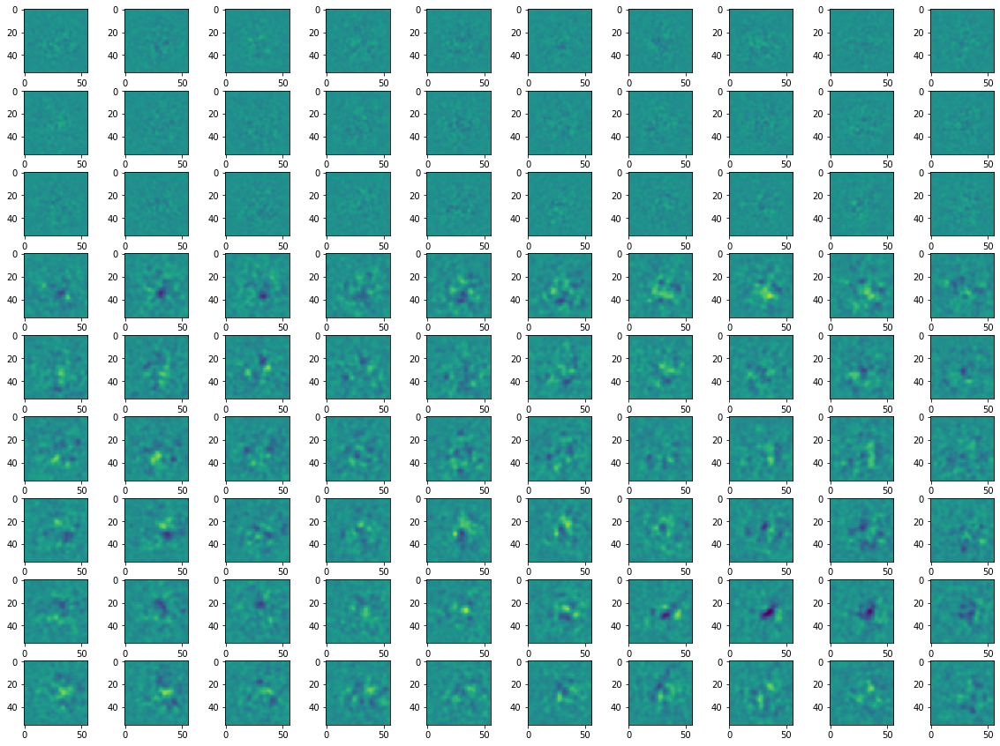

643.8777239322662 sec elapsed fitting GQM
811.8734397888184 sec elapsed fitting everything
Output set to 1 cells
Cell   2:  d2x -R7   LLs = 0.10455965995788574
Cell   2:  d2t -R6   LL = 0.10456 -> 0.10701
Cell   2:  Gloc-R3   LL = 0.10456 -> 0.11985
Cell   2:  L1  -R4   LL = 0.10456 -> 0.12575


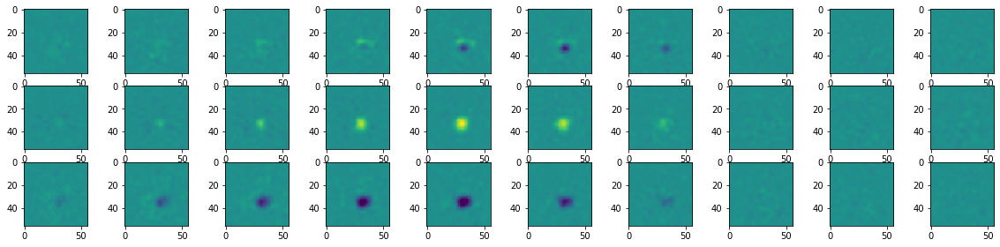

159.1965594291687 sec elapsed fitting GLM
Cell   2:  glm+abs   LL = 0.10456 -> 0.12540


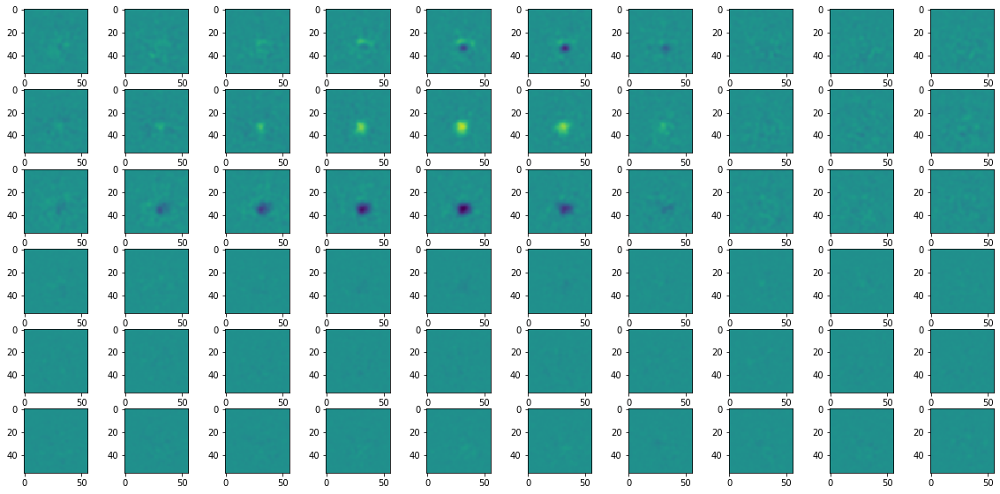

Cell   2:  fitting: 21.64117
Cell   2:  fitting: 21.69102
Cell   2:  fitting: 21.64595
Cell   2:  fitting: 21.71956
Cell   2:  fitting: 21.61819
Cell   2:  fitting: 21.67243
Cell   2:  fitting: 21.61853
Cell   2:  fitting: 21.67971
[2.60235405 2.60263228 2.60264874 2.60264111 2.60266018 2.60273433
 2.60252357 2.60140872]
Cell   2:  d2x -R7   LL = 0.11985 -> 0.12889
[2.60269475 2.60265613 2.60263586 2.60268688 2.60259914 2.60127926
 2.5986557  2.59727859]
Cell   2:  d2t -R7   LL = 0.11985 -> 0.13302
[2.91750693 2.91372371 2.88290071 2.63209057 2.59732747 2.59486938
 2.59497023]
Cell   2:  Gloc-R5   LL = 0.11985 -> 0.13543
[2.59492803 2.59492183 2.59492826 2.59492207 2.5952878  2.59477282
 2.59487033 2.59485054]
Cell   2:  L1  -R5   LL = 0.11985 -> 0.13553


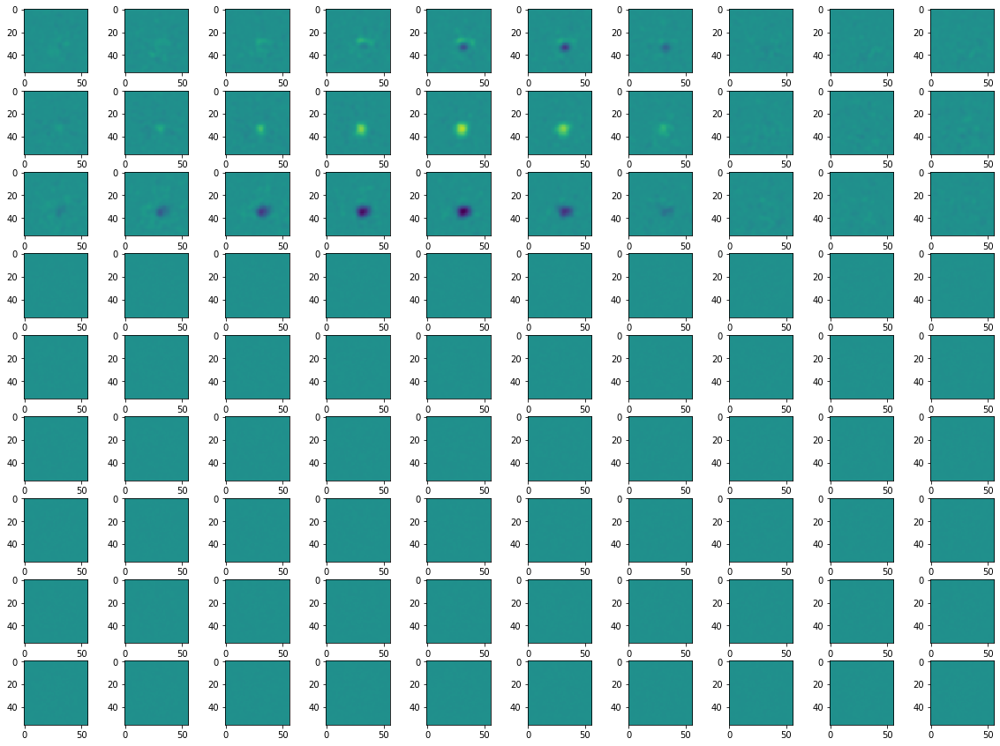

626.8847408294678 sec elapsed fitting GQM
786.0813002586365 sec elapsed fitting everything
Output set to 1 cells
Cell   3:  d2x -R2   LLs = -0.003457307815551758
Cell   3:  d2t -R6   LL =-0.00346 ->-0.00313
Cell   3:  Gloc-R6   LL =-0.00346 -> 0.00069
Cell   3:  L1  -R1   LL =-0.00346 -> 0.00071


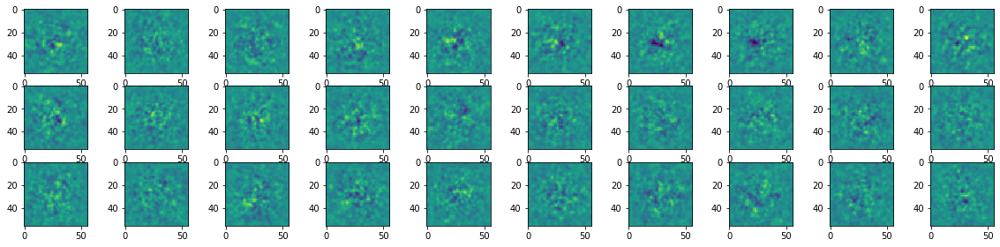

141.91772985458374 sec elapsed fitting GLM
Cell   3:  glm+abs   LL =-0.00346 -> 0.00169


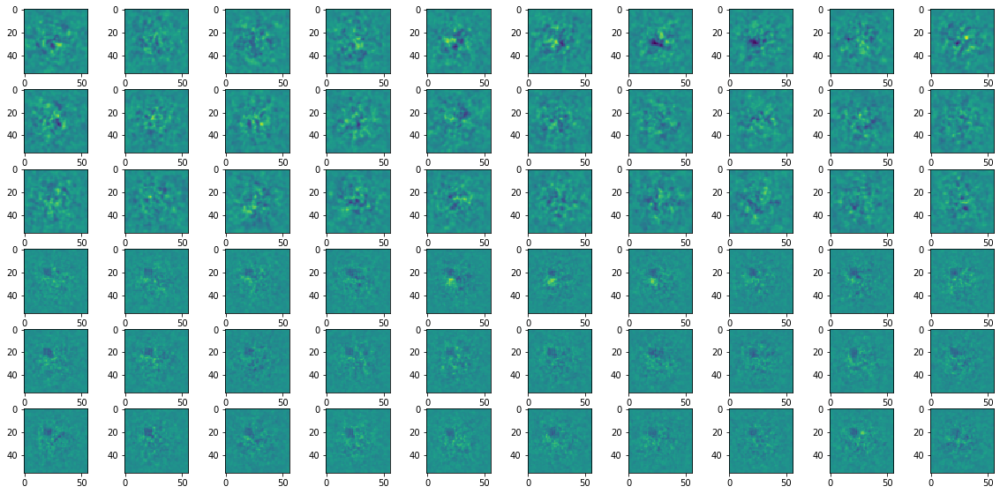

Cell   3:  fitting: 21.69064
Cell   3:  fitting: 21.61624
Cell   3:  fitting: 21.70586
Cell   3:  fitting: 21.68072
Cell   3:  fitting: 21.71335
Cell   3:  fitting: 21.65605
Cell   3:  fitting: 21.67350
Cell   3:  fitting: 21.64968
[3.58081603 3.57994771 3.57969737 3.57971239 3.57984352 3.57941508
 3.5765872  3.57664824]
Cell   3:  d2x -R6   LL = 0.00069 ->-0.00433
[3.58128619 3.58120584 3.58124352 3.58122516 3.58114052 3.5807817
 3.58149815 3.57132244]
Cell   3:  d2t -R7   LL = 0.00069 -> 0.00094
[5.68980646 5.53750849 4.86092663 3.62819195 3.57231331 3.57140541
 3.57143426]
Cell   3:  Gloc-R5   LL = 0.00069 -> 0.00086
[3.57255411 3.57213807 3.57258058 3.57231331 3.5709486  3.57159591
 3.57314873 3.57365298]
Cell   3:  L1  -R4   LL = 0.00069 -> 0.00131


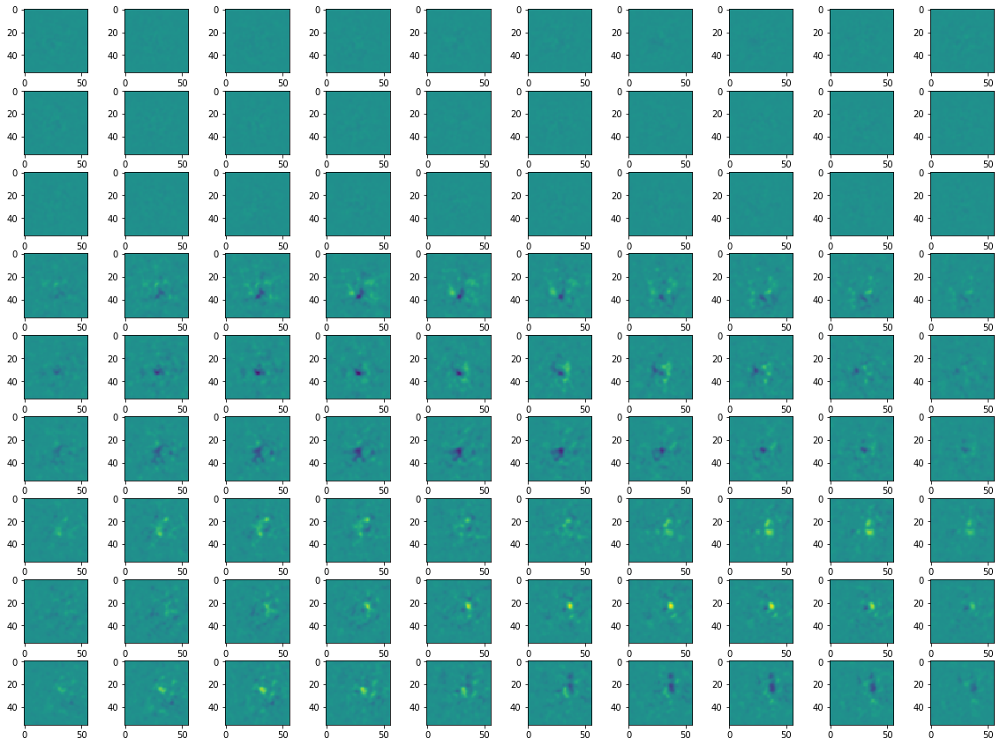

679.0093233585358 sec elapsed fitting GQM
820.9270532131195 sec elapsed fitting everything
Output set to 1 cells
Cell   4:  d2x -R3   LLs = -0.005174160003662109
Cell   4:  d2t -R7   LL =-0.00517 -> 0.00537
Cell   4:  Gloc-R4   LL =-0.00517 -> 0.00537
Cell   4:  L1  -R1   LL =-0.00517 -> 0.00620


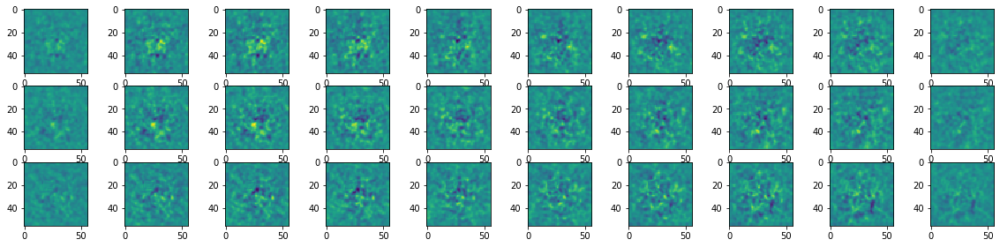

175.21284198760986 sec elapsed fitting GLM
Cell   4:  glm+abs   LL =-0.00517 -> 0.00081


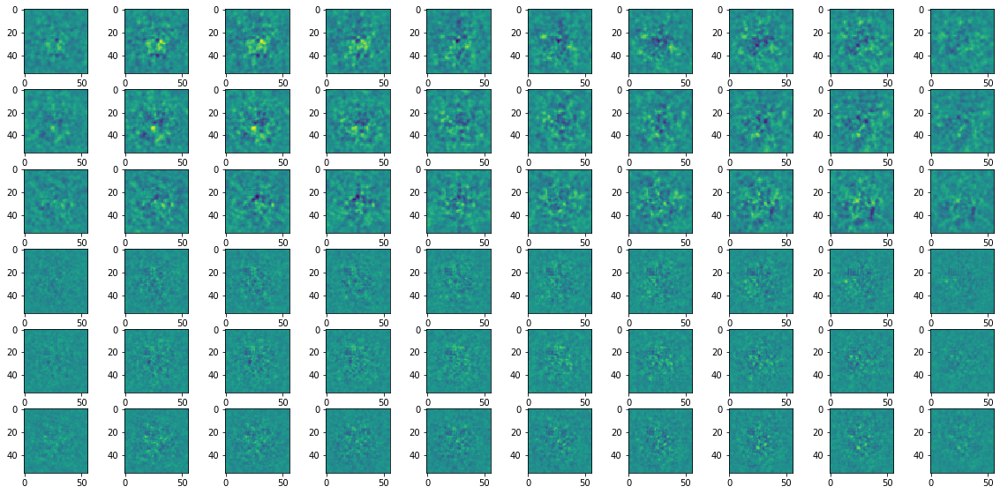

Cell   4:  fitting: 21.62770
Cell   4:  fitting: 21.66861
Cell   4:  fitting: 21.66268
Cell   4:  fitting: 21.71759
Cell   4:  fitting: 21.63099
Cell   4:  fitting: 21.67531
Cell   4:  fitting: 21.71632
Cell   4:  fitting: 21.71164
[4.58616877 4.59088564 4.59088039 4.59120083 4.59103394 4.58552313
 4.58464384 4.57274055]
Cell   4:  d2x -R7   LL = 0.00537 -> 0.00704
[4.58409882 4.58410358 4.58405447 4.58413315 4.58253098 4.57051039
 4.5705018  4.57233191]
Cell   4:  d2t -R6   LL = 0.00537 -> 0.00927
[6.27044821 6.10649157 5.74312925 4.64029551 4.5705409  4.57262754
 4.57291985]
Cell   4:  Gloc-R4   LL = 0.00537 -> 0.00924
[4.57256079 4.57111502 4.57259464 4.5705409  4.573277   4.57412148
 4.57542181 4.57558775]
Cell   4:  L1  -R3   LL = 0.00537 -> 0.00924


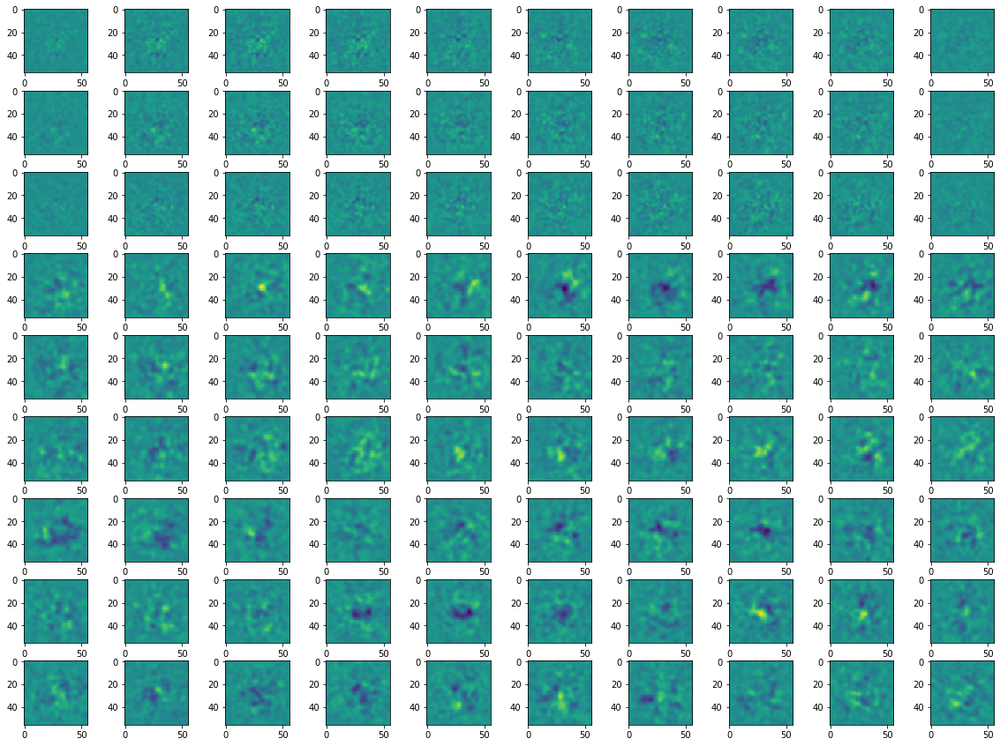

640.3913462162018 sec elapsed fitting GQM
815.6041882038116 sec elapsed fitting everything
Output set to 1 cells
Cell   5:  d2x -R6   LLs = 0.0050591230392456055
Cell   5:  d2t -R5   LL = 0.00506 -> 0.00506
Cell   5:  Gloc-R4   LL = 0.00506 -> 0.00506
Cell   5:  L1  -R4   LL = 0.00506 -> 0.00551


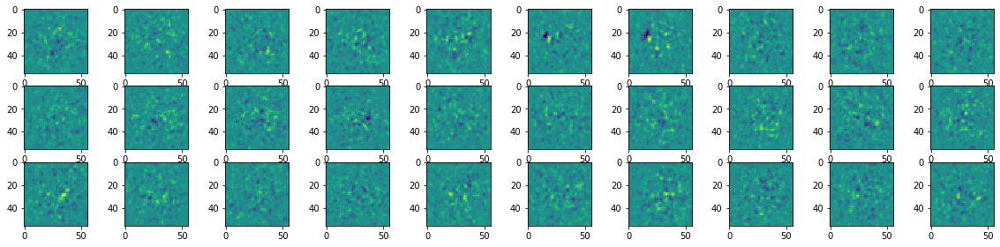

117.95488858222961 sec elapsed fitting GLM
Cell   5:  glm+abs   LL = 0.00506 -> 0.04163


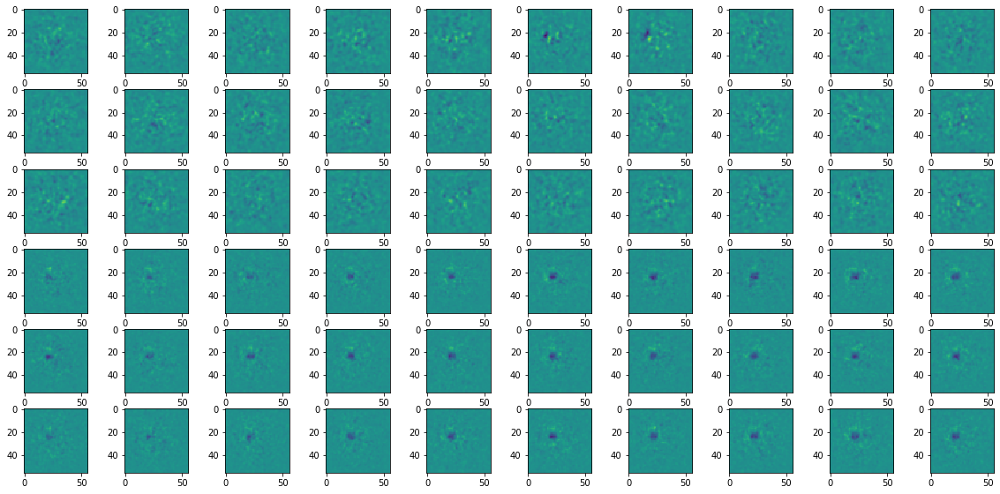

Cell   5:  fitting: 21.88697
Cell   5:  fitting: 21.66040
Cell   5:  fitting: 21.72975
Cell   5:  fitting: 21.60194
Cell   5:  fitting: 21.78188
Cell   5:  fitting: 21.62788
Cell   5:  fitting: 21.67806
Cell   5:  fitting: 21.62150
[1.89228904 1.89012063 1.89011693 1.89011729 1.89011419 1.89012218
 1.8899703  1.88915741]
Cell   5:  d2x -R7   LL = 0.00506 ->-0.00639
[1.88902056 1.88900578 1.88855958 1.88863182 1.88862598 1.88816631
 1.88733006 1.88462329]
Cell   5:  d2t -R7   LL = 0.00506 ->-0.00186
[2.22053337 2.21528411 2.17887735 1.92793632 1.88465488 1.87849534
 1.87846029]
Cell   5:  Gloc-R6   LL = 0.00506 -> 0.00430
[1.8784374  1.87837768 1.87821579 1.87827063 1.87829864 1.87833822
 1.87831771 1.87831247]
Cell   5:  L1  -R2   LL = 0.00506 -> 0.00455


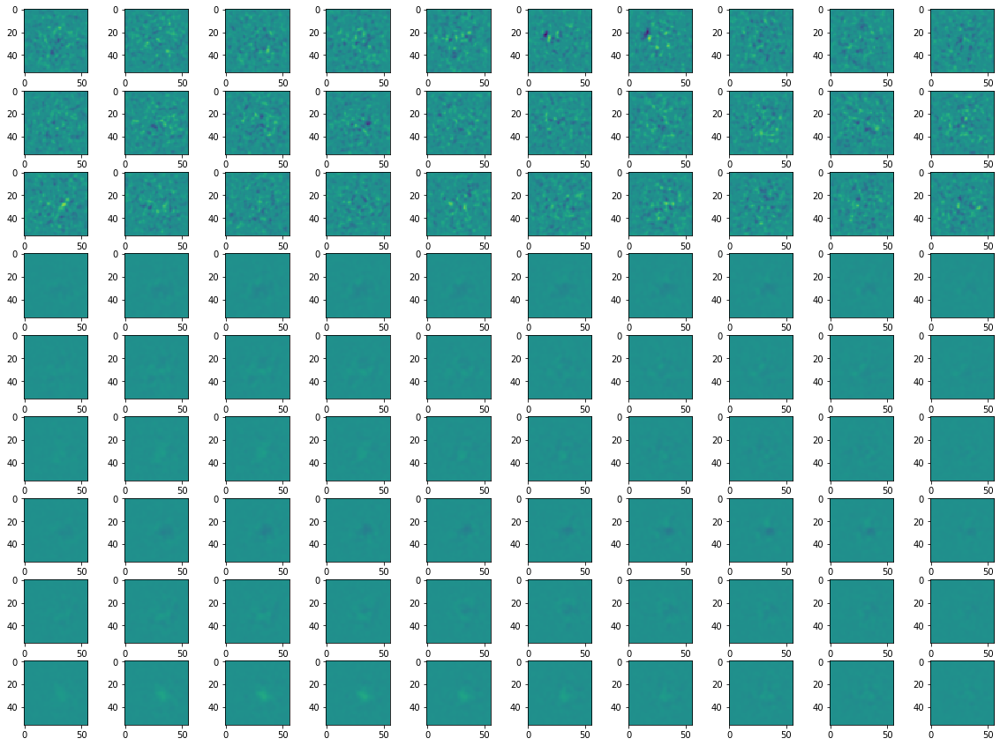

617.6216523647308 sec elapsed fitting GQM
735.5765409469604 sec elapsed fitting everything
Output set to 1 cells
Cell   6:  d2x -R2   LLs = -9.107589721679688e-05
Cell   6:  d2t -R7   LL =-0.00009 -> 0.00138
Cell   6:  Gloc-R5   LL =-0.00009 -> 0.00158
Cell   6:  L1  -R0   LL =-0.00009 -> 0.00158


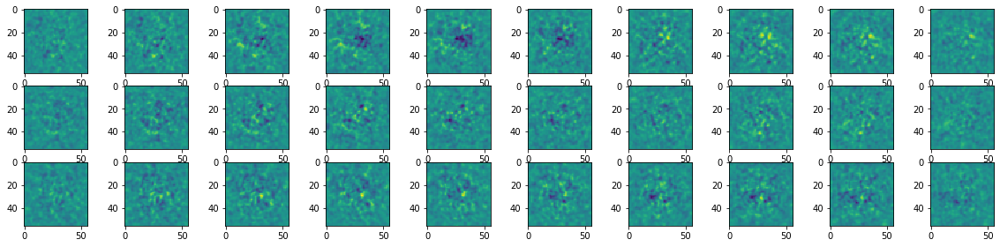

154.87209725379944 sec elapsed fitting GLM
Cell   6:  glm+abs   LL =-0.00009 -> 0.00351


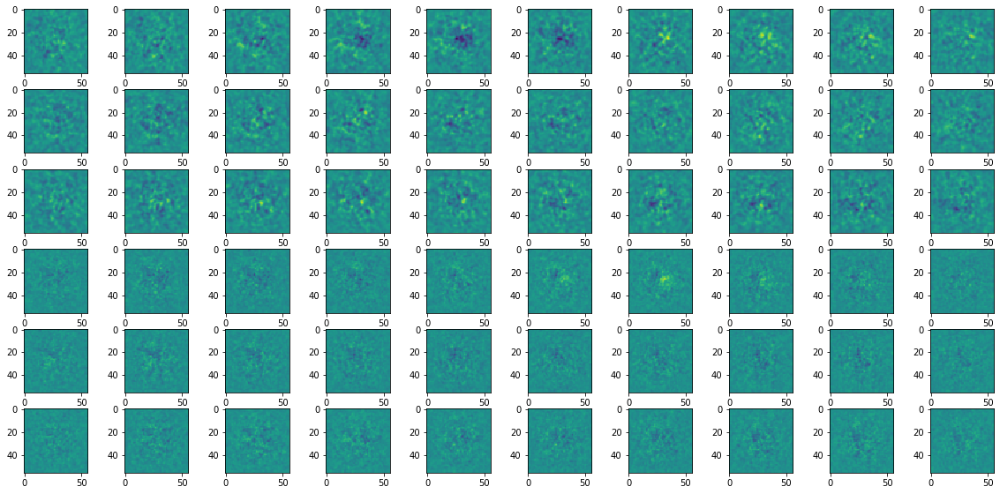

Cell   6:  fitting: 21.67143
Cell   6:  fitting: 21.66894
Cell   6:  fitting: 21.64928
Cell   6:  fitting: 21.69737
Cell   6:  fitting: 21.68612
Cell   6:  fitting: 21.69592
Cell   6:  fitting: 21.63563
Cell   6:  fitting: 21.69315
[4.29148769 4.29262209 4.29261494 4.29257584 4.29248381 4.29195833
 4.29074907 4.28870344]
Cell   6:  d2x -R7   LL = 0.00158 -> 0.00080
[4.29418755 4.29423475 4.29386044 4.29421902 4.29385185 4.29166079
 4.28361559 4.29071712]
Cell   6:  d2t -R6   LL = 0.00158 -> 0.00589
[5.97845697 5.90661287 5.58616781 4.34297419 4.28335905 4.28685284
 4.28759289]
Cell   6:  Gloc-R4   LL = 0.00158 -> 0.00615
[4.28423023 4.28299189 4.2874856  4.2831769  4.28570271 4.33561039
 4.65305758 4.28536654]
Cell   6:  L1  -R1   LL = 0.00158 -> 0.00651


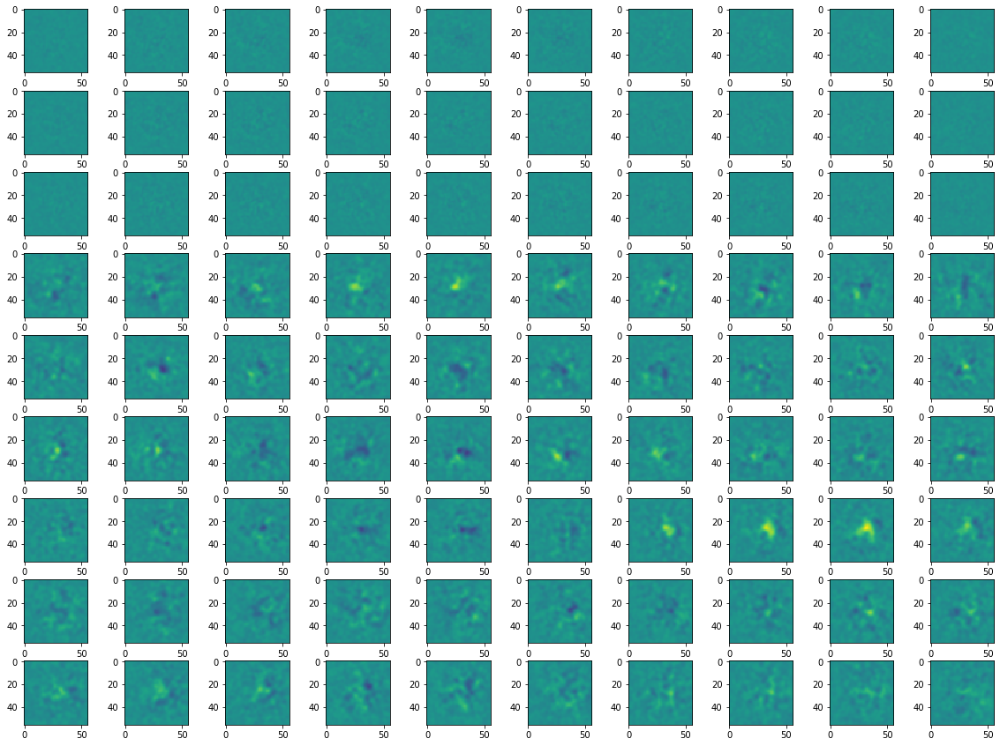

630.7115173339844 sec elapsed fitting GQM
785.5836145877838 sec elapsed fitting everything
Output set to 1 cells
Cell   7:  d2x -R7   LLs = 0.0011088848114013672
Cell   7:  d2t -R7   LL = 0.00111 -> 0.00545
Cell   7:  Gloc-R4   LL = 0.00111 -> 0.00545
Cell   7:  L1  -R4   LL = 0.00111 -> 0.00587


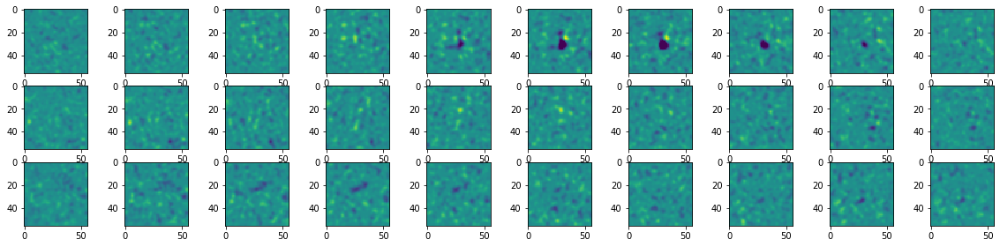

123.24404811859131 sec elapsed fitting GLM
Cell   7:  glm+abs   LL = 0.00111 -> 0.01020


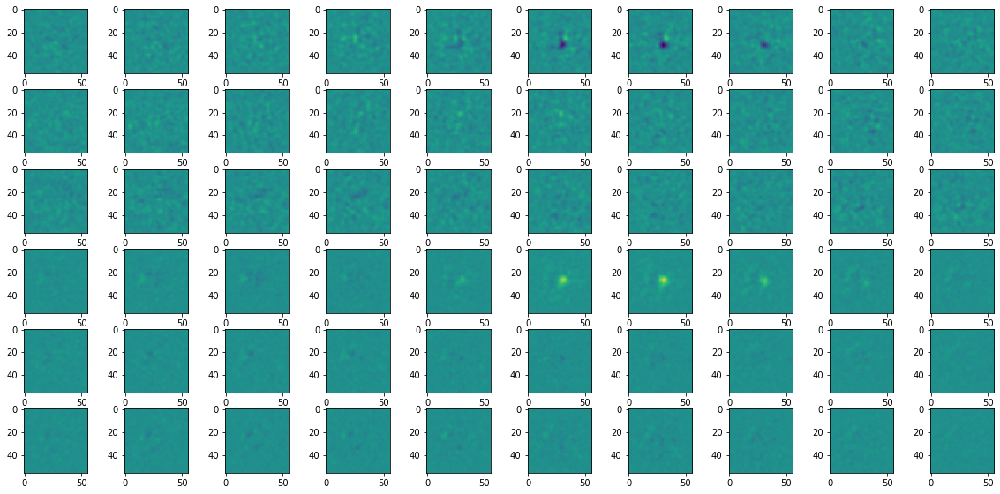

Cell   7:  fitting: 21.65969
Cell   7:  fitting: 21.63317
Cell   7:  fitting: 21.71740
Cell   7:  fitting: 21.65979
Cell   7:  fitting: 21.72550
Cell   7:  fitting: 21.65779
Cell   7:  fitting: 21.69760
Cell   7:  fitting: 21.64015
[2.72626519 2.73203969 2.73207307 2.73211861 2.73210597 2.73218179
 2.73201132 2.73046112]
Cell   7:  d2x -R0   LL = 0.00545 -> 0.00437
[2.72868919 2.72867036 2.72866702 2.72866535 2.72842526 2.72622728
 2.72060013 2.72152925]
Cell   7:  d2t -R6   LL = 0.00545 -> 0.01004
[4.90576792 4.46104717 3.79161024 2.79099131 2.71893048 2.71751618
 2.7228744 ]
Cell   7:  Gloc-R5   LL = 0.00545 -> 0.01312
[2.71749711 2.7173593  2.71734262 2.71732569 2.71682596 2.72365141
 2.72410655 2.72501087]
Cell   7:  L1  -R4   LL = 0.00545 -> 0.01381


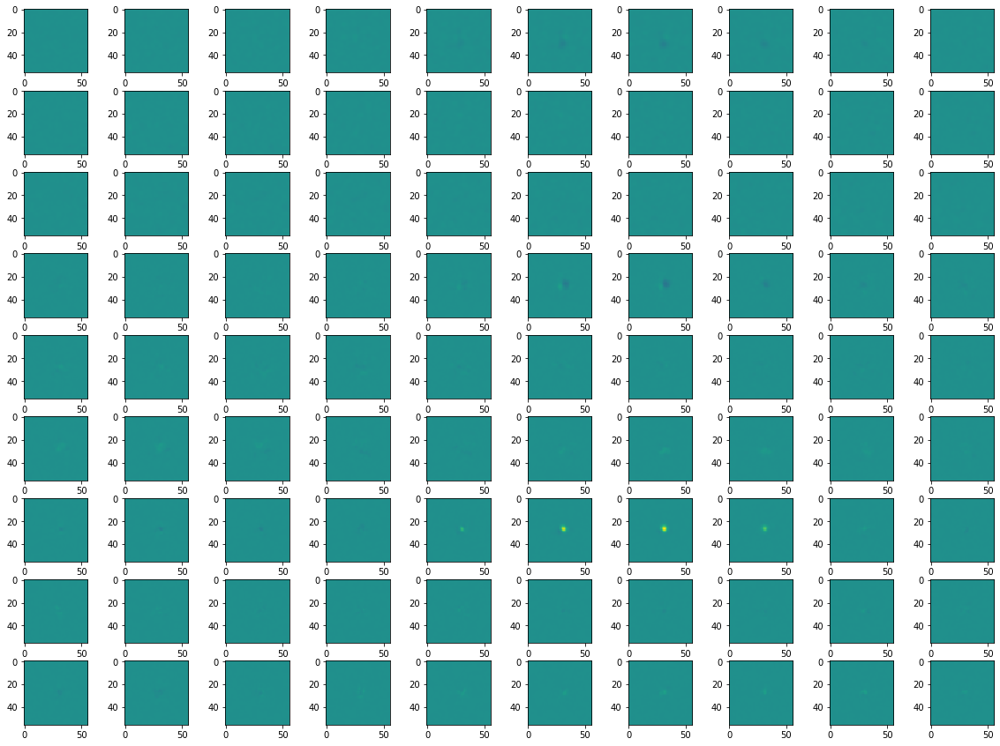

651.848149061203 sec elapsed fitting GQM
775.0921971797943 sec elapsed fitting everything
Output set to 1 cells
Cell   8:  d2x -R7   LLs = 0.0030260086059570312
Cell   8:  d2t -R7   LL = 0.00303 -> 0.00766
Cell   8:  Gloc-R4   LL = 0.00303 -> 0.00766
Cell   8:  L1  -R4   LL = 0.00303 -> 0.00813


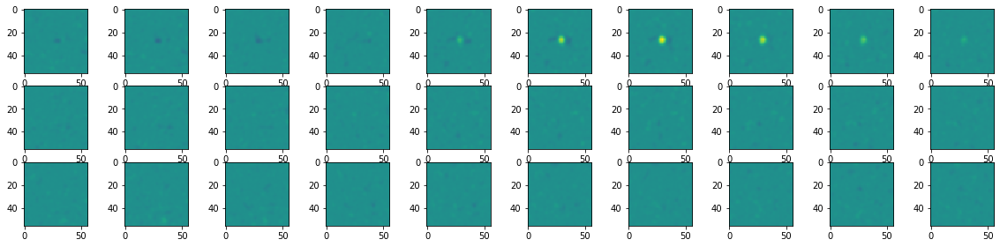

144.78876280784607 sec elapsed fitting GLM
Cell   8:  glm+abs   LL = 0.00303 -> 0.00771


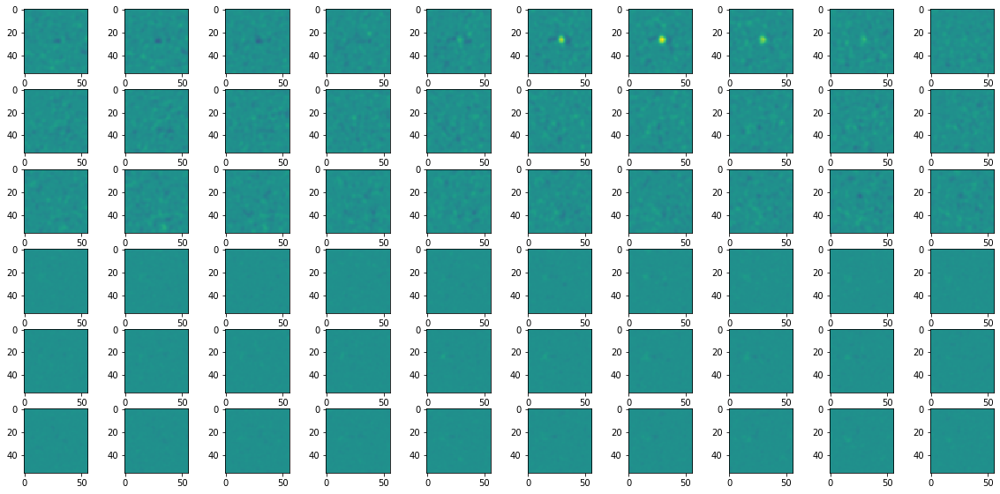

Cell   8:  fitting: 21.64273
Cell   8:  fitting: 21.68332
Cell   8:  fitting: 21.66696
Cell   8:  fitting: 21.70658
Cell   8:  fitting: 21.69641
Cell   8:  fitting: 21.67733
Cell   8:  fitting: 21.64245
Cell   8:  fitting: 21.69130
[2.76671767 2.76657629 2.76652312 2.7665453  2.76650977 2.76619625
 2.76643586 2.76395822]
Cell   8:  d2x -R7   LL = 0.00766 -> 0.00433
[2.76986814 2.76985335 2.76988292 2.76992226 2.76996017 2.76937485
 2.76659012 2.76458621]
Cell   8:  d2t -R7   LL = 0.00766 -> 0.00370
[3.60897279 3.59016466 3.45151162 2.83337164 2.76992226 2.76482654
 2.76585484]
Cell   8:  Gloc-R5   LL = 0.00766 -> 0.00346
[2.7694068  2.76934385 2.76950693 2.76992226 2.7656455  2.76347899
 2.76479936 2.76539803]
Cell   8:  L1  -R5   LL = 0.00766 -> 0.00481


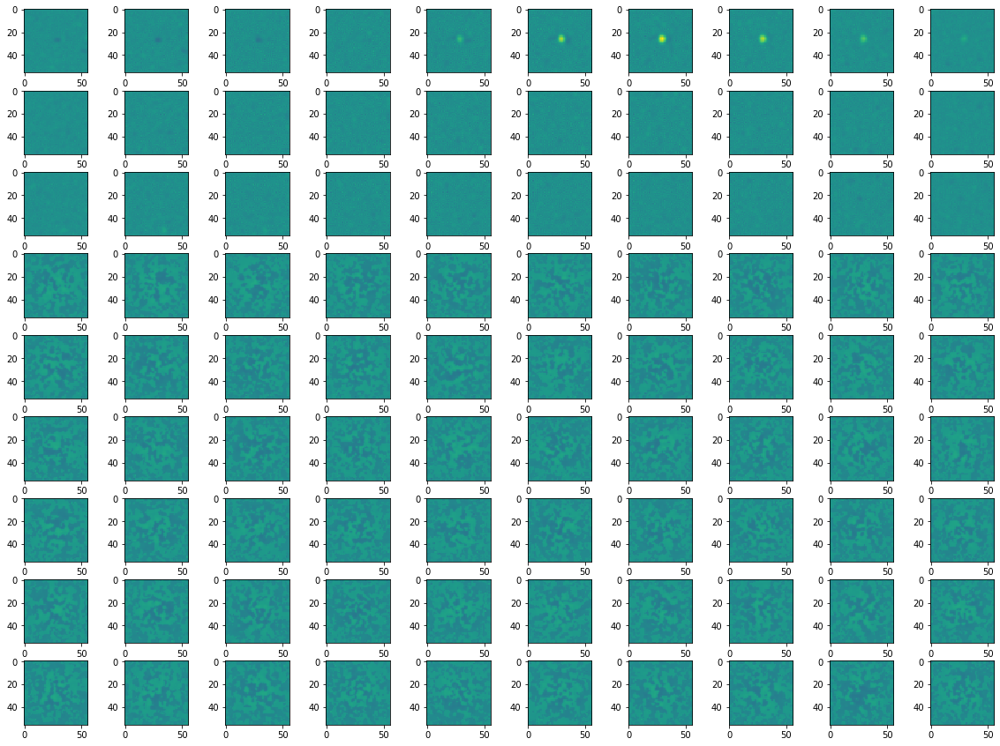

699.7360970973969 sec elapsed fitting GQM
844.5248599052429 sec elapsed fitting everything
Output set to 1 cells
Cell   9:  d2x -R7   LLs = -0.010175704956054688
Cell   9:  d2t -R7   LL =-0.01018 ->-0.00273
Cell   9:  Gloc-R6   LL =-0.01018 ->-0.00051
Cell   9:  L1  -R5   LL =-0.01018 ->-0.00006


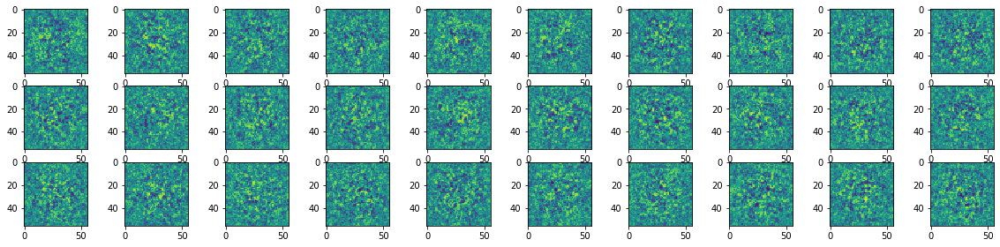

125.50482201576233 sec elapsed fitting GLM
Cell   9:  glm+abs   LL =-0.01018 -> 0.00007


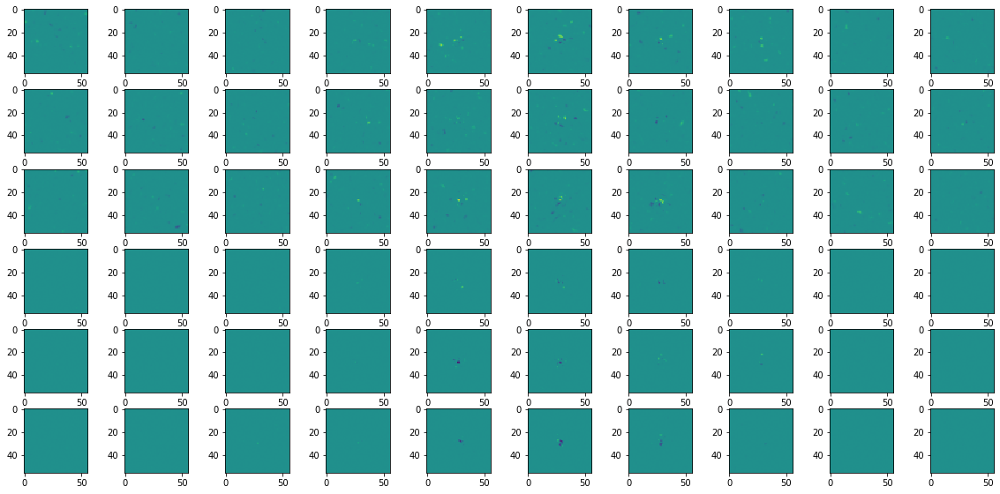

Cell   9:  fitting: 21.74410
Cell   9:  fitting: 21.67095
Cell   9:  fitting: 21.70155
Cell   9:  fitting: 21.63727
Cell   9:  fitting: 21.71450
Cell   9:  fitting: 21.67404
Cell   9:  fitting: 21.73700
Cell   9:  fitting: 21.68378
[3.26806569 3.26801562 3.26770091 3.26814389 3.26834655 3.26778507
 3.26800346 3.26794243]
Cell   9:  d2x -R2   LL =-0.00051 -> 0.00001
[3.26717663 3.26631951 3.26587558 3.26675773 3.26639295 3.26634526
 3.26677489 3.26883578]
Cell   9:  d2t -R2   LL =-0.00051 -> 0.00183
[3.28876734 3.28920865 3.28896213 3.27706647 3.26626992 3.26706696
 3.26827717]
Cell   9:  Gloc-R4   LL =-0.00051 -> 0.00144
[3.26679754 3.2667892  3.26655483 3.26626992 3.26620746 3.26600194
 3.26857424 3.2684269 ]
Cell   9:  L1  -R5   LL =-0.00051 -> 0.00170


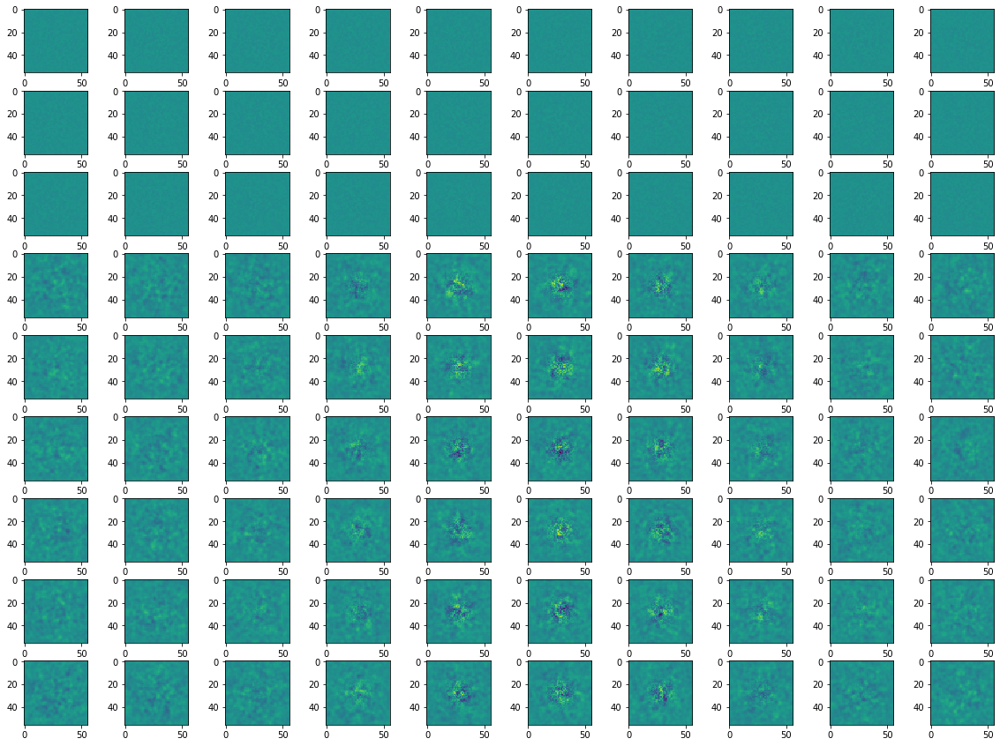

699.8355112075806 sec elapsed fitting GQM
825.3403332233429 sec elapsed fitting everything
Output set to 1 cells
Cell  10:  d2x -R7   LLs = -0.006247043609619141
Cell  10:  d2t -R7   LL =-0.00625 ->-0.00519
Cell  10:  Gloc-R6   LL =-0.00625 ->-0.00078
Cell  10:  L1  -R6   LL =-0.00625 -> 0.00024


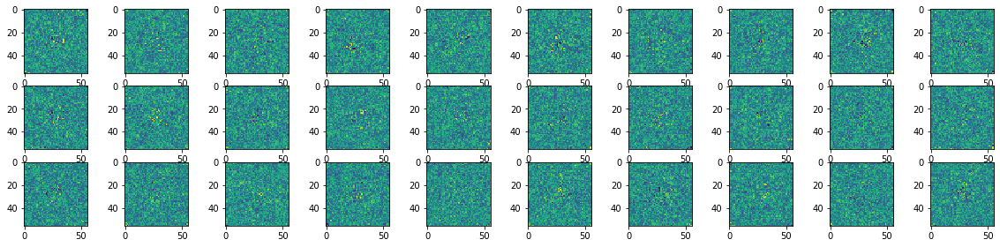

131.98790860176086 sec elapsed fitting GLM
Cell  10:  glm+abs   LL =-0.00625 ->-0.57530


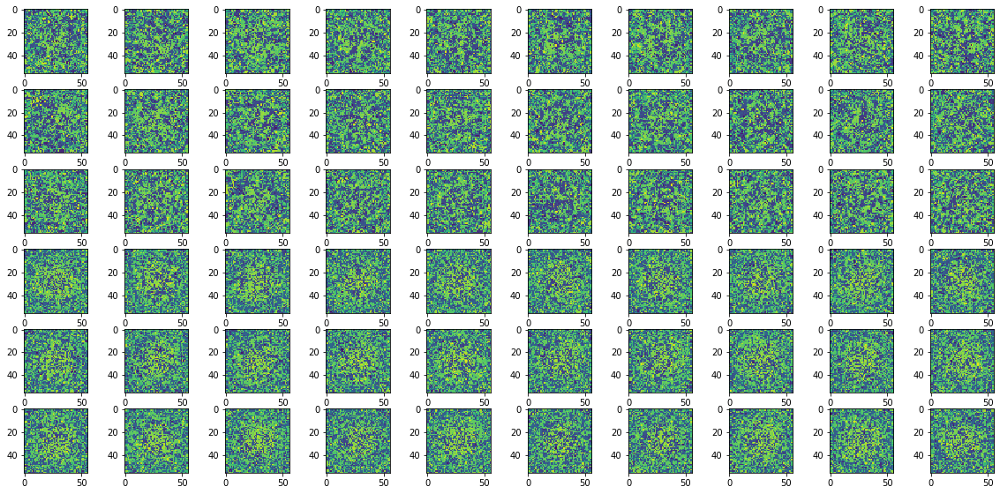

Cell  10:  fitting: 21.67810
Cell  10:  fitting: 21.67567
Cell  10:  fitting: 21.63684
Cell  10:  fitting: 21.66989
Cell  10:  fitting: 21.67333
Cell  10:  fitting: 21.70750
Cell  10:  fitting: 21.63839
Cell  10:  fitting: 21.68692
[3.67533898 3.67579246 3.67577648 3.6760149  3.67511249 3.67617941
 3.67560506 3.67567158]
Cell  10:  d2x -R4   LL =-0.00078 -> 0.00060
[3.67426062 3.67664671 3.67571831 3.67549777 3.67572451 3.67574358
 3.67577195 3.67576933]
Cell  10:  d2t -R0   LL =-0.00078 -> 0.00146
[3.67573667 3.67595959 3.67575192 3.6758287  3.67573237 3.67678356
 3.67662716]
Cell  10:  Gloc-R4   LL =-0.00078 ->-0.00002
[3.67593098 3.67625117 3.67572665 3.67573237 3.67559695 3.67565179
 3.67597461 3.67666006]
Cell  10:  L1  -R4   LL =-0.00078 -> 0.00012


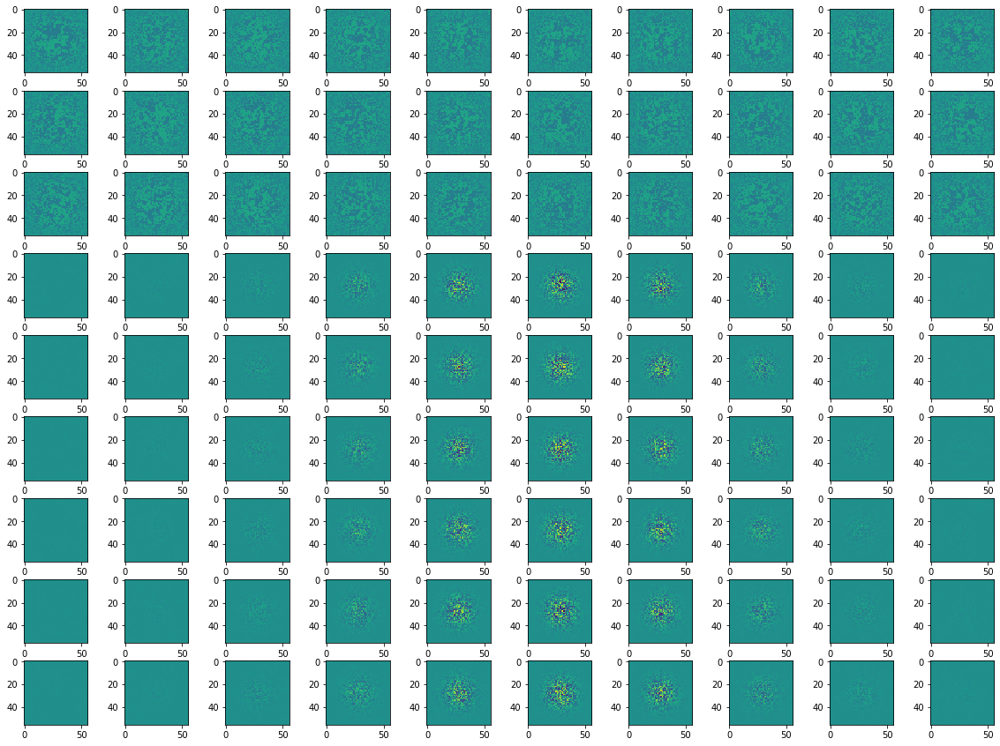

699.4823877811432 sec elapsed fitting GQM
831.470296382904 sec elapsed fitting everything
Output set to 1 cells
Cell  11:  d2x -R0   LLs = -0.00734400749206543
Cell  11:  d2t -R7   LL =-0.00734 ->-0.00557
Cell  11:  Gloc-R6   LL =-0.00734 ->-0.00051
Cell  11:  L1  -R6   LL =-0.00734 -> 0.00081


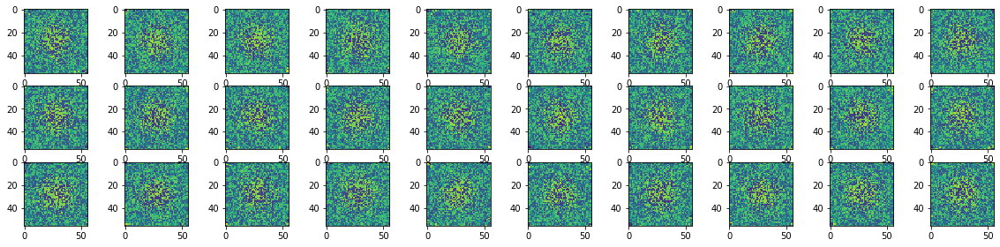

141.3435537815094 sec elapsed fitting GLM
Cell  11:  glm+abs   LL =-0.00734 ->-0.01539


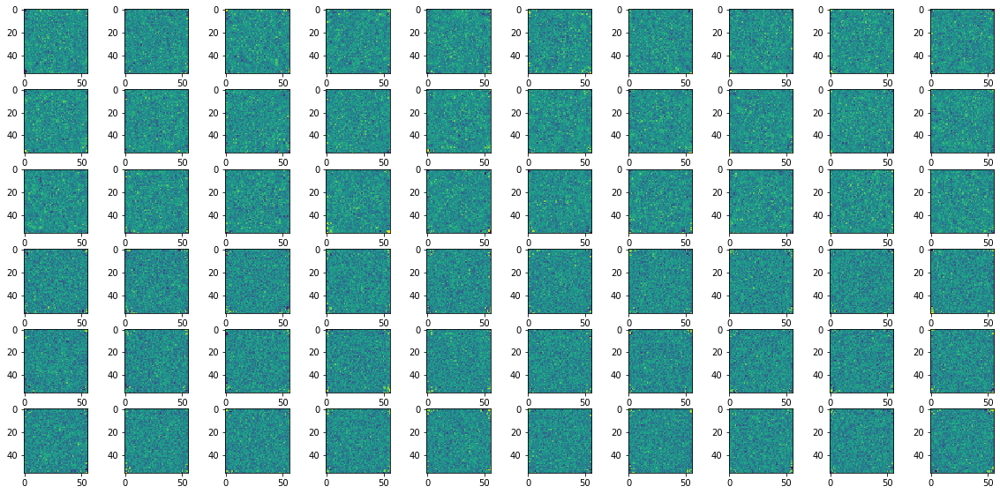

Cell  11:  fitting: 21.71109
Cell  11:  fitting: 21.69112
Cell  11:  fitting: 21.67123
Cell  11:  fitting: 21.61817
Cell  11:  fitting: 21.67252
Cell  11:  fitting: 21.66711
Cell  11:  fitting: 21.65796
Cell  11:  fitting: 21.69535
[3.02902293 3.02722883 3.0239532  3.02390528 3.02422357 3.02386642
 3.02416611 3.02383351]
Cell  11:  d2x -R7   LL =-0.00051 -> 0.00023
[3.02386117 3.02517343 3.02644181 3.02392101 3.0239172  3.02446365
 3.0238812  3.0241673 ]
Cell  11:  d2t -R0   LL =-0.00051 -> 0.00021
[3.0238688  3.02669525 3.02395725 3.02394819 3.02392101 3.02390099
 3.02356005]
Cell  11:  Gloc-R6   LL =-0.00051 -> 0.00051
[3.024122   3.02392578 3.02574897 3.02605939 3.02569795 3.02400231
 3.02406144 3.02398491]
Cell  11:  L1  -R1   LL =-0.00051 -> 0.00014


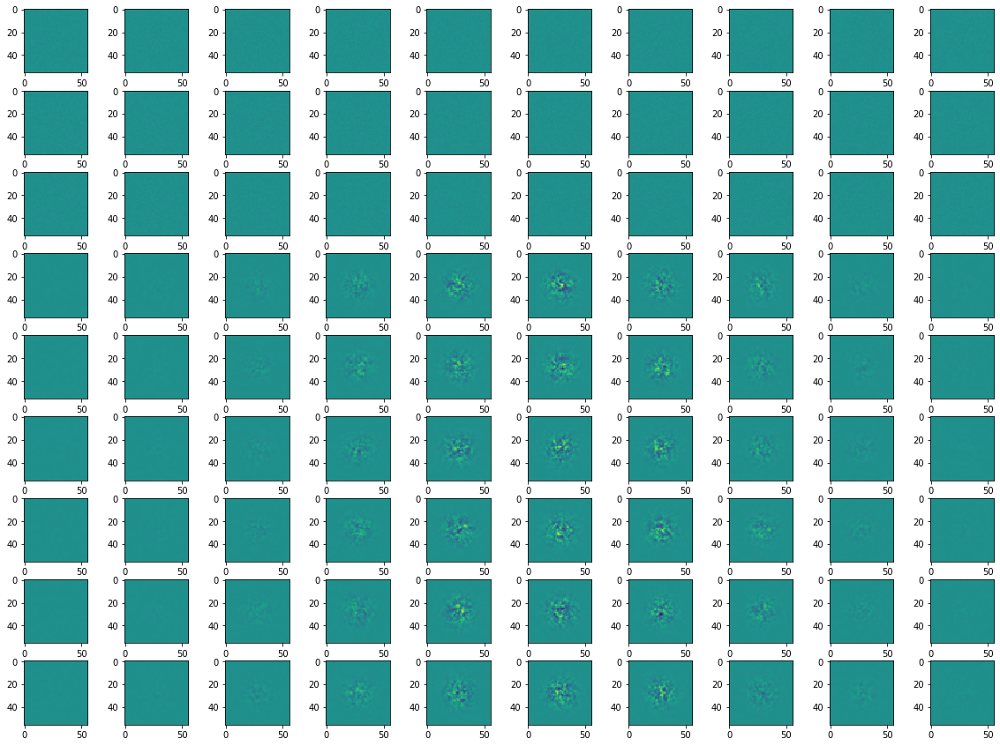

699.5785145759583 sec elapsed fitting GQM
840.9220683574677 sec elapsed fitting everything
Output set to 1 cells
Cell  12:  d2x -R0   LLs = -0.010024070739746094
Cell  12:  d2t -R7   LL =-0.01002 ->-0.00326
Cell  12:  Gloc-R6   LL =-0.01002 ->-0.00045
Cell  12:  L1  -R5   LL =-0.01002 ->-0.00021


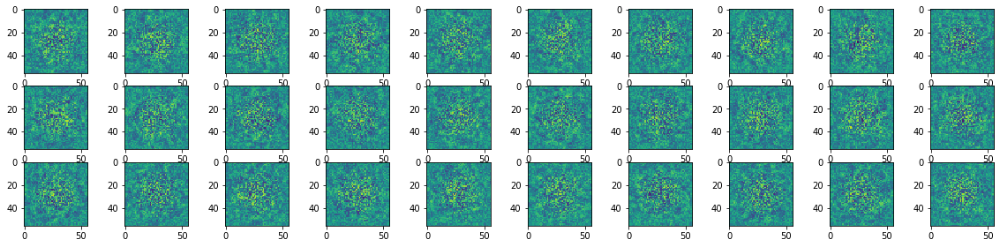

180.52363324165344 sec elapsed fitting GLM
Cell  12:  glm+abs   LL =-0.01002 ->-0.00263


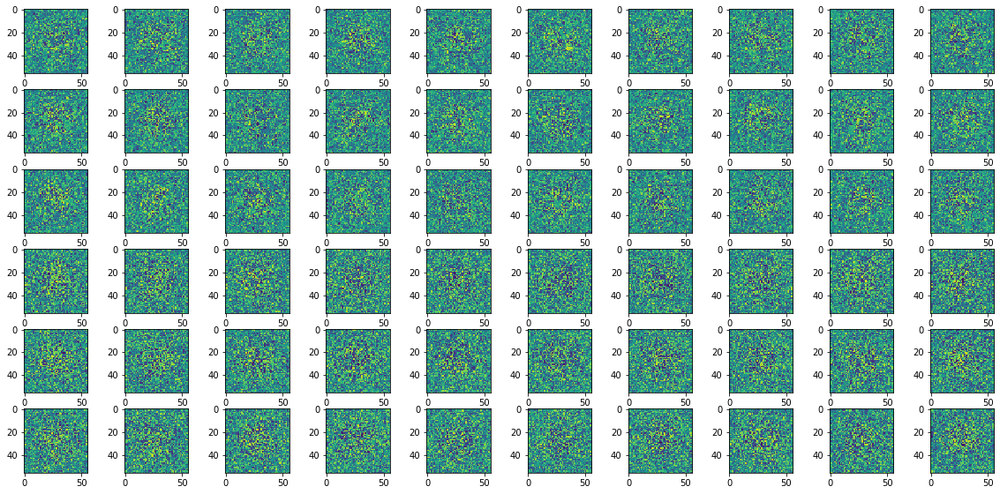

Cell  12:  fitting: 21.65229
Cell  12:  fitting: 21.69753
Cell  12:  fitting: 21.69362
Cell  12:  fitting: 21.71503
Cell  12:  fitting: 21.65348
Cell  12:  fitting: 21.69949
Cell  12:  fitting: 21.64550
Cell  12:  fitting: 21.69437
[4.01903296 4.01856852 4.01921082 4.01945353 4.02019167 4.01857758
 4.01813364 4.0198164 ]
Cell  12:  d2x -R6   LL =-0.00045 -> 0.00124
[4.02004671 4.02009583 4.02017546 4.02006578 4.01940012 4.01995277
 4.01962566 4.01882172]
Cell  12:  d2t -R7   LL =-0.00045 -> 0.00055
[4.0202136  4.0202589  4.02013874 4.02030897 4.02006578 4.01931715
 4.01935625]
Cell  12:  Gloc-R5   LL =-0.00045 -> 0.00005
[4.02015734 4.02024651 4.01991844 4.02006578 4.01937628 4.01916218
 4.01886463 4.03380442]
Cell  12:  L1  -R6   LL =-0.00045 -> 0.00051


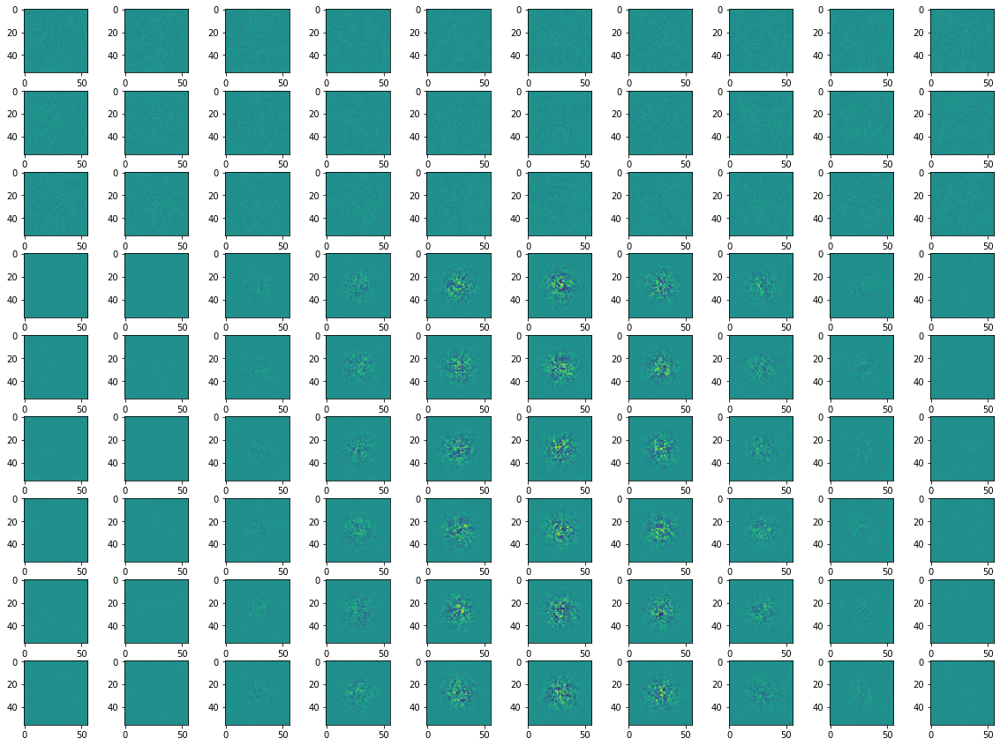

699.5886766910553 sec elapsed fitting GQM
880.1123099327087 sec elapsed fitting everything
Output set to 1 cells
Cell  13:  d2x -R0   LLs = -0.002354264259338379
Cell  13:  d2t -R7   LL =-0.00235 ->-0.00126
Cell  13:  Gloc-R6   LL =-0.00235 -> 0.00034
Cell  13:  L1  -R4   LL =-0.00235 -> 0.00034


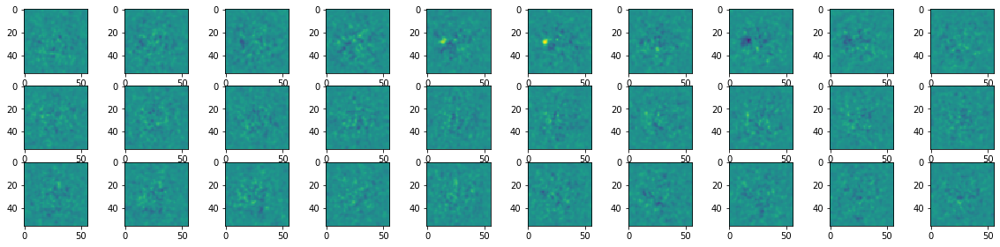

127.9168746471405 sec elapsed fitting GLM
Cell  13:  glm+abs   LL =-0.00235 -> 0.00053


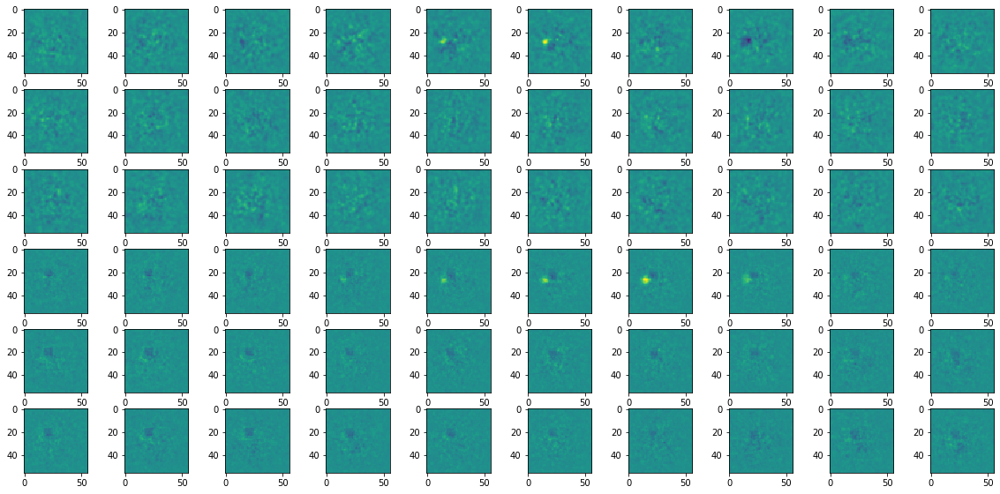

Cell  13:  fitting: 21.71028
Cell  13:  fitting: 21.68965
Cell  13:  fitting: 21.73402
Cell  13:  fitting: 21.65660
Cell  13:  fitting: 21.69305
Cell  13:  fitting: 21.63826
Cell  13:  fitting: 21.69014
Cell  13:  fitting: 21.67914
[0.97337544 0.97471517 0.97471529 0.97471416 0.97470778 0.97464126
 0.9743467  0.97413385]
Cell  13:  d2x -R0   LL = 0.00034 ->-0.00492
[0.97383869 0.97383714 0.97384048 0.97383612 0.97379953 0.97344118
 0.9724158  0.97145128]
Cell  13:  d2t -R7   LL = 0.00034 ->-0.00300
[1.46055317 1.36751127 1.223297   0.99809754 0.97161561 0.96822691
 0.96808255]
Cell  13:  Gloc-R6   LL = 0.00034 -> 0.00037
[0.96808326 0.96808326 0.96808326 0.9680832  0.96807003 0.96806556
 0.96812028 0.96806794]
Cell  13:  L1  -R5   LL = 0.00034 -> 0.00039


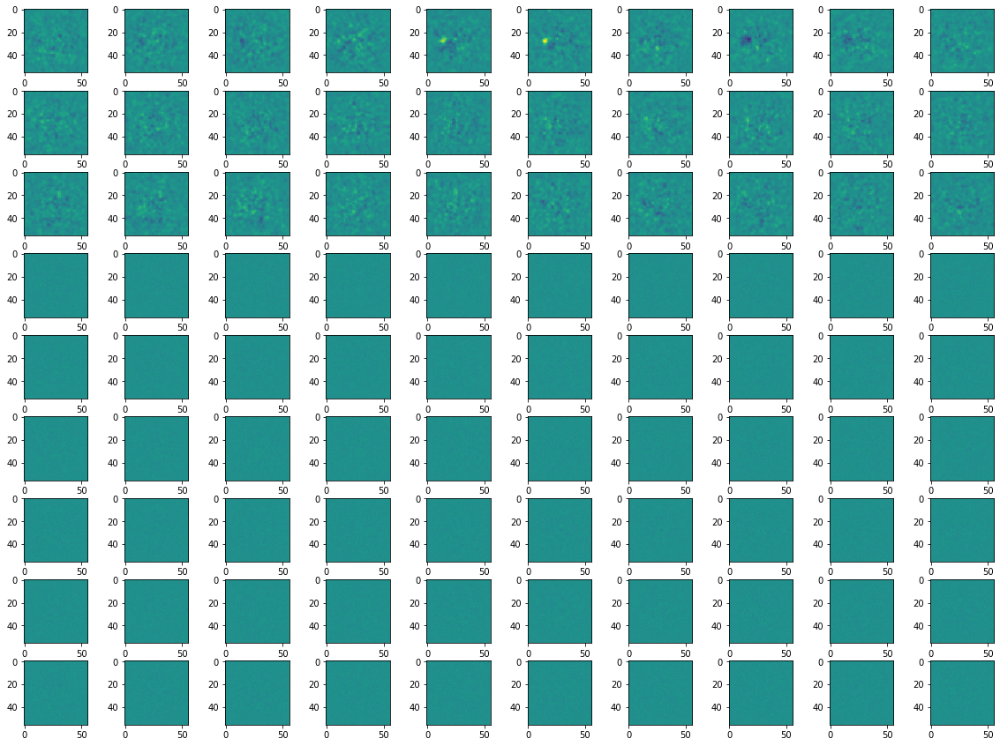

621.674409866333 sec elapsed fitting GQM
749.5912845134735 sec elapsed fitting everything
Output set to 1 cells
Cell  14:  d2x -R7   LLs = -0.003374338150024414
Cell  14:  d2t -R7   LL =-0.00337 ->-0.00142
Cell  14:  Gloc-R6   LL =-0.00337 -> 0.00041
Cell  14:  L1  -R4   LL =-0.00337 -> 0.00056


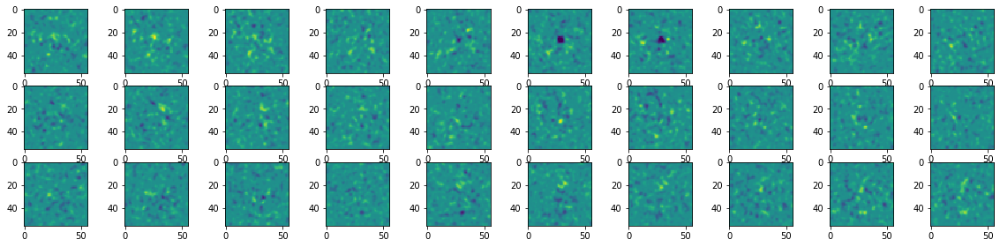

130.18482851982117 sec elapsed fitting GLM
Cell  14:  glm+abs   LL =-0.00337 -> 0.00216


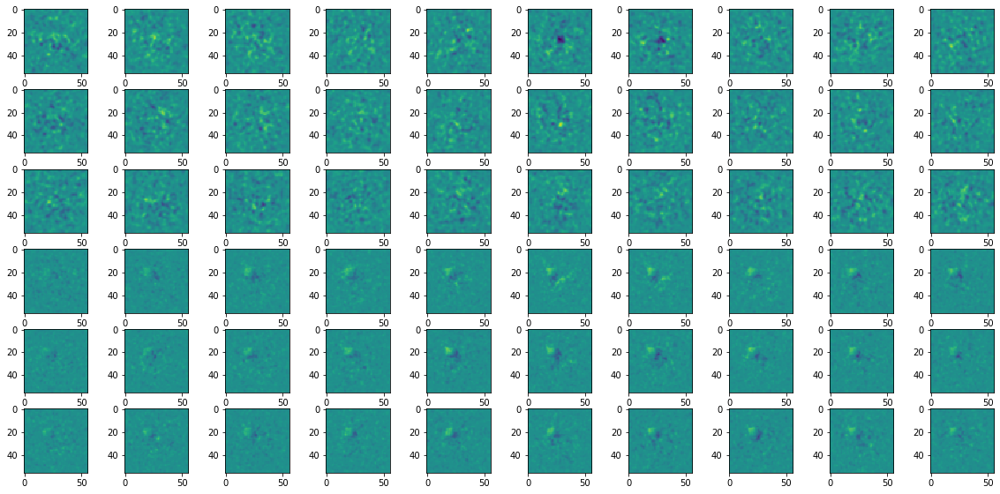

Cell  14:  fitting: 22.26862
Cell  14:  fitting: 21.77362
Cell  14:  fitting: 21.70583
Cell  14:  fitting: 21.68710
Cell  14:  fitting: 21.66913
Cell  14:  fitting: 21.71455
Cell  14:  fitting: 21.66739
Cell  14:  fitting: 21.68272
[3.20636916 3.20304632 3.20305061 3.20310211 3.2030797  3.2030561
 3.20304823 3.20262504]
Cell  14:  d2x -R7   LL = 0.00041 ->-0.00203
[3.20458913 3.2045958  3.20459342 3.20459032 3.20456934 3.20388126
 3.20188332 3.19998789]
Cell  14:  d2t -R7   LL = 0.00041 -> 0.00061
[3.45935965 3.45471454 3.42097759 3.21033502 3.19995189 3.2010417
 3.20148158]
Cell  14:  Gloc-R4   LL = 0.00041 -> 0.00064
[3.19963551 3.19964361 3.1997354  3.19988847 3.20084691 3.20060349
 3.2024138  3.20237279]
Cell  14:  L1  -R0   LL = 0.00041 -> 0.00096


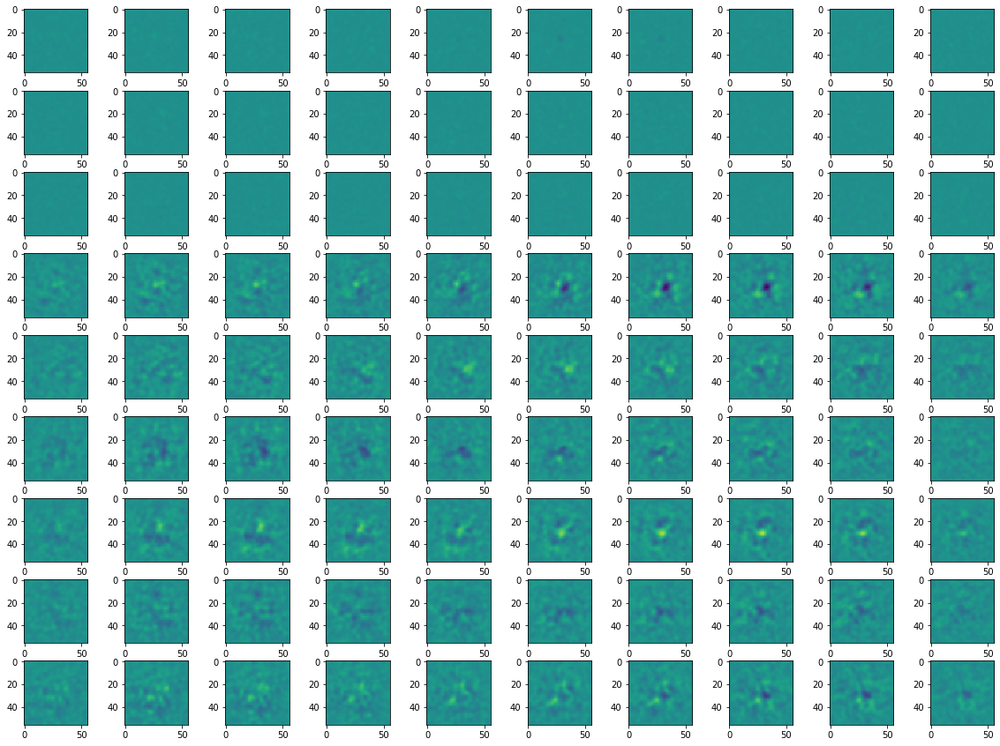

665.3906133174896 sec elapsed fitting GQM
795.5754418373108 sec elapsed fitting everything
Output set to 1 cells
Cell  15:  d2x -R7   LLs = 0.0068094730377197266
Cell  15:  d2t -R7   LL = 0.00681 -> 0.01280
Cell  15:  Gloc-R3   LL = 0.00681 -> 0.01457
Cell  15:  L1  -R3   LL = 0.00681 -> 0.01459


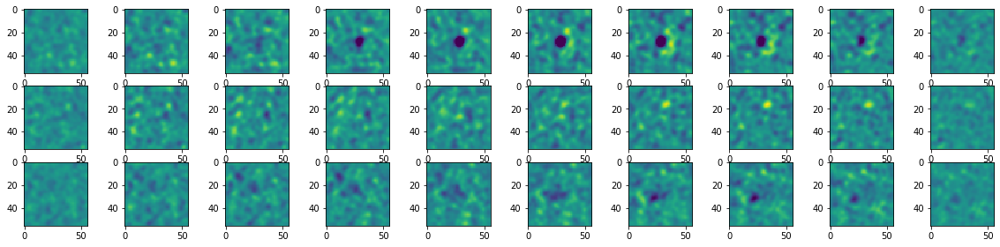

151.64809203147888 sec elapsed fitting GLM
Cell  15:  glm+abs   LL = 0.00681 -> 0.02943


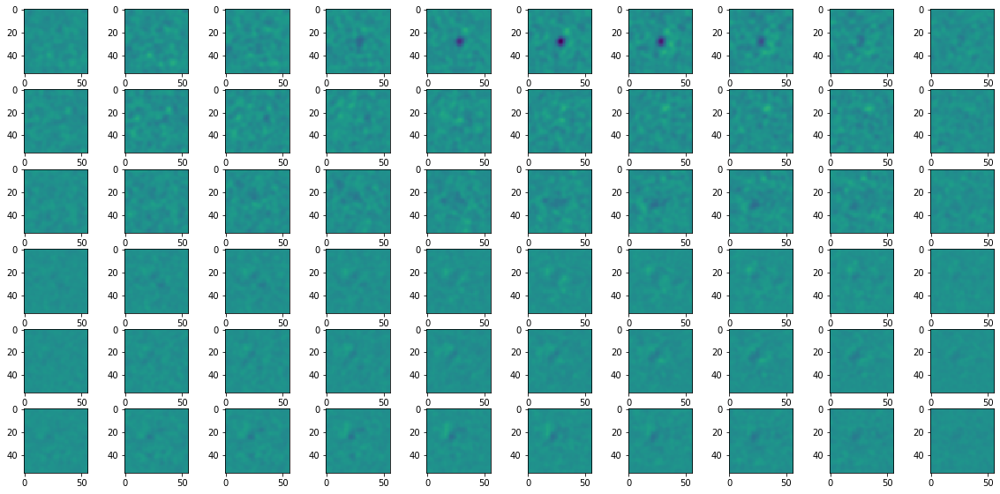

Cell  15:  fitting: 21.68302
Cell  15:  fitting: 21.70907
Cell  15:  fitting: 21.67464
Cell  15:  fitting: 21.67718
Cell  15:  fitting: 21.66944
Cell  15:  fitting: 21.65967
Cell  15:  fitting: 21.65286
Cell  15:  fitting: 21.68901
[2.53327775 2.53481102 2.53506494 2.53496981 2.53482628 2.53521323
 2.54001856 2.53387332]
Cell  15:  d2x -R0   LL = 0.01457 -> 0.00252
[2.53326821 2.53326917 2.53326917 2.53326988 2.53319502 2.5279367
 2.51852584 2.52000785]
Cell  15:  d2t -R6   LL = 0.01457 -> 0.01727
[4.65562916 4.44613314 3.93991685 2.6486907  2.52212048 2.5199573
 2.52053213]
Cell  15:  Gloc-R5   LL = 0.01457 -> 0.01584
[2.52269077 2.52268767 2.52254486 2.52212048 2.51848531 2.52331257
 2.52773571 9.14226151]
Cell  15:  L1  -R4   LL = 0.01457 -> 0.01731


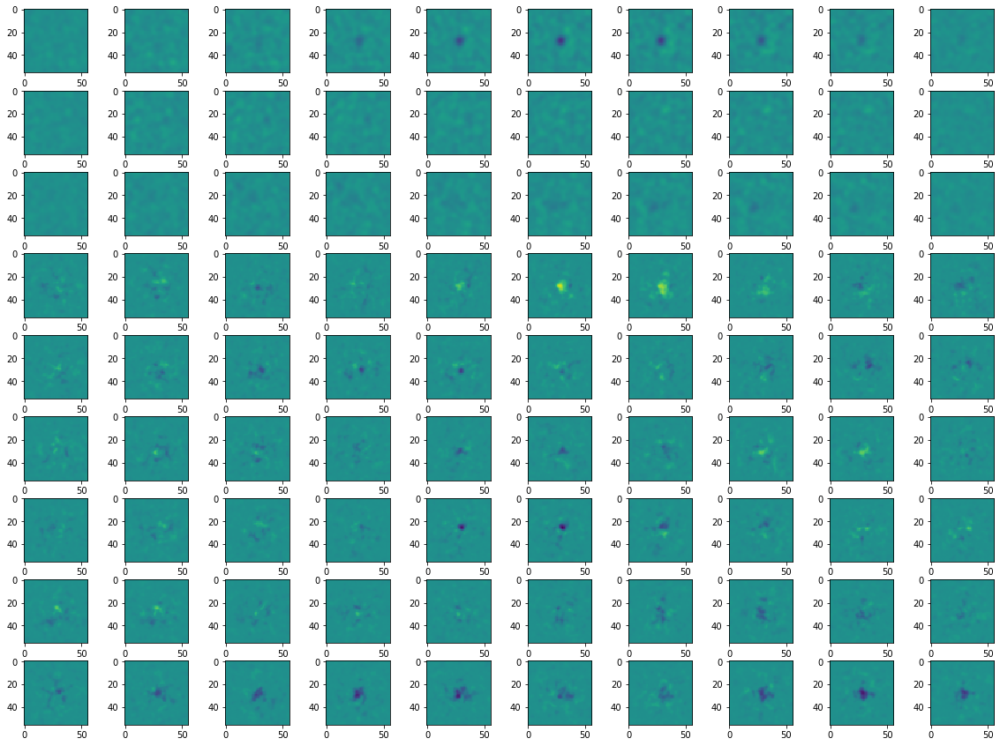

623.8610773086548 sec elapsed fitting GQM
775.5091693401337 sec elapsed fitting everything
Output set to 1 cells
Cell  16:  d2x -R2   LLs = 0.006033420562744141
Cell  16:  d2t -R7   LL = 0.00603 -> 0.00789
Cell  16:  Gloc-R3   LL = 0.00603 -> 0.01289
Cell  16:  L1  -R1   LL = 0.00603 -> 0.01429


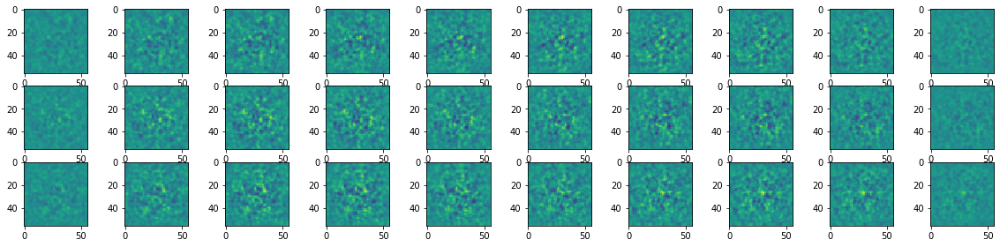

183.90375566482544 sec elapsed fitting GLM
Cell  16:  glm+abs   LL = 0.00603 -> 0.00758


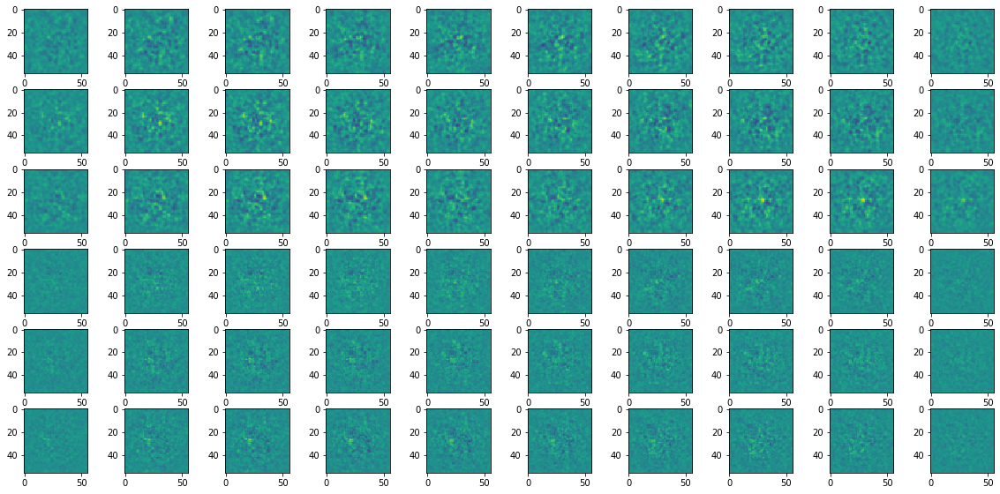

Cell  16:  fitting: 21.69216
Cell  16:  fitting: 21.66777
Cell  16:  fitting: 21.67437
Cell  16:  fitting: 21.66960
Cell  16:  fitting: 21.66234
Cell  16:  fitting: 21.73234
Cell  16:  fitting: 21.69385
Cell  16:  fitting: 21.63976
[4.14721298 4.15093565 4.15097952 4.15078878 4.15078545 4.15109205
 4.15240383 4.15069008]
Cell  16:  d2x -R0   LL = 0.01289 -> 0.02009
[4.14757729 4.14757872 4.14756918 4.14752102 4.14718962 4.14595032
 4.14940262 4.15079069]
Cell  16:  d2t -R5   LL = 0.01289 -> 0.02136
[6.59624481 6.37319422 6.50084305 4.33467865 4.14595938 4.1523695
 4.15227461]
Cell  16:  Gloc-R4   LL = 0.01289 -> 0.02135
[4.14536953 4.14534855 4.14515257 4.1452775  4.14780426 4.15310526
 8.50814915 4.15629339]
Cell  16:  L1  -R2   LL = 0.01289 -> 0.02215


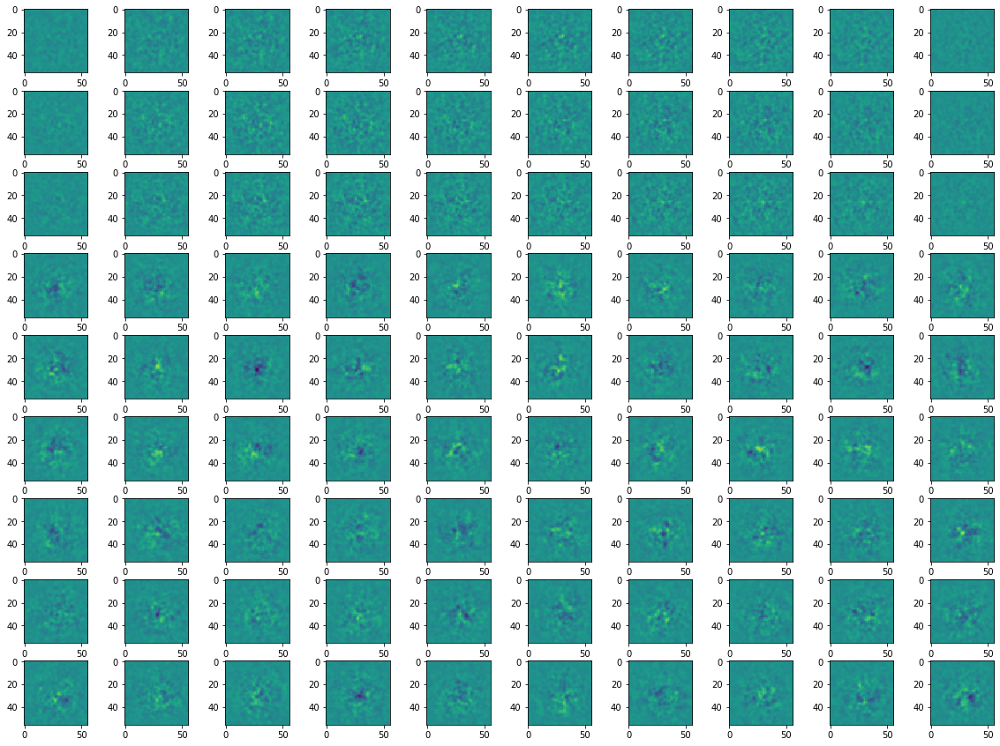

610.6528480052948 sec elapsed fitting GQM
794.5566036701202 sec elapsed fitting everything
Output set to 1 cells
Cell  17:  d2x -R1   LLs = -0.0015940666198730469
Cell  17:  d2t -R7   LL =-0.00159 -> 0.00077
Cell  17:  Gloc-R5   LL =-0.00159 -> 0.00137
Cell  17:  L1  -R2   LL =-0.00159 -> 0.00140


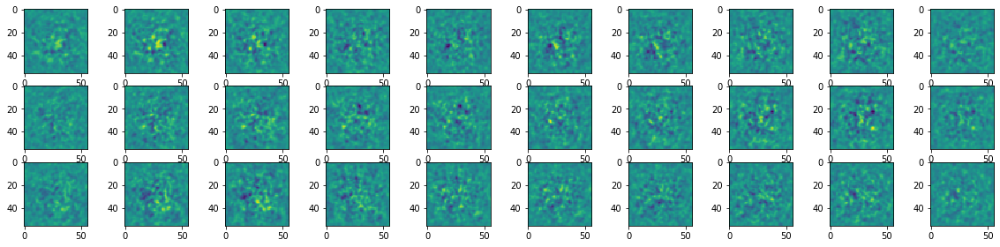

154.42472791671753 sec elapsed fitting GLM
Cell  17:  glm+abs   LL =-0.00159 -> 0.00225


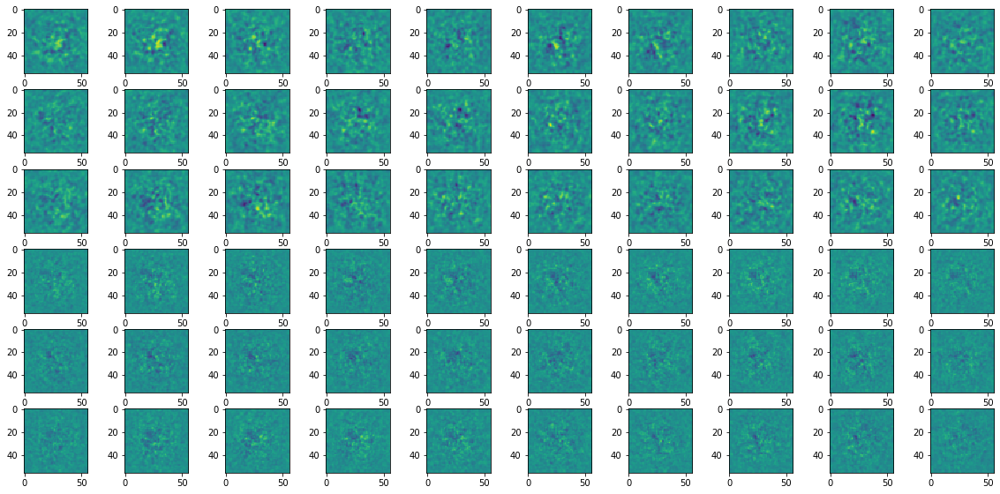

Cell  17:  fitting: 21.71151
Cell  17:  fitting: 21.67455
Cell  17:  fitting: 21.67180
Cell  17:  fitting: 21.66718
Cell  17:  fitting: 21.68300
Cell  17:  fitting: 21.70964
Cell  17:  fitting: 21.71116
Cell  17:  fitting: 21.69029
[4.0915699  4.08769846 4.0878768  4.08788395 4.08749056 4.08781433
 4.08906507 4.09217882]
Cell  17:  d2x -R4   LL = 0.00137 ->-0.00831
[4.08963251 4.08963823 4.08964157 4.08956623 4.08968067 4.08614445
 4.08264017 4.08087254]
Cell  17:  d2t -R7   LL = 0.00137 ->-0.00169
[7.57525826 6.70875692 5.53305769 4.13913965 4.07768154 4.07744074
 4.07771778]
Cell  17:  Gloc-R5   LL = 0.00137 -> 0.00174
[4.07772255 4.07747173 4.07771063 4.07744026 4.07791138 4.07784796
 4.07787466 4.07781315]
Cell  17:  L1  -R3   LL = 0.00137 -> 0.00174


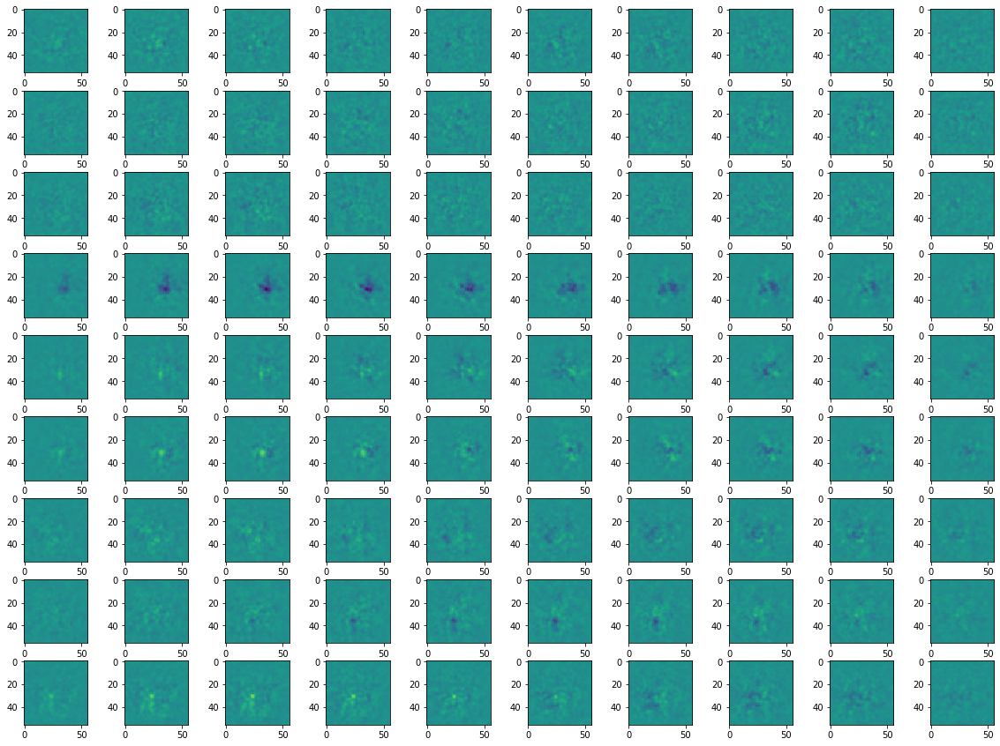

643.5646262168884 sec elapsed fitting GQM
797.989354133606 sec elapsed fitting everything
Output set to 1 cells
Cell  18:  d2x -R7   LLs = 0.016158103942871094
Cell  18:  d2t -R3   LL = 0.01616 -> 0.01619
Cell  18:  Gloc-R3   LL = 0.01616 -> 0.02209
Cell  18:  L1  -R2   LL = 0.01616 -> 0.02222


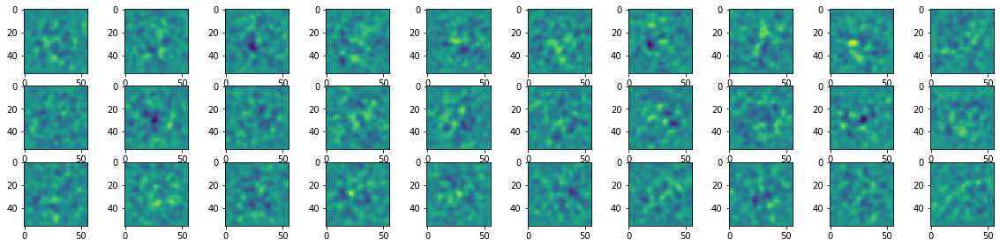

159.42683053016663 sec elapsed fitting GLM
Cell  18:  glm+abs   LL = 0.01616 -> 0.01643


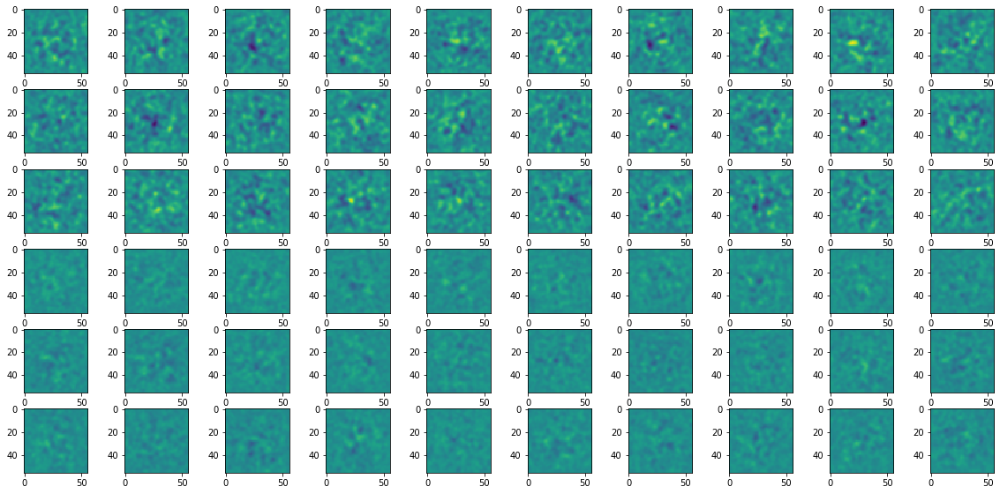

Cell  18:  fitting: 21.68902
Cell  18:  fitting: 21.67539
Cell  18:  fitting: 21.71436
Cell  18:  fitting: 21.68165
Cell  18:  fitting: 21.71463
Cell  18:  fitting: 21.57641
Cell  18:  fitting: 21.69485
Cell  18:  fitting: 21.69375
[4.70373583 4.70615911 4.70605755 4.70608234 4.70611525 4.70567322
 4.7047348  4.70149279]
Cell  18:  d2x -R7   LL = 0.02209 -> 0.00138
[4.70189333 4.70187473 4.70188475 4.70186949 4.70178938 4.70048761
 4.69514322 4.68711281]
Cell  18:  d2t -R7   LL = 0.02209 -> 0.01576
[5.70300245 5.65012074 5.41382742 4.71328974 4.6870842  4.68522215
 4.68539476]
Cell  18:  Gloc-R5   LL = 0.02209 -> 0.01766
[4.68545961 4.68545723 4.68541336 4.68523073 4.68542433 4.68549204
 4.68548012 4.68553782]
Cell  18:  L1  -R3   LL = 0.02209 -> 0.01765


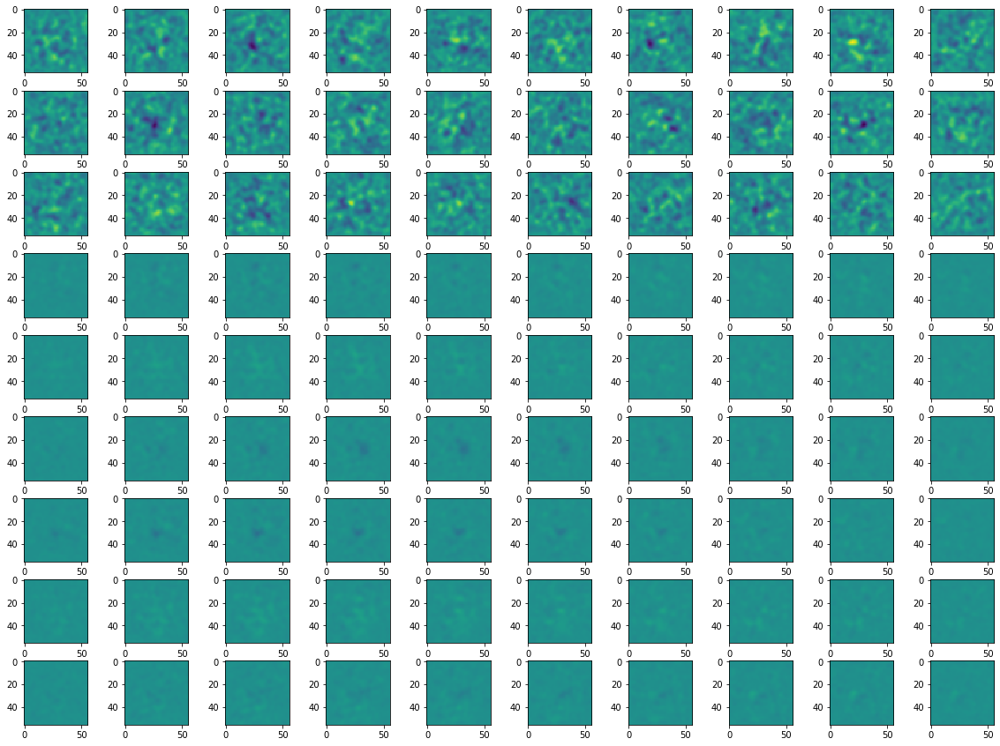

599.7421560287476 sec elapsed fitting GQM
759.1689865589142 sec elapsed fitting everything
Output set to 1 cells
Cell  19:  d2x -R0   LLs = 0.000759124755859375
Cell  19:  d2t -R6   LL = 0.00076 -> 0.00099
Cell  19:  Gloc-R5   LL = 0.00076 -> 0.00194
Cell  19:  L1  -R1   LL = 0.00076 -> 0.00199


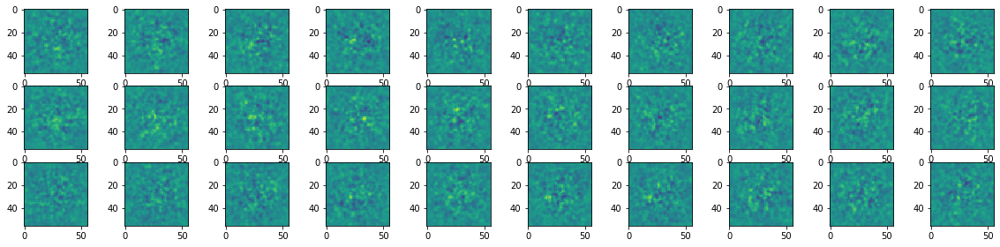

141.17330193519592 sec elapsed fitting GLM
Cell  19:  glm+abs   LL = 0.00076 -> 0.00285


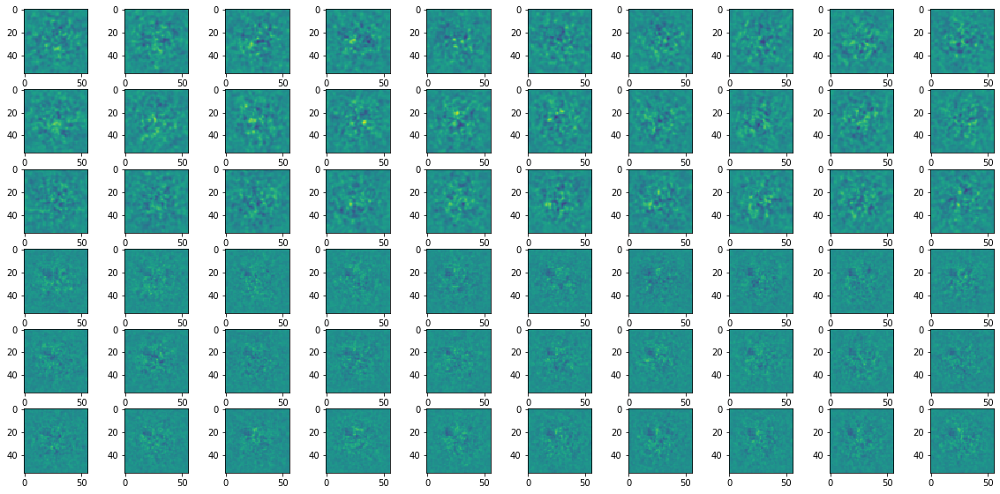

Cell  19:  fitting: 21.73759
Cell  19:  fitting: 21.68014
Cell  19:  fitting: 21.66030
Cell  19:  fitting: 21.65386
Cell  19:  fitting: 21.66478
Cell  19:  fitting: 21.69762
Cell  19:  fitting: 21.70988
Cell  19:  fitting: 21.68865
[4.1613369  4.16784906 4.16778708 4.16769361 4.16778421 4.16673565
 4.16538906 4.16756964]
Cell  19:  d2x -R0   LL = 0.00194 -> 0.00796
[4.16257763 4.16270351 4.1626358  4.16269875 4.16264915 4.16252279
 4.16429281 4.16768026]
Cell  19:  d2t -R5   LL = 0.00194 -> 0.00678
[7.84693003 7.59988308 6.79488897 4.3499589  4.16269875 4.16603184
 4.16686296]
Cell  19:  Gloc-R4   LL = 0.00194 -> 0.00660
[4.16259336 4.16238022 4.16224718 4.16269875 4.16096973 4.16541862
 4.16579771 4.16688824]
Cell  19:  L1  -R4   LL = 0.00194 -> 0.00833


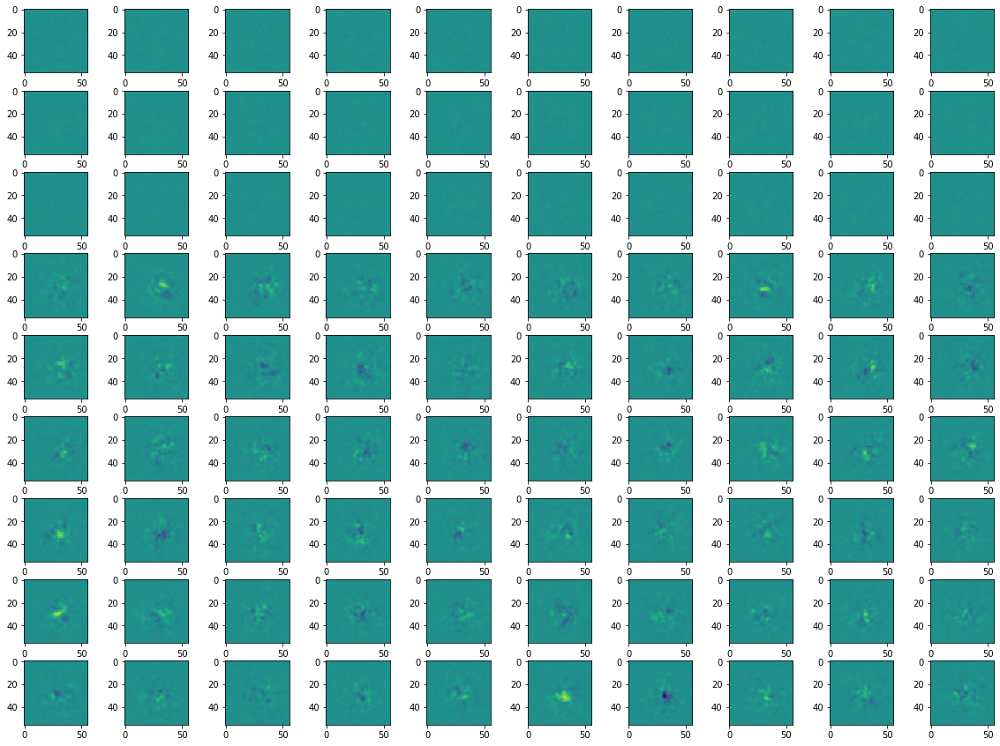

649.9662930965424 sec elapsed fitting GQM
791.1395950317383 sec elapsed fitting everything
Output set to 1 cells
Cell  20:  d2x -R7   LLs = -0.0007584095001220703
Cell  20:  d2t -R6   LL =-0.00076 -> 0.00155
Cell  20:  Gloc-R5   LL =-0.00076 -> 0.00202
Cell  20:  L1  -R4   LL =-0.00076 -> 0.00333


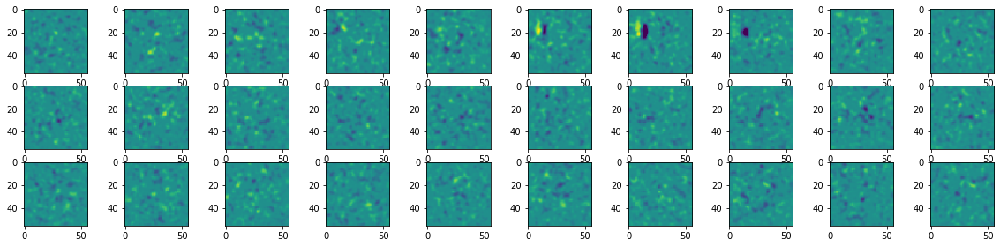

132.7363703250885 sec elapsed fitting GLM
Cell  20:  glm+abs   LL =-0.00076 -> 0.00290


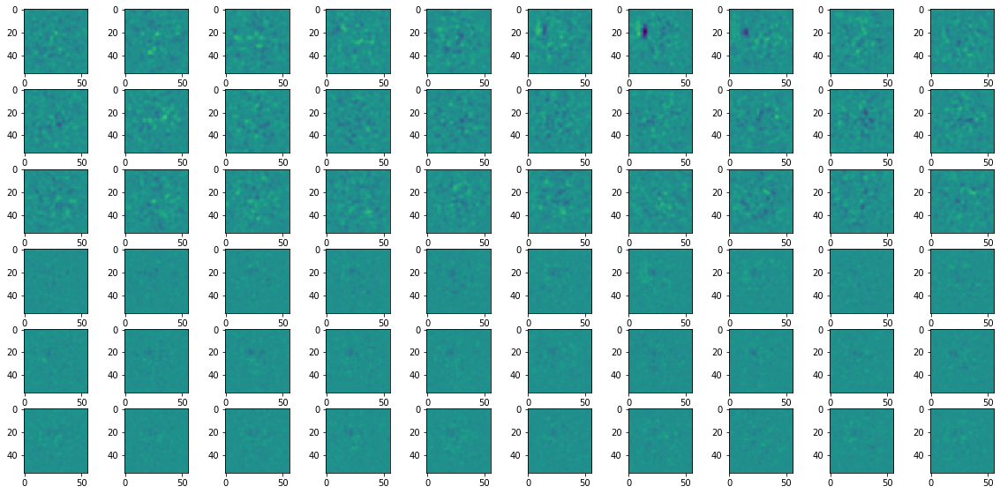

Cell  20:  fitting: 21.69565
Cell  20:  fitting: 21.70926
Cell  20:  fitting: 21.66263
Cell  20:  fitting: 21.68244
Cell  20:  fitting: 21.71453
Cell  20:  fitting: 21.71091
Cell  20:  fitting: 21.68179
Cell  20:  fitting: 21.69479
[3.56962919 3.57742548 3.5774622  3.57749176 3.57751989 3.57721448
 3.57693028 3.57411408]
Cell  20:  d2x -R0   LL = 0.00202 ->-0.00193
[3.57052684 3.57056427 3.57051897 3.5705514  3.57053423 3.57019901
 3.56850314 3.5653336 ]
Cell  20:  d2t -R7   LL = 0.00202 -> 0.00237
[5.36921072 5.07442856 4.46391392 3.61737251 3.56723881 3.56384444
 3.56383777]
Cell  20:  Gloc-R6   LL = 0.00202 -> 0.00386
[3.56371427 3.5637238  3.56372333 3.56371546 3.56368971 3.56374264
 3.56373286 3.56373215]
Cell  20:  L1  -R4   LL = 0.00202 -> 0.00401


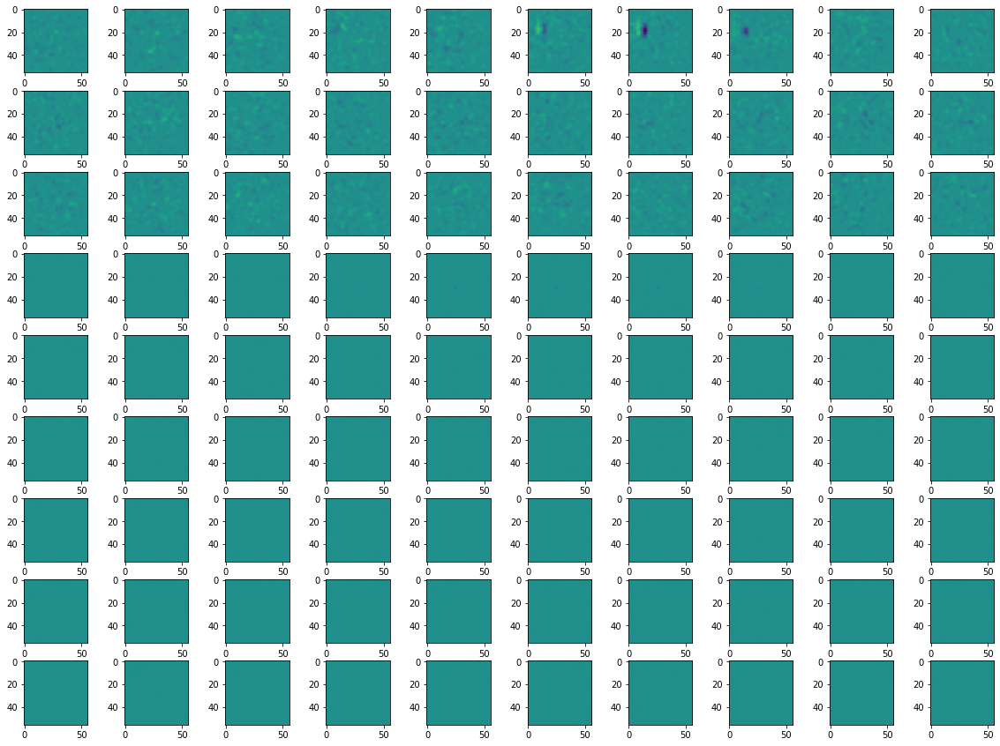

659.2699608802795 sec elapsed fitting GQM
792.006331205368 sec elapsed fitting everything


In [15]:
# now fit across all models
for cc in range(NCv):
    #cc=0
    t0=time()
    data.set_cells([valLP[cc]])

    # fit drift network
    drift_iter = NDN.NDN( 
        layer_list = [drift_pars1N], loss_type='poisson')
    drift_iter.block_sample=True
    drift_iter.networks[0].xstim_n = 'Xdrift'
    drift_iter.fit( data, force_dict_training=True, train_inds=None, **lbfgs_pars, verbose=0, version=1)
    LLsNULL[cc] = drift_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
    driftmods[cc] = deepcopy(drift_iter)

    # first fit GLM
    LLs = np.zeros(len(rvals))+1000
    for rr in range(len(rvals)):
        stim_net['layer_list'][0]['reg_vals']['d2x'] = rvals[rr]
        glm_iter = NDN.NDN(ffnet_list = [stim_net, drift_net, net_comb], loss_type='poisson')
        glm_iter.block_sample=True
        glm_iter.networks[1].layers[0].weight.data[:,0] = deepcopy(
            driftmods[cc].networks[0].layers[0].weight.data[:,0])
        glm_iter.networks[1].layers[0].set_parameters(val=False)
        glm_iter.networks[2].layers[0].set_parameters(val=False,name='weight')

        glm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
        LLi = glm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (rr == 0) or (LLi < np.min(LLs)):
            best_model = deepcopy(glm_iter)
        LLs[rr] = LLi

    bm1 = np.argmin(LLs)
    LLsR[cc,0] = LLs[bm1]
    XTopt[cc] = rvals[bm1]
    glms[cc] = deepcopy(best_model)
    print( "Cell %3d:  d2x -R%d   LLs ="%(cc, bm1), LLsNULL[cc]-LLsR[cc,0] )

    LLs = np.zeros(len(rvals))+LLsR[cc,0]
    for rr in range(len(rvals)):
        glm_iter = deepcopy(best_model)
        glm_iter.networks[0].layers[0].reg.vals['d2t'] = rvals[rr]
        glm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
        LLi = glm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (LLi < np.min(LLs)):
            best_model = deepcopy(glm_iter)
        LLs[rr] = LLi

    bm1b = np.argmin(LLs)
    LLsR[cc,1] = LLs[bm1b]
    GLopt[cc] = rvals[bm1b]
    glms[cc] = deepcopy(best_model)
    print( "Cell %3d:  d2t -R%d   LL =%8.5f ->%8.5f"%(cc, bm1b, LLsNULL[cc]-LLsR[cc,0], LLsNULL[cc]-LLsR[cc,1]) )

    LLs = np.zeros(len(rvalsG))+np.min(LLsR[cc,:2])
    for rr in range(len(rvalsG)):
        glm_iter = deepcopy(best_model)
        glm_iter.networks[0].layers[0].reg.vals['glocalx'] = rvalsG[rr]
        glm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
        LLi = glm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (LLi < np.min(LLs)):
            best_model = deepcopy(glm_iter)
        LLs[rr] = LLi

    bm2 = np.argmin(LLs)
    LLsR[cc,2] = LLs[bm2]
    GLopt[cc] = rvals[bm2]
    glms[cc] = deepcopy(best_model)
    print( "Cell %3d:  Gloc-R%d   LL =%8.5f ->%8.5f"%(cc, bm2, LLsNULL[cc]-LLsR[cc,0], LLsNULL[cc]-LLsR[cc,2]) )

    LLs = np.zeros(len(rvals))+np.min(LLsR[cc,:3])
    for rr in range(1,len(rvals)):
        glm_iter = deepcopy(best_model)
        glm_iter.networks[0].layers[0].reg.vals['l1'] = rvals[rr]
        glm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
        LLi = glm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (LLi < np.min(LLs)):
            best_model = deepcopy(glm_iter)
        LLs[rr] = LLi

    bm3 = np.argmin(LLs)
    LLsR[cc,3] = LLs[bm3]
    GLopt[cc] = rvals[bm3]
    glms[cc] = deepcopy(best_model)
    print( "Cell %3d:  L1  -R%d   LL =%8.5f ->%8.5f"%(cc, bm3, LLsNULL[cc]-LLsR[cc,0], LLsNULL[cc]-LLsR[cc,3]) )
    best_glm = deepcopy(best_model)

    # plot GLM filters
    w = best_model.get_weights()
    utils.subplot_setup(1,num_lags, row_height=4)
    for ll in range(num_lags):
        plt.subplot(3,num_lags,ll+1)
        utils.imagesc(w[0,:,:,ll,0], aspect=1, max=np.max(w))
        plt.subplot(3,num_lags,ll+1+num_lags)
        utils.imagesc(w[1,:,:,ll,0], aspect=1, max=np.max(w))
        plt.subplot(3,num_lags,ll+1+num_lags*2)
        utils.imagesc(w[2,:,:,ll,0], aspect=1, max=np.max(w))
    plt.show()

    t1 = time()
    print(t1-t0, 'sec elapsed fitting GLM')
    
    ## also fit GLM-abs?
    glm_abs = NDN.NDN(ffnet_list = [stim_net2, drift_net, net_comb], loss_type='poisson')
    glm_abs.block_sample=True
    glm_abs.networks[1].layers[0].weight.data[:,0] = deepcopy(
        driftmods[cc].networks[0].layers[0].weight.data[:,0])
    # also initialize with previous GLM filter?
    glm_abs.networks[2].layers[0].set_parameters(val=False,name='weight')
    glm_abs.networks[1].layers[0].set_parameters(val=False)
    glm_abs.networks[0].layers[0].reg.vals['d2x'] = rvals[bm1]
    glm_abs.networks[0].layers[0].reg.vals['d2t'] = rvals[bm1b]
    glm_abs.networks[0].layers[0].reg.vals['glocalx'] = rvalsG[bm2]
    glm_abs.networks[0].layers[0].reg.vals['l1'] = rvals[bm3]

    glm_abs.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
    LL_abs[cc] = glm_abs.eval_models(data[data.val_blks], null_adjusted=False)[0]
    glms_abs[cc] = deepcopy(glm_abs)
    print( "Cell %3d:  glm+abs   LL =%8.5f ->%8.5f"%(cc, LLsNULL[cc]-LLsR[cc,0], LLsNULL[cc]-LL_abs[cc]) )

    # plot glm_abs
    w2 = glms_abs[cc].get_weights()
    w2=w2.reshape([2,3,NXglm,NXglm,num_lags,1])
    maxlin = np.max(w2[0,:,:,:,:,:])
    maxabs = np.max(w2[1,:,:,:,:,:])
    maxall = np.max(abs(w2))
    utils.ss(2,num_lags, rh=4)
    for ll in range(num_lags):
        plt.subplot(6,num_lags,ll+1)
        utils.imagesc(w2[0,0,:,:,ll,0], aspect=1, max=maxall)
        plt.subplot(6,num_lags,ll+1+num_lags)
        utils.imagesc(w2[0,1,:,:,ll,0], aspect=1, max=maxall)
        plt.subplot(6,num_lags,ll+1+num_lags*2)
        utils.imagesc(w2[0,2,:,:,ll,0], aspect=1, max=maxall)
        plt.subplot(6,num_lags,ll+1+num_lags*3)
        utils.imagesc(w2[1,0,:,:,ll,0], aspect=1, max=maxall)
        plt.subplot(6,num_lags,ll+1+num_lags*4)
        utils.imagesc(w2[1,1,:,:,ll,0], aspect=1, max=maxall)
        plt.subplot(6,num_lags,ll+1+num_lags*5)
        utils.imagesc(w2[1,2,:,:,ll,0], aspect=1, max=maxall)
    plt.show()

    # now fit GQM
    LLs = np.zeros(len(rvals))+1000
    for rr in range(len(rvals)):
        tx0=time()
        gqm_iter = NDN.NDN(ffnet_list = [stim_net, drift_net, stim_qnet, net2_comb], loss_type='poisson')
        gqm_iter.block_sample=True
        gqm_iter.networks[3].layers[0].set_parameters(val=False,name='weight')
        gqm_iter.networks[1].layers[0].weight.data[:,0] = deepcopy(
            driftmods[cc].networks[0].layers[0].weight.data[:,0])
        gqm_iter.networks[1].layers[0].set_parameters(val=False)
        gqm_iter.networks[0].layers[0].weight.data[:,0] = deepcopy(
            best_glm.networks[0].layers[0].weight.data[:,0])
        gqm_iter.networks[0].layers[0].reg.vals['d2x'] = rvals[bm1]
        gqm_iter.networks[0].layers[0].reg.vals['d2t'] = rvals[bm1b]
        gqm_iter.networks[0].layers[0].reg.vals['glocalx'] = rvalsG[bm2]
        gqm_iter.networks[0].layers[0].reg.vals['l1'] = rvals[bm3]
        gqm_iter.networks[2].layers[0].reg.vals['d2x'] = rvals[rr]
        gqm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=6, version=10, verbose=0)
        LLi = gqm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        tx1=time()
        if (rr == 0) or (LLi < np.min(LLs)):
            best_gqm = deepcopy(gqm_iter)
        LLs[rr] = LLi
        print( "Cell %3d:  fitting: %8.5f"%(cc, tx1-tx0) )
       

    bmq1 = np.argmin(LLs)
    LLsQR[cc,1] = LLs[bmq1]
    XTopt[cc] = rvals[bmq1]
    gqms[cc] = deepcopy(best_gqm)
    print(LLs)
    print( "Cell %3d:  d2x -R%d   LL =%8.5f ->%8.5f"%(cc, bmq1, LLsNULL[cc]-LLsR[cc,2], LLsNULL[cc]-LLsQR[cc,1]) )

    LLs = np.zeros(len(rvals))+np.min(LLsQR[cc,:2])
    for rr in range(len(rvals)):
        gqm_iter = deepcopy(best_gqm)
        gqm_iter.networks[2].layers[0].reg.vals['d2t'] = rvals[rr]
        gqm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=6, version=10, verbose=0)
        LLi = gqm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (LLi < np.min(LLs)):
            best_gqm = deepcopy(gqm_iter)
        LLs[rr] = LLi
    bmq2 = np.argmin(LLs)
    LLsQR[cc,2] = LLs[bmq2]
    GLopt[cc] = rvals[bmq2]
    gqms[cc] = deepcopy(best_gqm)
    print(LLs)
    print( "Cell %3d:  d2t -R%d   LL =%8.5f ->%8.5f"%(cc, bmq2, LLsNULL[cc]-LLsR[cc,2], LLsNULL[cc]-LLsQR[cc,2]) )

    LLs = np.zeros(len(rvalsG))+np.min(LLsQR[cc,:3])
    for rr in range(len(rvalsG)):
        gqm_iter = deepcopy(best_gqm)
        gqm_iter.networks[2].layers[0].reg.vals['glocalx'] = rvalsG[rr]
        gqm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=6, version=10, verbose=0)
        LLi = gqm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (LLi < np.min(LLs)):
            best_gqm = deepcopy(gqm_iter)
        LLs[rr] = LLi
    bmq3 = np.argmin(LLs)
    LLsQR[cc,3] = LLs[bmq3]
    GLopt[cc] = rvals[bmq3]
    gqms[cc] = deepcopy(best_gqm)
    print(LLs)
    print( "Cell %3d:  Gloc-R%d   LL =%8.5f ->%8.5f"%(cc, bmq3, LLsNULL[cc]-LLsR[cc,2], LLsNULL[cc]-LLsQR[cc,3]) )

    LLs = np.zeros(len(rvals))+np.min(LLsQR[cc,:4])
    for rr in range(len(rvals)):
        gqm_iter = deepcopy(best_gqm)
        gqm_iter.networks[2].layers[0].reg.vals['l1'] = rvals[rr]
        gqm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=6, version=10, verbose=0)
        LLi = gqm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (LLi < np.min(LLs)):
            best_gqm = deepcopy(gqm_iter)
        LLs[rr] = LLi
    bmq4 = np.argmin(LLs)
    LLsQR[cc,4] = LLs[bmq4]
    GLopt[cc] = rvals[bmq4]
    gqms[cc] = deepcopy(best_gqm)
    print(LLs)
    print( "Cell %3d:  L1  -R%d   LL =%8.5f ->%8.5f"%(cc, bmq4, LLsNULL[cc]-LLsR[cc,2], LLsNULL[cc]-LLsQR[cc,4]) )

    best_gqm = deepcopy(best_gqm)

    w2 = best_gqm.get_weights(ffnet_target=0)
    w2=w2.reshape([3,NXglm,NXglm,num_lags])

    w3 = best_gqm.get_weights(ffnet_target=2)
    w3=w3.reshape([3,NXglm,NXglm,num_lags,num_subs])

    maxall = np.max([np.max(abs(w3)), np.max(abs(w2))])
    utils.ss(3,num_lags, rh=4)
    for ll in range( num_lags):
        plt.subplot(9,num_lags,ll+1)
        utils.imagesc(w2[0,:,:,ll], aspect=1, max=maxall)
        plt.subplot(9,num_lags,ll+1+num_lags)
        utils.imagesc(w2[1,:,:,ll], aspect=1, max=maxall)
        plt.subplot(9,num_lags,ll+1+num_lags*2)
        utils.imagesc(w2[2,:,:,ll], aspect=1, max=maxall)
        for subs in range(num_subs):
            plt.subplot(9,num_lags,ll+1+num_lags*3+(subs*num_lags*3))
            utils.imagesc(w3[0,:,:,ll,subs], aspect=1, max=maxall)

            plt.subplot(9,num_lags,ll+1+num_lags*4+(subs*num_lags*3))
            utils.imagesc(w3[1,:,:,ll,subs], aspect=1, max=maxall)

            plt.subplot(9,num_lags,ll+1+num_lags*5+(subs*num_lags*3))
            utils.imagesc(w3[2,:,:,ll,subs], aspect=1, max=maxall)
    plt.show()
    
    t2 = time()
    print(t2-t1, 'sec elapsed fitting GQM')
    print(t2-t0, 'sec elapsed fitting everything')

In [16]:
# extract measures across cells
complex_scores = np.zeros(NCv)
lin_corrs = np.zeros(NCv)
quad_corrs = np.zeros(NCv)
filtwsmat = np.zeros([NCv,3])

for cc in range(NCv):
    filtwsmat[cc,:]=RU.GQM_filtws(gqms[cc], data, valLP[cc], 0, 2 )
    complex_scores[cc], lin_corrs[cc], quad_corrs[cc] = RU.GQM_complexity(gqms[cc], data, valLP[cc], 0, 2 )


In [17]:
glm_ks = np.zeros([NCv, 3, NXglm, NXglm, num_lags]) 
glm_abs_ks = np.zeros([NCv, 6, NXglm, NXglm, num_lags]) 
gqm_ksl = np.zeros([NCv,3, NXglm, NXglm, num_lags])
gqm_ksq = np.zeros([NCv,3, NXglm, NXglm, num_lags,num_subs])

LLsGLM = LLsNULL-np.min(LLsR,axis=1)
LLsGLMabs = LLsNULL-LL_abs
LLsGQM = LLsNULL-np.min(LLsQR,axis=1)

for cc in range(NCv):
    glm_ks[cc,:,:,:,:] = glms[cc].get_weights().squeeze()
    glm_abs_ks[cc,:,:,:,:] = glms_abs[cc].get_weights().squeeze()
    gqm_ksl[cc,:,:,:,:] = gqms[cc].get_weights(ffnet_target=0).squeeze()
    gqm_ksq[cc,:,:,:,:,:] = gqms[cc].get_weights(ffnet_target=2).squeeze()
    
sio.savemat(analdir+PROOT+'_LP_GQM_measures.mat', {
    'glm_ks':glm_ks, 'glm_abs_ks':glm_abs_ks, 'gqm_ksl':gqm_ksl, 'gqm_ksq':gqm_ksq,
    'valLP':valLP, 'LLsGLM':LLsGLM[:, None],'LLsGLMabs':LLsGLMabs[:, None], 'LLsGQM':LLsGQM[:, None],
    'lin_corrs':lin_corrs, 'quad_corrs':quad_corrs, 'complex_scores':complex_scores, 'filtws_gqm':filtwsmat})

In [18]:
# Assemble population drift terms
w0 = driftmods[0].get_weights()
NA = w0.shape[0]
drift_terms = np.zeros([NA, NCv])
for cc in range(NCv):
    drift_terms[:, cc] = deepcopy(driftmods[cc].get_weights())[:,0]

# Assemble drift population model
drift_pars_pop = NDNLayer.layer_dict( 
    input_dims=[1,1,1,NA], num_filters=NCv, bias=False, norm_type=0, NLtype='softplus')
drift_pars_pop['reg_vals'] = {'d2t': Dreg, 'bcs':{'d2t':0} } 
drift_pop = NDN.NDN( layer_list = [drift_pars_pop], loss_type='poisson')
drift_pop.block_sample=True
drift_pop.networks[0].xstim_n = 'Xdrift'
drift_pop.networks[0].layers[0].weight.data = torch.tensor(drift_terms, dtype=torch.float32)
data.cells_out = list(valLP)
LLsCHECK = drift_pop.eval_models(data[data.val_blks], null_adjusted=False) 
print(np.mean(LLsNULL), np.mean(LLsCHECK))

3.387926975886027 5.4233766


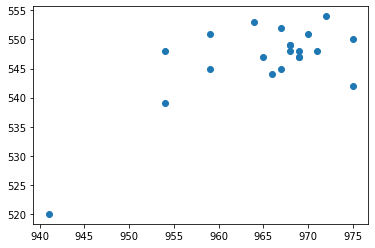

In [19]:
# Get array centers
RFcenters = np.zeros([NCv,2], dtype=np.int64) - 1
RFcols = np.zeros([NCv,1], dtype=np.int64) - 1
for cc in range(NCv):
    k = glms[cc].get_weights()
    pfilt = np.sum(np.std(k, axis=3),axis=0).squeeze() # for colorRFs
    x,y = utils.max_multiD( pfilt )
    RFcenters[cc, :] = [x,y]

RFcenters[:,0] = RFcenters[:,0] + top_corner[0]
RFcenters[:,1] = RFcenters[:,1] + top_corner[1]
plt.plot(RFcenters[:, 0], RFcenters[:, 1],'o')
plt.show()

### now save

In [20]:
LLsGLM = LLsNULL-np.min(LLsR,axis=1)
LLsGLMabs = LLsNULL-np.min(LLsR,axis=1)
LLsGQM = LLsNULL-np.min(LLsQR,axis=1)
sio.savemat(datadir2+PROOT+'_LP_GQM_info.mat', {
    'LLsNULL':LLsNULL[:,None], 'LLsGLM':LLsGLM[:, None], 'LLsGLMabs':LLsGLMabs[:, None], 'LLsGQM':LLsGQM[:, None],
    'drift_terms': drift_terms, 'Dreg': Dreg, 'valLP':valLP, 'NX':UNX,
    'RFcenters': RFcenters, 'top_corner': top_corner[:, None]})
sio.savemat(datadir2+PROOT+'_LP_stimpos.mat', {
    'LLsNULL':LLsNULL[:,None], 'LLsGLM':LLsGLM[:, None], 'LLsGQM':LLsGQM[:, None],
    'drift_terms': drift_terms, 'Dreg': Dreg, 'valLP':valLP, 'NX':UNX,
    'RFcenters': RFcenters, 'top_corner': top_corner[:, None], 'source':'gqms'})
drift_pop.save_model(filename=moddir+'LP_drift_pop.pkl')

for cc in range(NCv):
    glms[cc].save_model(filename=moddir+'LP' + utils.filename_num2str(cc, num_digits=3) + 'glmwET.pkl')
    glms_abs[cc].save_model(filename=moddir+'LP' + utils.filename_num2str(cc, num_digits=3) + 'glm2wET.pkl')
    gqms[cc].save_model(filename=moddir+'LP' + utils.filename_num2str(cc, num_digits=3) + 'gqmwET.pkl')


  Saving model at /Data/FelixData/Conway/proc/J220718/models/LP_drift_pop.pkl
  Saving model at /Data/FelixData/Conway/proc/J220718/models/LP000glmwET.pkl
  Saving model at /Data/FelixData/Conway/proc/J220718/models/LP000glm2wET.pkl
  Saving model at /Data/FelixData/Conway/proc/J220718/models/LP000gqmwET.pkl
  Saving model at /Data/FelixData/Conway/proc/J220718/models/LP001glmwET.pkl
  Saving model at /Data/FelixData/Conway/proc/J220718/models/LP001glm2wET.pkl
  Saving model at /Data/FelixData/Conway/proc/J220718/models/LP001gqmwET.pkl
  Saving model at /Data/FelixData/Conway/proc/J220718/models/LP002glmwET.pkl
  Saving model at /Data/FelixData/Conway/proc/J220718/models/LP002glm2wET.pkl
  Saving model at /Data/FelixData/Conway/proc/J220718/models/LP002gqmwET.pkl
  Saving model at /Data/FelixData/Conway/proc/J220718/models/LP003glmwET.pkl
  Saving model at /Data/FelixData/Conway/proc/J220718/models/LP003glm2wET.pkl
  Saving model at /Data/FelixData/Conway/proc/J220718/models/LP003gqmwE

In [21]:
crash

NameError: name 'crash' is not defined

## Now fit Utah array models again to check ET

In [ ]:
UTloc = np.array([927, 518], dtype=np.int64)
NCv=NCUT

data.assemble_stimulus(top_corner=UTloc, fixdot=0, L=UNX, time_embed=0, shifts=-fixshifts)
Reff = torch.mul(data.robs[:, valUT], data.dfs[:, valUT])
nspks = torch.sum(Reff, axis=0)

data.draw_stim_locations( top_corner=UTloc, L=UNX)

In [ ]:
## Calculate STAS
#Reff = np.multiply(data.robs, data.dfs)
#nspks = np.sum(Reff, axis=0)

lag = 4
stasC = ((data.stim[:-lag, ...].T @ Reff[lag:,:]).squeeze() / nspks).reshape([3, UNX,UNX,-1]).numpy()
stasC.shape

In [ ]:
ctext = ['Lum', 'L-M', 'S']
Nrows=int(np.ceil(NCv/2))
ss(Nrows, 6, rh=2)
for cc in range(NCUT):
    for clr in range(3):
        plt.subplot(Nrows, 6, 3*cc+clr+1)
        imagesc(stasC[clr, :, :, cc])
        if clr == 0:
            plt.ylabel( "Cell %d"%cc)
        plt.title(ctext[clr])

In [ ]:
NXglm = UNX
#num_lags = 8

LLs0, LLsGLM, XTopt, GLopt = np.zeros([NCv,2]), np.zeros(NCv), np.zeros(NCv), np.zeros(NCv)
glms = [None]*NCv
driftmods = [None]*NCv
Dreg = 0.1

lbfgs_pars = utils.create_optimizer_params(
    optimizer_type='lbfgs',
    tolerance_change=1e-10,
    tolerance_grad=1e-10,
    batch_size=16000,
    max_epochs=3,
    max_iter = 200)
#lbfgs_pars['num_workers'] = 0

In [ ]:
#set up fits
Xreg = 10 # [20]
Treg = 1 # [20]
L1reg = 1 # [0.5]
GLreg = 10.0 # [4.0]

# drift network
drift_pars1 = NDNLayer.layer_dict( 
    input_dims=[1,1,1,NA], num_filters=1, bias=False, norm_type=0, NLtype='lin')
drift_pars1['reg_vals'] = {'d2t': Dreg, 'bcs':{'d2t':0} } 
# for stand-alone drift model
drift_pars1N = deepcopy(drift_pars1)
drift_pars1N['NLtype'] = 'softplus'
drift_net =  FFnetwork.ffnet_dict( xstim_n = 'Xdrift', layer_list = [drift_pars1] )

# glm net
glm_layer = Tlayer.layer_dict( 
    input_dims=[3,NXglm,NXglm,1], num_filters=1, bias=False, num_lags=num_lags,
    NLtype='lin', initialize_center = True)
glm_layer['reg_vals'] = {'d2x': Xreg, 'd2t': Treg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':10} 
stim_net =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [glm_layer] )

# abs layer
glm2_layer = OnOffLayer.layer_dict( 
    input_dims=[3,NXglm,NXglm,1], num_filters=1, bias=False, num_lags=num_lags,
    NLtype='lin', initialize_center = True)
stim_net2 =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [glm2_layer] )

# gqm net
num_subs = 2
gqm_layer = Tlayer.layer_dict( 
    input_dims=[3,NXglm,NXglm,1], num_filters=num_subs, num_inh=0, bias=False, num_lags=num_lags,
    NLtype='square', initialize_center = True)
gqm_layer['reg_vals'] = {'d2x': Xreg, 'd2t': Treg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':10} 
stim_qnet =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [gqm_layer] )

#combine glm
comb_layer = NDNLayer.layer_dict(
    num_filters = 1, NLtype='softplus', bias=False)
comb_layer['weights_initializer'] = 'ones'

net_comb = FFnetwork.ffnet_dict( 
    xstim_n = None, ffnet_n=[0,1],
    layer_list = [comb_layer], ffnet_type='add')

#combine gqm
comb2_layer = ChannelLayer.layer_dict( 
    num_filters = 1, NLtype='softplus', bias=False)
comb2_layer['weights_initializer'] = 'ones'

net2_comb = FFnetwork.ffnet_dict( 
    xstim_n = None, ffnet_n=[0,1,2],
    layer_list = [comb2_layer], ffnet_type='normal')
net2_comb['layer_list'][0]['bias'] = True

glms = [None]*NCv
glms_abs = [None]*NCv
gqms = [None]*NCv
driftmods = [None]*NCv
XTopt = np.zeros(NCv) 
GLopt = np.zeros(NCv) 
LLsNULL = np.zeros(NCv)
LLsR = np.zeros([NCv,4])+1000
LL_abs = np.zeros(NCv)
LLsQR = np.zeros([NCv,5])+1000

rvals = [0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000]
rvalsG = [0, 0.001, 0.01, 1, 10, 100, 1000] # glocal

# set up stimulus
data.assemble_stimulus(top_corner=UTloc, fixdot=0, L=NXglm, time_embed=0, num_lags=num_lags, shifts=-fixshifts )
    
# for fit model with abs values as well
#new_stim = torch.zeros([NT, 2, 3*UNX*UNX])
#new_stim[:,0,:] = deepcopy(data.stim)
#new_stim[:,1,:] = deepcopy(abs(data.stim))
#data.add_covariate('stim2', new_stim.reshape([NT, -1]))

In [ ]:
# now fit across all models
for cc in range(NCv):
    #cc=9
    data.set_cells([valUT[cc]])

    # fit drift network
    drift_iter = NDN.NDN( 
        layer_list = [drift_pars1N], loss_type='poisson')
    drift_iter.block_sample=True
    drift_iter.networks[0].xstim_n = 'Xdrift'
    drift_iter.fit( data, force_dict_training=True, train_inds=None, **lbfgs_pars, verbose=0, version=1)
    LLsNULL[cc] = drift_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
    driftmods[cc] = deepcopy(drift_iter)

    # first fit GLM
    LLs = np.zeros(len(rvals))+1000
    for rr in range(len(rvals)):
        stim_net['layer_list'][0]['reg_vals']['d2x'] = rvals[rr]
        glm_iter = NDN.NDN(ffnet_list = [stim_net, drift_net, net_comb], loss_type='poisson')
        glm_iter.block_sample=True
        glm_iter.networks[1].layers[0].weight.data[:,0] = deepcopy(
            driftmods[cc].networks[0].layers[0].weight.data[:,0])
        glm_iter.networks[1].layers[0].set_parameters(val=False)
        glm_iter.networks[2].layers[0].set_parameters(val=False,name='weight')

        glm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
        LLi = glm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (rr == 0) or (LLi < np.min(LLs)):
            best_model = deepcopy(glm_iter)
        LLs[rr] = LLi

    bm1 = np.argmin(LLs)
    LLsR[cc,0] = LLs[bm1]
    XTopt[cc] = rvals[bm1]
    glms[cc] = deepcopy(best_model)
    print( "Cell %3d:  d2x -R%d   LLs ="%(cc, bm1), LLsNULL[cc]-LLsR[cc,0] )

    LLs = np.zeros(len(rvals))+LLsR[cc,0]
    for rr in range(len(rvals)):
        glm_iter = deepcopy(best_model)
        glm_iter.networks[0].layers[0].reg.vals['d2t'] = rvals[rr]
        glm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
        LLi = glm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (LLi < np.min(LLs)):
            best_model = deepcopy(glm_iter)
        LLs[rr] = LLi

    bm1b = np.argmin(LLs)
    LLsR[cc,1] = LLs[bm1b]
    GLopt[cc] = rvals[bm1b]
    glms[cc] = deepcopy(best_model)
    print( "Cell %3d:  d2t -R%d   LL =%8.5f ->%8.5f"%(cc, bm1b, LLsNULL[cc]-LLsR[cc,0], LLsNULL[cc]-LLsR[cc,1]) )

    LLs = np.zeros(len(rvalsG))+np.min(LLsR[cc,:2])
    for rr in range(len(rvalsG)):
        glm_iter = deepcopy(best_model)
        glm_iter.networks[0].layers[0].reg.vals['glocalx'] = rvalsG[rr]
        glm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
        LLi = glm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (LLi < np.min(LLs)):
            best_model = deepcopy(glm_iter)
        LLs[rr] = LLi

    bm2 = np.argmin(LLs)
    LLsR[cc,2] = LLs[bm2]
    GLopt[cc] = rvals[bm2]
    glms[cc] = deepcopy(best_model)
    print( "Cell %3d:  Gloc-R%d   LL =%8.5f ->%8.5f"%(cc, bm2, LLsNULL[cc]-LLsR[cc,0], LLsNULL[cc]-LLsR[cc,2]) )

    LLs = np.zeros(len(rvals))+np.min(LLsR[cc,:3])
    for rr in range(1,len(rvals)):
        glm_iter = deepcopy(best_model)
        glm_iter.networks[0].layers[0].reg.vals['l1'] = rvals[rr]
        glm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
        LLi = glm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (LLi < np.min(LLs)):
            best_model = deepcopy(glm_iter)
        LLs[rr] = LLi

    bm3 = np.argmin(LLs)
    LLsR[cc,3] = LLs[bm3]
    GLopt[cc] = rvals[bm3]
    glms[cc] = deepcopy(best_model)
    print( "Cell %3d:  L1  -R%d   LL =%8.5f ->%8.5f"%(cc, bm3, LLsNULL[cc]-LLsR[cc,0], LLsNULL[cc]-LLsR[cc,3]) )
    best_glm = deepcopy(best_model)

    # plot GLM filters
    w = best_model.get_weights()
    utils.subplot_setup(1,num_lags, row_height=4)
    for ll in range(num_lags):
        plt.subplot(3,num_lags,ll+1)
        utils.imagesc(w[0,:,:,ll,0], aspect=1, max=np.max(w))
        plt.subplot(3,num_lags,ll+1+num_lags)
        utils.imagesc(w[1,:,:,ll,0], aspect=1, max=np.max(w))
        plt.subplot(3,num_lags,ll+1+num_lags*2)
        utils.imagesc(w[2,:,:,ll,0], aspect=1, max=np.max(w))
    plt.show()

    ## also fit GLM-abs?
    glm_abs = NDN.NDN(ffnet_list = [stim_net2, drift_net, net_comb], loss_type='poisson')
    glm_abs.block_sample=True
    glm_abs.networks[1].layers[0].weight.data[:,0] = deepcopy(
        driftmods[cc].networks[0].layers[0].weight.data[:,0])
    # also initialize with previous GLM filter?
    glm_abs.networks[2].layers[0].set_parameters(val=False,name='weight')
    glm_abs.networks[1].layers[0].set_parameters(val=False)
    glm_abs.networks[0].layers[0].reg.vals['d2x'] = rvals[bm1]
    glm_abs.networks[0].layers[0].reg.vals['d2t'] = rvals[bm1b]
    glm_abs.networks[0].layers[0].reg.vals['glocalx'] = rvalsG[bm2]
    glm_abs.networks[0].layers[0].reg.vals['l1'] = rvals[bm3]

    glm_abs.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
    LL_abs[cc] = glm_abs.eval_models(data[data.val_blks], null_adjusted=False)[0]
    glms_abs[cc] = deepcopy(glm_abs)
    print( "Cell %3d:  glm+abs   LL =%8.5f ->%8.5f"%(cc, LLsNULL[cc]-LLsR[cc,0], LLsNULL[cc]-LL_abs[cc]) )

    # plot glm_abs
    w2 = glms_abs[cc].get_weights()
    w2=w2.reshape([2,3,NXglm,NXglm,num_lags,1])

    maxlin = np.max(w2[0,:,:,:,:,:])
    maxabs = np.max(w2[1,:,:,:,:,:])
    maxall = np.max(abs(w2))
    utils.ss(2,10, rh=4)
    for ll in range(10):
        plt.subplot(6,10,ll+1)
        utils.imagesc(w2[0,0,:,:,ll,0], aspect=1, max=maxall)

        plt.subplot(6,10,ll+11)
        utils.imagesc(w2[0,1,:,:,ll,0], aspect=1, max=maxall)

        plt.subplot(6,10,ll+21)
        utils.imagesc(w2[0,2,:,:,ll,0], aspect=1, max=maxall)

        plt.subplot(6,10,ll+31)
        utils.imagesc(w2[1,0,:,:,ll,0], aspect=1, max=maxall)

        plt.subplot(6,10,ll+41)
        utils.imagesc(w2[1,1,:,:,ll,0], aspect=1, max=maxall)

        plt.subplot(6,10,ll+51)
        utils.imagesc(w2[1,2,:,:,ll,0], aspect=1, max=maxall)

    plt.show()

    # now fit GQM
    LLs = np.zeros(len(rvals))+1000
    for rr in range(len(rvals)):
        gqm_iter = NDN.NDN(ffnet_list = [stim_net, drift_net, stim_qnet, net2_comb], loss_type='poisson')
        gqm_iter.block_sample=True
        gqm_iter.networks[3].layers[0].set_parameters(val=False,name='weight')
        gqm_iter.networks[1].layers[0].weight.data[:,0] = deepcopy(
            driftmods[cc].networks[0].layers[0].weight.data[:,0])
        gqm_iter.networks[1].layers[0].set_parameters(val=False)
        gqm_iter.networks[0].layers[0].weight.data[:,0] = deepcopy(
            best_glm.networks[0].layers[0].weight.data[:,0])
        gqm_iter.networks[0].layers[0].reg.vals['d2x'] = rvals[bm1]
        gqm_iter.networks[0].layers[0].reg.vals['d2t'] = rvals[bm1b]
        gqm_iter.networks[0].layers[0].reg.vals['glocalx'] = rvalsG[bm2]
        gqm_iter.networks[0].layers[0].reg.vals['l1'] = rvals[bm3]

        gqm_iter.networks[2].layers[0].reg.vals['d2x'] = rvals[rr]
        gqm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
        LLi = gqm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (rr == 0) or (LLi < np.min(LLs)):
            best_gqm = deepcopy(gqm_iter)
        LLs[rr] = LLi

    bmq1 = np.argmin(LLs)
    LLsQR[cc,1] = LLs[bmq1]
    XTopt[cc] = rvals[bmq1]
    gqms[cc] = deepcopy(best_gqm)
#    print(LLs)
    print( "Cell %3d:  d2x -R%d   LL =%8.5f ->%8.5f"%(cc, bmq1, LLsNULL[cc]-LLsR[cc,2], LLsNULL[cc]-LLsQR[cc,1]) )

    LLs = np.zeros(len(rvals))+np.min(LLsQR[cc,:2])
    for rr in range(len(rvals)):
        gqm_iter = deepcopy(best_gqm)
        gqm_iter.networks[2].layers[0].reg.vals['d2t'] = rvals[rr]
        gqm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
        LLi = gqm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (LLi < np.min(LLs)):
            best_gqm = deepcopy(gqm_iter)
        LLs[rr] = LLi
    bmq2 = np.argmin(LLs)
    LLsQR[cc,2] = LLs[bmq2]
    GLopt[cc] = rvals[bmq2]
    gqms[cc] = deepcopy(best_gqm)
#    print(LLs)
    print( "Cell %3d:  d2t -R%d   LL =%8.5f ->%8.5f"%(cc, bmq2, LLsNULL[cc]-LLsR[cc,2], LLsNULL[cc]-LLsQR[cc,2]) )

    LLs = np.zeros(len(rvalsG))+np.min(LLsQR[cc,:3])
    for rr in range(len(rvalsG)):
        gqm_iter = deepcopy(best_gqm)
        gqm_iter.networks[2].layers[0].reg.vals['glocalx'] = rvalsG[rr]
        gqm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
        LLi = gqm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (LLi < np.min(LLs)):
            best_gqm = deepcopy(gqm_iter)
        LLs[rr] = LLi
    bmq3 = np.argmin(LLs)
    LLsQR[cc,3] = LLs[bmq3]
    GLopt[cc] = rvals[bmq3]
    gqms[cc] = deepcopy(best_gqm)
#    print(LLs)
    print( "Cell %3d:  Gloc-R%d   LL =%8.5f ->%8.5f"%(cc, bmq3, LLsNULL[cc]-LLsR[cc,2], LLsNULL[cc]-LLsQR[cc,3]) )

    LLs = np.zeros(len(rvals))+np.min(LLsQR[cc,:4])
    for rr in range(len(rvals)):
        gqm_iter = deepcopy(best_gqm)
        gqm_iter.networks[2].layers[0].reg.vals['l1'] = rvals[rr]
        gqm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
        LLi = gqm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (LLi < np.min(LLs)):
            best_gqm = deepcopy(gqm_iter)
        LLs[rr] = LLi
    bmq4 = np.argmin(LLs)
    LLsQR[cc,4] = LLs[bmq4]
    GLopt[cc] = rvals[bmq4]
    gqms[cc] = deepcopy(best_gqm)
#    print(LLs)
    print( "Cell %3d:  L1  -R%d   LL =%8.5f ->%8.5f"%(cc, bmq4, LLsNULL[cc]-LLsR[cc,2], LLsNULL[cc]-LLsQR[cc,4]) )

    best_gqm = deepcopy(best_gqm)

    w2 = best_gqm.get_weights(ffnet_target=0)
    w2=w2.reshape([3,NXglm,NXglm,num_lags])

    w3 = best_gqm.get_weights(ffnet_target=2)
    w3=w3.reshape([3,NXglm,NXglm,num_lags,num_subs])

    maxall = np.max([np.max(abs(w3)), np.max(abs(w2))])
    utils.ss(3,num_lags, rh=4)
    for ll in range( num_lags):
        plt.subplot(9,num_lags,ll+1)
        utils.imagesc(w2[0,:,:,ll], aspect=1, max=maxall)
        plt.subplot(9,num_lags,ll+1+num_lags)
        utils.imagesc(w2[1,:,:,ll], aspect=1, max=maxall)
        plt.subplot(9,num_lags,ll+1+num_lags*2)
        utils.imagesc(w2[2,:,:,ll], aspect=1, max=maxall)
        for subs in range(num_subs):
            plt.subplot(9,num_lags,ll+1+num_lags*3+(subs*num_lags*3))
            utils.imagesc(w3[0,:,:,ll,subs], aspect=1, max=maxall)

            plt.subplot(9,num_lags,ll+1+num_lags*4+(subs*num_lags*3))
            utils.imagesc(w3[1,:,:,ll,subs], aspect=1, max=maxall)

            plt.subplot(9,num_lags,ll+1+num_lags*5+(subs*num_lags*3))
            utils.imagesc(w3[2,:,:,ll,subs], aspect=1, max=maxall)

    plt.show()

In [ ]:
# extract measures across cells
complex_scores = np.zeros(NCv)
lin_corrs = np.zeros(NCv)
quad_corrs = np.zeros(NCv)
filtwsmat = np.zeros([NCv,3])

for cc in range(NCv):
    filtwsmat[cc,:]=RU.GQM_filtws(gqms[cc], data, valUT[cc], 0, 2 )
    complex_scores[cc], lin_corrs[cc], quad_corrs[cc] = RU.GQM_complexity(gqms[cc], data, valUT[cc], 0, 2 )


In [ ]:
print("test")

In [ ]:
glm_ks = np.zeros([NCv, 3, NXglm, NXglm, num_lags]) 
glm_abs_ks = np.zeros([NCv, 6, NXglm, NXglm, num_lags]) 
gqm_ksl = np.zeros([NCv,3, NXglm, NXglm, num_lags])
gqm_ksq = np.zeros([NCv,3, NXglm, NXglm, num_lags,num_subs])

LLsGLM = LLsNULL-np.min(LLsR,axis=1)
LLsGLMabs = LLsNULL-LL_abs
LLsGQM = LLsNULL-np.min(LLsQR,axis=1)

for cc in range(NCv):
    glm_ks[cc,:,:,:,:] = glms[cc].get_weights().squeeze()
    glm_abs_ks[cc,:,:,:,:] = glms_abs[cc].get_weights().squeeze()
    gqm_ksl[cc,:,:,:,:] = gqms[cc].get_weights(ffnet_target=0).squeeze()
    gqm_ksq[cc,:,:,:,:,:] = gqms[cc].get_weights(ffnet_target=2).squeeze()
    
sio.savemat(analdir+PROOT+'_UT_GQM_measures.mat', {
    'glm_ks':glm_ks, 'glm_abs_ks':glm_abs_ks, 'gqm_ksl':gqm_ksl, 'gqm_ksq':gqm_ksq,
    'valUT':valUT, 'LLsGLM':LLsGLM[:, None],'LLsGLMabs':LLsGLMabs[:, None], 'LLsGQM':LLsGQM[:, None],
    'lin_corrs':lin_corrs, 'quad_corrs':quad_corrs, 'complex_scores':complex_scores, 'filtws_gqm':filtwsmat})

In [ ]:
# Assemble population drift terms
w0 = driftmods[0].get_weights()
NA = w0.shape[0]
drift_terms = np.zeros([NA, NCv])
for cc in range(NCv):
    drift_terms[:, cc] = deepcopy(driftmods[cc].get_weights())[:,0]

# Assemble drift population model
drift_pars_pop = NDNLayer.layer_dict( 
    input_dims=[1,1,1,NA], num_filters=NCv, bias=False, norm_type=0, NLtype='softplus')
drift_pars_pop['reg_vals'] = {'d2t': Dreg, 'bcs':{'d2t':0} } 
drift_pop = NDN.NDN( layer_list = [drift_pars_pop], loss_type='poisson')
drift_pop.block_sample=True
drift_pop.networks[0].xstim_n = 'Xdrift'
drift_pop.networks[0].layers[0].weight.data = torch.tensor(drift_terms, dtype=torch.float32)
data.cells_out = list(valLP)
LLsCHECK = drift_pop.eval_models(data[data.val_blks], null_adjusted=False) 
print(np.mean(LLsNULL), np.mean(LLsCHECK))

In [ ]:
# Get array centers
RFcenters = np.zeros([NCv,2], dtype=np.int64) - 1
RFcols = np.zeros([NCv,1], dtype=np.int64) - 1
for cc in range(NCv):
    k = glms[cc].get_weights()
    pfilt = np.sum(np.std(k, axis=3),axis=0).squeeze() # for colorRFs
    x,y = utils.max_multiD( pfilt )
    RFcenters[cc, :] = [x,y]

RFcenters[:,0] = RFcenters[:,0] + UTloc[0]
RFcenters[:,1] = RFcenters[:,1] + UTloc[1]
plt.plot(RFcenters[:, 0], RFcenters[:, 1],'o')
plt.show()

### now save

In [ ]:
LLsGLM = LLsNULL-np.min(LLsR,axis=1)
LLsGLMabs = LLsNULL-np.min(LLsR,axis=1)
LLsGQM = LLsNULL-np.min(LLsQR,axis=1)
sio.savemat(datadir2+PROOT+'_UT_GQM_info.mat', {
    'LLsNULL':LLsNULL[:,None], 'LLsGLM':LLsGLM[:, None], 'LLsGLMabs':LLsGLMabs[:, None], 'LLsGQM':LLsGQM[:, None],
    'drift_terms': drift_terms, 'Dreg': Dreg, 'valUT':valUT, 'NX':UNX,
    'RFcenters': RFcenters, 'top_corner': UTloc})
sio.savemat(datadir2+PROOT+'_UT_stimpos.mat', {
    'LLsNULL':LLsNULL[:,None], 'LLsGLM':LLsGLM[:, None], 'LLsGQM':LLsGQM[:, None],
    'drift_terms': drift_terms, 'Dreg': Dreg, 'valUT':valUT, 'NX':UNX,
    'RFcenters': RFcenters, 'top_corner': UTloc, 'source':'gqms'})
#drift_pop.save_model(filename=moddir+'UT_drift_pop.pkl')

for cc in range(NCv):
    glms[cc].save_model(filename=moddir+'UT' + utils.filename_num2str(cc, num_digits=3) + 'glmwET.pkl')
    glms_abs[cc].save_model(filename=moddir+'UT' + utils.filename_num2str(cc, num_digits=3) + 'glm2wET.pkl')
    gqms[cc].save_model(filename=moddir+'UT' + utils.filename_num2str(cc, num_digits=3) + 'gqmwET.pkl')


## Now do NForm for completion

In [ ]:
NFloc = np.array([900, 505], dtype=np.int64)
NCv=NCNF

data.assemble_stimulus(top_corner=NFloc, fixdot=0, L=UNX, time_embed=0, shifts=-fixshifts)
Reff = torch.mul(data.robs[:, valNF], data.dfs[:, valNF])
nspks = torch.sum(Reff, axis=0)

data.draw_stim_locations( top_corner=NFloc, L=UNX)

In [ ]:
## Calculate STAS
lag = 4
stasC = ((data.stim[:-lag, ...].T @ Reff[lag:,:]).squeeze() / nspks).reshape([3, UNX,UNX,-1]).numpy()
stasC.shape

In [ ]:
ctext = ['Lum', 'L-M', 'S']

Nrows=int(np.ceil(NCv/2))
ss(Nrows, 6, rh=2)
for cc in range(NCNF):
    for clr in range(3):
        plt.subplot(Nrows, 6, 3*cc+clr+1)
        imagesc(stasC[clr, :, :, cc])
        if clr == 0:
            plt.ylabel( "Cell %d"%cc)
        plt.title(ctext[clr])

In [ ]:
NXglm = UNX
#num_lags = 8

LLs0, LLsGLM, XTopt, GLopt = np.zeros([NCv,2]), np.zeros(NCv), np.zeros(NCv), np.zeros(NCv)
glms = [None]*NCv
driftmods = [None]*NCv
Dreg = 0.1

lbfgs_pars = utils.create_optimizer_params(
    optimizer_type='lbfgs',
    tolerance_change=1e-10,
    tolerance_grad=1e-10,
    batch_size=16000,
    max_epochs=3,
    max_iter = 200)
#lbfgs_pars['num_workers'] = 0

In [ ]:
#set up fits
Xreg = 10 # [20]
Treg = 1 # [20]
L1reg = 1 # [0.5]
GLreg = 10.0 # [4.0]

# drift network
drift_pars1 = NDNLayer.layer_dict( 
    input_dims=[1,1,1,NA], num_filters=1, bias=False, norm_type=0, NLtype='lin')
drift_pars1['reg_vals'] = {'d2t': Dreg, 'bcs':{'d2t':0} } 
# for stand-alone drift model
drift_pars1N = deepcopy(drift_pars1)
drift_pars1N['NLtype'] = 'softplus'
drift_net =  FFnetwork.ffnet_dict( xstim_n = 'Xdrift', layer_list = [drift_pars1] )

# glm net
glm_layer = Tlayer.layer_dict( 
    input_dims=[3,NXglm,NXglm,1], num_filters=1, bias=False, num_lags=num_lags,
    NLtype='lin', initialize_center = True)
glm_layer['reg_vals'] = {'d2x': Xreg, 'd2t': Treg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':10} 
stim_net =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [glm_layer] )

# abs layer
glm2_layer = OnOffLayer.layer_dict( 
    input_dims=[3,NXglm,NXglm,1], num_filters=1, bias=False, num_lags=num_lags,
    NLtype='lin', initialize_center = True)
stim_net2 =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [glm2_layer] )

# gqm net
num_subs = 2
gqm_layer = Tlayer.layer_dict( 
    input_dims=[3,NXglm,NXglm,1], num_filters=num_subs, num_inh=0, bias=False, num_lags=num_lags,
    NLtype='square', initialize_center = True)
gqm_layer['reg_vals'] = {'d2x': Xreg, 'd2t': Treg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':10} 
stim_qnet =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [gqm_layer] )

#combine glm
comb_layer = NDNLayer.layer_dict(
    num_filters = 1, NLtype='softplus', bias=False)
comb_layer['weights_initializer'] = 'ones'

net_comb = FFnetwork.ffnet_dict( 
    xstim_n = None, ffnet_n=[0,1],
    layer_list = [comb_layer], ffnet_type='add')

#combine gqm
comb2_layer = ChannelLayer.layer_dict( 
    num_filters = 1, NLtype='softplus', bias=False)
comb2_layer['weights_initializer'] = 'ones'

net2_comb = FFnetwork.ffnet_dict( 
    xstim_n = None, ffnet_n=[0,1,2],
    layer_list = [comb2_layer], ffnet_type='normal')
net2_comb['layer_list'][0]['bias'] = True

glms = [None]*NCv
glms_abs = [None]*NCv
gqms = [None]*NCv
driftmods = [None]*NCv
XTopt = np.zeros(NCv) 
GLopt = np.zeros(NCv) 
LLsNULL = np.zeros(NCv)
LLsR = np.zeros([NCv,4])+1000
LL_abs = np.zeros(NCv)
LLsQR = np.zeros([NCv,5])+1000

rvals = [0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000]
rvalsG = [0, 0.001, 0.01, 1, 10, 100, 1000] # glocal

# set up stimulus
data.assemble_stimulus(top_corner=NFloc, fixdot=0, L=NXglm, time_embed=0, num_lags=num_lags, shifts=-fixshifts )
    
# for fit model with abs values as well
#new_stim = torch.zeros([NT, 2, 3*UNX*UNX])
#new_stim[:,0,:] = deepcopy(data.stim)
#new_stim[:,1,:] = deepcopy(abs(data.stim))
#data.add_covariate('stim2', new_stim.reshape([NT, -1]))

In [ ]:
# now fit across all models
for cc in range(NCv):
    #cc=9
    data.set_cells([valNF[cc]])

    # fit drift network
    drift_iter = NDN.NDN( 
        layer_list = [drift_pars1N], loss_type='poisson')
    drift_iter.block_sample=True
    drift_iter.networks[0].xstim_n = 'Xdrift'
    drift_iter.fit( data, force_dict_training=True, train_inds=None, **lbfgs_pars, verbose=0, version=1)
    LLsNULL[cc] = drift_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
    driftmods[cc] = deepcopy(drift_iter)

    # first fit GLM
    LLs = np.zeros(len(rvals))+1000
    for rr in range(len(rvals)):
        stim_net['layer_list'][0]['reg_vals']['d2x'] = rvals[rr]
        glm_iter = NDN.NDN(ffnet_list = [stim_net, drift_net, net_comb], loss_type='poisson')
        glm_iter.block_sample=True
        glm_iter.networks[1].layers[0].weight.data[:,0] = deepcopy(
            driftmods[cc].networks[0].layers[0].weight.data[:,0])
        glm_iter.networks[1].layers[0].set_parameters(val=False)
        glm_iter.networks[2].layers[0].set_parameters(val=False,name='weight')

        glm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
        LLi = glm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (rr == 0) or (LLi < np.min(LLs)):
            best_model = deepcopy(glm_iter)
        LLs[rr] = LLi

    bm1 = np.argmin(LLs)
    LLsR[cc,0] = LLs[bm1]
    XTopt[cc] = rvals[bm1]
    glms[cc] = deepcopy(best_model)
    print( "Cell %3d:  d2x -R%d   LLs ="%(cc, bm1), LLsNULL[cc]-LLsR[cc,0] )

    LLs = np.zeros(len(rvals))+LLsR[cc,0]
    for rr in range(len(rvals)):
        glm_iter = deepcopy(best_model)
        glm_iter.networks[0].layers[0].reg.vals['d2t'] = rvals[rr]
        glm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, verbose=0)
        LLi = glm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (LLi < np.min(LLs)):
            best_model = deepcopy(glm_iter)
        LLs[rr] = LLi

    bm1b = np.argmin(LLs)
    LLsR[cc,1] = LLs[bm1b]
    GLopt[cc] = rvals[bm1b]
    glms[cc] = deepcopy(best_model)
    print( "Cell %3d:  d2t -R%d   LL =%8.5f ->%8.5f"%(cc, bm1b, LLsNULL[cc]-LLsR[cc,0], LLsNULL[cc]-LLsR[cc,1]) )

    LLs = np.zeros(len(rvalsG))+np.min(LLsR[cc,:2])
    for rr in range(len(rvalsG)):
        glm_iter = deepcopy(best_model)
        glm_iter.networks[0].layers[0].reg.vals['glocalx'] = rvalsG[rr]
        glm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, verbose=0)
        LLi = glm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (LLi < np.min(LLs)):
            best_model = deepcopy(glm_iter)
        LLs[rr] = LLi

    bm2 = np.argmin(LLs)
    LLsR[cc,2] = LLs[bm2]
    GLopt[cc] = rvals[bm2]
    glms[cc] = deepcopy(best_model)
    print( "Cell %3d:  Gloc-R%d   LL =%8.5f ->%8.5f"%(cc, bm2, LLsNULL[cc]-LLsR[cc,0], LLsNULL[cc]-LLsR[cc,2]) )

    LLs = np.zeros(len(rvals))+np.min(LLsR[cc,:3])
    for rr in range(1,len(rvals)):
        glm_iter = deepcopy(best_model)
        glm_iter.networks[0].layers[0].reg.vals['l1'] = rvals[rr]
        glm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, verbose=0)
        LLi = glm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (LLi < np.min(LLs)):
            best_model = deepcopy(glm_iter)
        LLs[rr] = LLi

    bm3 = np.argmin(LLs)
    LLsR[cc,3] = LLs[bm3]
    GLopt[cc] = rvals[bm3]
    glms[cc] = deepcopy(best_model)
    print( "Cell %3d:  L1  -R%d   LL =%8.5f ->%8.5f"%(cc, bm3, LLsNULL[cc]-LLsR[cc,0], LLsNULL[cc]-LLsR[cc,3]) )
    best_glm = deepcopy(best_model)

    # plot GLM filters
    w = best_model.get_weights()
    utils.subplot_setup(1,num_lags, row_height=4)
    for ll in range(num_lags):
        plt.subplot(3,num_lags,ll+1)
        utils.imagesc(w[0,:,:,ll,0], aspect=1, max=np.max(w))
        plt.subplot(3,num_lags,ll+1+num_lags)
        utils.imagesc(w[1,:,:,ll,0], aspect=1, max=np.max(w))
        plt.subplot(3,num_lags,ll+1+num_lags*2)
        utils.imagesc(w[2,:,:,ll,0], aspect=1, max=np.max(w))
    plt.show()

    ## also fit GLM-abs?
    glm_abs = NDN.NDN(ffnet_list = [stim_net2, drift_net, net_comb], loss_type='poisson')
    glm_abs.block_sample=True
    glm_abs.networks[1].layers[0].weight.data[:,0] = deepcopy(
        driftmods[cc].networks[0].layers[0].weight.data[:,0])
    # also initialize with previous GLM filter?
    glm_abs.networks[2].layers[0].set_parameters(val=False,name='weight')
    glm_abs.networks[1].layers[0].set_parameters(val=False)
    glm_abs.networks[0].layers[0].reg.vals['d2x'] = rvals[bm1]
    glm_abs.networks[0].layers[0].reg.vals['d2t'] = rvals[bm1b]
    glm_abs.networks[0].layers[0].reg.vals['glocalx'] = rvalsG[bm2]
    glm_abs.networks[0].layers[0].reg.vals['l1'] = rvals[bm3]

    glm_abs.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
    LL_abs[cc] = glm_abs.eval_models(data[data.val_blks], null_adjusted=False)[0]
    glms_abs[cc] = deepcopy(glm_abs)
    print( "Cell %3d:  glm+abs   LL =%8.5f ->%8.5f"%(cc, LLsNULL[cc]-LLsR[cc,0], LLsNULL[cc]-LL_abs[cc]) )

    # plot glm_abs
    w2 = glms_abs[cc].get_weights()
    w2=w2.reshape([2,3,NXglm,NXglm,num_lags,1])

    maxlin = np.max(w2[0,:,:,:,:,:])
    maxabs = np.max(w2[1,:,:,:,:,:])
    maxall = np.max(abs(w2))
    utils.ss(2,10, rh=4)
    for ll in range(10):
        plt.subplot(6,10,ll+1)
        utils.imagesc(w2[0,0,:,:,ll,0], aspect=1, max=maxall)

        plt.subplot(6,10,ll+11)
        utils.imagesc(w2[0,1,:,:,ll,0], aspect=1, max=maxall)

        plt.subplot(6,10,ll+21)
        utils.imagesc(w2[0,2,:,:,ll,0], aspect=1, max=maxall)

        plt.subplot(6,10,ll+31)
        utils.imagesc(w2[1,0,:,:,ll,0], aspect=1, max=maxall)

        plt.subplot(6,10,ll+41)
        utils.imagesc(w2[1,1,:,:,ll,0], aspect=1, max=maxall)

        plt.subplot(6,10,ll+51)
        utils.imagesc(w2[1,2,:,:,ll,0], aspect=1, max=maxall)

    plt.show()

    # now fit GQM
    LLs = np.zeros(len(rvals))+1000
    for rr in range(len(rvals)):
        gqm_iter = NDN.NDN(ffnet_list = [stim_net, drift_net, stim_qnet, net2_comb], loss_type='poisson')
        gqm_iter.block_sample=True
        gqm_iter.networks[3].layers[0].set_parameters(val=False,name='weight')
        gqm_iter.networks[1].layers[0].weight.data[:,0] = deepcopy(
            driftmods[cc].networks[0].layers[0].weight.data[:,0])
        gqm_iter.networks[1].layers[0].set_parameters(val=False)
        gqm_iter.networks[0].layers[0].weight.data[:,0] = deepcopy(
            best_glm.networks[0].layers[0].weight.data[:,0])
        gqm_iter.networks[0].layers[0].reg.vals['d2x'] = rvals[bm1]
        gqm_iter.networks[0].layers[0].reg.vals['d2t'] = rvals[bm1b]
        gqm_iter.networks[0].layers[0].reg.vals['glocalx'] = rvalsG[bm2]
        gqm_iter.networks[0].layers[0].reg.vals['l1'] = rvals[bm3]

        gqm_iter.networks[2].layers[0].reg.vals['d2x'] = rvals[rr]
        gqm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
        LLi = gqm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (rr == 0) or (LLi < np.min(LLs)):
            best_gqm = deepcopy(gqm_iter)
        LLs[rr] = LLi

    bmq1 = np.argmin(LLs)
    LLsQR[cc,1] = LLs[bmq1]
    XTopt[cc] = rvals[bmq1]
    gqms[cc] = deepcopy(best_gqm)
    print(LLs)
    print( "Cell %3d:  d2x -R%d   LL =%8.5f ->%8.5f"%(cc, bmq1, LLsNULL[cc]-LLsR[cc,2], LLsNULL[cc]-LLsQR[cc,1]) )

    LLs = np.zeros(len(rvals))+np.min(LLsQR[cc,:2])
    for rr in range(len(rvals)):
        gqm_iter = deepcopy(best_gqm)
        gqm_iter.networks[2].layers[0].reg.vals['d2t'] = rvals[rr]
        gqm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, verbose=0)
        LLi = gqm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (LLi < np.min(LLs)):
            best_gqm = deepcopy(gqm_iter)
        LLs[rr] = LLi
    bmq2 = np.argmin(LLs)
    LLsQR[cc,2] = LLs[bmq2]
    GLopt[cc] = rvals[bmq2]
    gqms[cc] = deepcopy(best_gqm)
    print(LLs)
    print( "Cell %3d:  d2t -R%d   LL =%8.5f ->%8.5f"%(cc, bmq2, LLsNULL[cc]-LLsR[cc,2], LLsNULL[cc]-LLsQR[cc,2]) )

    LLs = np.zeros(len(rvalsG))+np.min(LLsQR[cc,:3])
    for rr in range(len(rvalsG)):
        gqm_iter = deepcopy(best_gqm)
        gqm_iter.networks[2].layers[0].reg.vals['glocalx'] = rvalsG[rr]
        gqm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, verbose=0)
        LLi = gqm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (LLi < np.min(LLs)):
            best_gqm = deepcopy(gqm_iter)
        LLs[rr] = LLi
    bmq3 = np.argmin(LLs)
    LLsQR[cc,3] = LLs[bmq3]
    GLopt[cc] = rvals[bmq3]
    gqms[cc] = deepcopy(best_gqm)
    print(LLs)
    print( "Cell %3d:  Gloc-R%d   LL =%8.5f ->%8.5f"%(cc, bmq3, LLsNULL[cc]-LLsR[cc,2], LLsNULL[cc]-LLsQR[cc,3]) )

    LLs = np.zeros(len(rvals))+np.min(LLsQR[cc,:4])
    for rr in range(len(rvals)):
        gqm_iter = deepcopy(best_gqm)
        gqm_iter.networks[2].layers[0].reg.vals['l1'] = rvals[rr]
        gqm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, verbose=0)
        LLi = gqm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (LLi < np.min(LLs)):
            best_gqm = deepcopy(gqm_iter)
        LLs[rr] = LLi
    bmq4 = np.argmin(LLs)
    LLsQR[cc,4] = LLs[bmq4]
    GLopt[cc] = rvals[bmq4]
    gqms[cc] = deepcopy(best_gqm)
    print(LLs)
    print( "Cell %3d:  L1  -R%d   LL =%8.5f ->%8.5f"%(cc, bmq4, LLsNULL[cc]-LLsR[cc,2], LLsNULL[cc]-LLsQR[cc,4]) )

    best_gqm = deepcopy(best_gqm)

    w2 = best_gqm.get_weights(ffnet_target=0)
    w2=w2.reshape([3,NXglm,NXglm,num_lags])

    w3 = best_gqm.get_weights(ffnet_target=2)
    w3=w3.reshape([3,NXglm,NXglm,num_lags,num_subs])

    maxall = np.max([np.max(abs(w3)), np.max(abs(w2))])
    utils.ss(3,num_lags, rh=4)
    for ll in range( num_lags):
        plt.subplot(9,num_lags,ll+1)
        utils.imagesc(w2[0,:,:,ll], aspect=1, max=maxall)
        plt.subplot(9,num_lags,ll+1+num_lags)
        utils.imagesc(w2[1,:,:,ll], aspect=1, max=maxall)
        plt.subplot(9,num_lags,ll+1+num_lags*2)
        utils.imagesc(w2[2,:,:,ll], aspect=1, max=maxall)
        for subs in range(num_subs):
            plt.subplot(9,num_lags,ll+1+num_lags*3+(subs*num_lags*3))
            utils.imagesc(w3[0,:,:,ll,subs], aspect=1, max=maxall)

            plt.subplot(9,num_lags,ll+1+num_lags*4+(subs*num_lags*3))
            utils.imagesc(w3[1,:,:,ll,subs], aspect=1, max=maxall)

            plt.subplot(9,num_lags,ll+1+num_lags*5+(subs*num_lags*3))
            utils.imagesc(w3[2,:,:,ll,subs], aspect=1, max=maxall)

    plt.show()

In [ ]:
# extract measures across cells
complex_scores = np.zeros(NCv)
lin_corrs = np.zeros(NCv)
quad_corrs = np.zeros(NCv)
filtwsmat = np.zeros([NCv,3])

for cc in range(NCv):
    filtwsmat[cc,:]=RU.GQM_filtws(gqms[cc], data, valNF[cc], 0, 2 )
    complex_scores[cc], lin_corrs[cc], quad_corrs[cc] = RU.GQM_complexity(gqms[cc], data, valNF[cc], 0, 2 )


In [ ]:
glm_ks = np.zeros([NCv, 3, NXglm, NXglm, num_lags]) 
glm_abs_ks = np.zeros([NCv, 6, NXglm, NXglm, num_lags]) 
gqm_ksl = np.zeros([NCv,3, NXglm, NXglm, num_lags])
gqm_ksq = np.zeros([NCv,3, NXglm, NXglm, num_lags,num_subs])

LLsGLM = LLsNULL-np.min(LLsR,axis=1)
LLsGLMabs = LLsNULL-LL_abs
LLsGQM = LLsNULL-np.min(LLsQR,axis=1)

for cc in range(NCv):
    glm_ks[cc,:,:,:,:] = glms[cc].get_weights().squeeze()
    glm_abs_ks[cc,:,:,:,:] = glms_abs[cc].get_weights().squeeze()
    gqm_ksl[cc,:,:,:,:] = gqms[cc].get_weights(ffnet_target=0).squeeze()
    gqm_ksq[cc,:,:,:,:,:] = gqms[cc].get_weights(ffnet_target=2).squeeze()
    
sio.savemat(analdir+PROOT+'_NF_GQM_measures.mat', {
    'glm_ks':glm_ks, 'glm_abs_ks':glm_abs_ks, 'gqm_ksl':gqm_ksl, 'gqm_ksq':gqm_ksq,
    'valNF':valNF, 'LLsGLM':LLsGLM[:, None],'LLsGLMabs':LLsGLMabs[:, None], 'LLsGQM':LLsGQM[:, None],
    'lin_corrs':lin_corrs, 'quad_corrs':quad_corrs, 'complex_scores':complex_scores, 'filtws_gqm':filtwsmat})

In [ ]:
# Assemble population drift terms
w0 = driftmods[0].get_weights()
NA = w0.shape[0]
drift_terms = np.zeros([NA, NCv])
for cc in range(NCv):
    drift_terms[:, cc] = deepcopy(driftmods[cc].get_weights())[:,0]

# Assemble drift population model
drift_pars_pop = NDNLayer.layer_dict( 
    input_dims=[1,1,1,NA], num_filters=NCv, bias=False, norm_type=0, NLtype='softplus')
drift_pars_pop['reg_vals'] = {'d2t': Dreg, 'bcs':{'d2t':0} } 
drift_pop = NDN.NDN( layer_list=[drift_pars_pop], loss_type='poisson')
drift_pop.block_sample=True
drift_pop.networks[0].xstim_n = 'Xdrift'
drift_pop.networks[0].layers[0].weight.data = torch.tensor(drift_terms, dtype=torch.float32)
data.set_cells(valNF)
LLsCHECK = drift_pop.eval_models(data[data.val_blks], null_adjusted=False) 
print(np.mean(LLsNULL), np.mean(LLsCHECK))

In [ ]:
# Get array centers
RFcenters = np.zeros([NCv,2], dtype=np.int64) - 1
for cc in range(NCv):
    k = glms[cc].get_weights()
    pfilt = np.sum(np.std(k, axis=3),axis=0).squeeze() # for colorRFs
    x,y = utils.max_multiD( pfilt )
    RFcenters[cc, :] = [x,y]   
#    pfilt = np.std(k, axis=2).squeeze()
#    x,y, snrs[cc] = CU.RFstd_evaluate( pfilt )
#    RFcenters[cc, :] = [x,y]
RFcenters[:,0] = RFcenters[:,0] + NFloc[0]
RFcenters[:,1] = RFcenters[:,1] + NFloc[1]

plt.plot(RFcenters[:, 0], RFcenters[:, 1],'o')
plt.show()

### now save

In [ ]:
LLsGLM = LLsNULL-np.min(LLsR,axis=1)
LLsGLMabs = LLsNULL-np.min(LLsR,axis=1)
LLsGQM = LLsNULL-np.min(LLsQR,axis=1)
sio.savemat(datadir2+PROOT+'_NF_GQM_info.mat', {
    'LLsNULL':LLsNULL[:,None], 'LLsGLM':LLsGLM[:, None], 'LLsGLMabs':LLsGLMabs[:, None], 'LLsGQM':LLsGQM[:, None],
    'drift_terms': drift_terms, 'Dreg': Dreg, 'valNF':valNF, 'NX':UNX,
    'RFcenters': RFcenters, 'top_corner': NFloc})
#drift_pop.save_model(filename=moddir+'NF_drift_pop.pkl')

for cc in range(NCv):
    glms[cc].save_model(filename=moddir+'NF' + utils.filename_num2str(cc, num_digits=3) + 'glmwET.pkl')
    glms_abs[cc].save_model(filename=moddir+'NF' + utils.filename_num2str(cc, num_digits=3) + 'glm2wET.pkl')
    gqms[cc].save_model(filename=moddir+'NF' + utils.filename_num2str(cc, num_digits=3) + 'gqmwET.pkl')


In [ ]:
print("DONE!!!")